---
---

# **`CASE STUDY - 2` :: Apple Foliar Disease Detection**  🍎🌳🍏
![img_1](E:\STUDY\PROJECTS\AAIC_Case_Study_2\Blog_and_Doc_Images\Apple_img_2.png)


---
---


## **`PROJECT Documents` 💼**
#### ✅ **`Business Deck`**
- This deck is created for explaining the argicultural aspects, open issues, farmers concerns, economic loss and other aspects related to this problem. [🏷️](https://docs.google.com/presentation/d/1mk-jUTnGU4U-fDGsECNzRqugVOIiTmjjbnlrbkxAzuE/)

## **`DATASETS Used` 🍃**
- Plant Pathology 2020 - FGVC7 [🏷️](https://www.kaggle.com/competitions/plant-pathology-2020-fgvc7/overview)

## **`NOTEBOOK Description` 📗**

- This notebook contains the Exploratory Data Analysis carried out on the apple leaf datasets with an intent to:
    - checkout some images of each disease,
    - find out the duplicate images,
    - visualize the RGB channels distributions,
    - target label disease distributions, and
    - check change in RGB intensities for infected & non-infected parts

## **`NOTEBOOK Contents` ✍️**

[1. Libraries Import](#Import_Libraries)

[2. Dataset Import](#Dataset_Import)

##### ⭐ **`Target Label Data Distributions`**
[Q1a. What is the distribution of plant diseases in the TRAIN images of Plant Pathology Dataset 2020❓](#Q1a.)

[Q1b. Does multiple diseases target label in the dataset means infected from both RUST & SCAB in Plant Pathology Dataset 2020❓](#Q1b.)

[Q1c. Does un-healthy target label in the dataset means infected from either one or multiples diseases❓](#Q1c.)

##### ⭐ **`Displaying some images of each target disease category`**
[Q2a. Let's visualize some of the images that belongs to `HEALTHY` class❓](#Q2a.)

[Q2b. Let's visualize some of the images that belongs to `MULTIPLE DISEASES` class❓](#Q2b.)

[Q2c. Let's visualize some of the images that belongs to `RUST` class❓](#Q2c.)

[Q2d. Let's visualize some of the images that belongs to `SCAB` class❓](#Q2d.)

##### ⭐ **`Finding duplicate images in the dataset`**
[Q3a. Do we have any duplicate images in the entire dataset❓](#Q3a.)

##### ⭐ **`View all images channels distribution`**
[Q4. What are the distributions of the RGB channels in the TRAIN & TEST images❓](#Q4.)

##### ⭐ **`Pixel values change in intensity for infected portions`**
[Q5. Do we have any significant change in the intensities of the channels in infected images❓](#Q5.)

## Import_Libraries

In [1]:
import os
import sys
import math
import scipy as scipy
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2

import plotly.express as px
import plotly.graph_objects as go
import hashlib
from IPython.display import display
from PIL import Image
from tqdm import tqdm
tqdm.pandas()

# For generating the bounding boxes using COCO dataset trained model
import pixellib
from pixellib.instance import instance_segmentation

%matplotlib inline

In [2]:
pd.set_option('display.max_columns', 30)
label_font_dict = {'family':'sans-serif','size':13.5,'color':'brown','style':'italic'}
title_font_dict = {'family':'sans-serif','size':17.5,'color':'Blue','style':'italic'}

## **Dataset_Import**

In [3]:
# plant pathology 2020
pp_2020_train_csv_file = "train.csv"
pp_2020_test_csv_file = "test.csv"

## train images csv file name
train_images_info_csv = os.path.join(os.path.join(os.path.join(os.getcwd(),"Dataset"), "Pathology_2020"), pp_2020_train_csv_file)
print("### Train images csv file is --> {} \n".format(train_images_info_csv))

## train images details
train_images_info_df = pd.read_csv(train_images_info_csv)
train_images_info_df

### Train images csv file is --> E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pathology_2020\train.csv 



,image_id,healthy,multiple_diseases,rust,scab
0,Train_0,0,0,0,1
1,Train_1,0,1,0,0
2,Train_2,1,0,0,0
3,Train_3,0,0,1,0
4,Train_4,1,0,0,0
...,...,...,...,...,...
1816,Train_1816,0,0,0,1
1817,Train_1817,1,0,0,0
1818,Train_1818,1,0,0,0
1819,Train_1819,0,0,1,0


In [4]:
# checking data types of the columns
train_images_info_df.dtypes

image_id             object
healthy               int64
multiple_diseases     int64
rust                  int64
scab                  int64
dtype: object

#### ⭐ **`Target Label Data Distributions`**

### **Q1a.**
#### **What is the distribution of plant diseases in the TRAIN images of `Plant Pathology Dataset 2020`❓**

In [5]:
def get_category_wise_counts(df, tgt_label_class, lbl_category):
    """
    Description : This function is created for generating the infected or non-infected statistics of every disease target label.
    
    Input parameters : It accepts the below 3 inputs:
        - df : `pandas dataframe`
            The dataframe that contains the details of captured samples.
        - tgt_label_class : `str`
            This represents the target class label.
        - lbl_category : `str`
            This represents the target label category that you want to written with the stats.
    
    Return : It returns the below object:
        - tgt_class_val_counts_df : `pandas dataframe`
            This contains the stats of each target class label.
    """
    tgt_class_val_counts_df = pd.DataFrame(df[[tgt_label_class]].value_counts())
    tgt_class_val_counts_df.reset_index(drop=False, inplace=True)
    tgt_class_val_counts_df['category'] = lbl_category
    tgt_class_val_counts_df.columns = ['infected','counts','category']
    if lbl_category != 'healthy':
        tgt_class_val_counts_df['infected'] = tgt_class_val_counts_df['infected'].apply(lambda val: 'No' if val == 0 else 'Yes')
    else:
        tgt_class_val_counts_df['infected'] = tgt_class_val_counts_df['infected'].apply(lambda val: 'Yes' if val == 0 else 'No')
    return tgt_class_val_counts_df

In [6]:
healthy_stats = get_category_wise_counts(train_images_info_df, 'healthy', 'healthy')
healthy_stats

,infected,counts,category
0,Yes,1305,healthy
1,No,516,healthy


In [7]:
multiple_diseases_stats = get_category_wise_counts(train_images_info_df, 'multiple_diseases', 'multiple_diseases')
multiple_diseases_stats

,infected,counts,category
0,No,1730,multiple_diseases
1,Yes,91,multiple_diseases


In [8]:
rust_stats = get_category_wise_counts(train_images_info_df, 'rust', 'rust')
rust_stats

,infected,counts,category
0,No,1199,rust
1,Yes,622,rust


In [9]:
scab_stats = get_category_wise_counts(train_images_info_df, 'scab', 'scab')
scab_stats

,infected,counts,category
0,No,1229,scab
1,Yes,592,scab


In [10]:
tgt_diseases_dist = pd.concat([healthy_stats, multiple_diseases_stats, rust_stats, scab_stats], axis=0).reset_index(drop=True)
tgt_diseases_dist

,infected,counts,category
0,Yes,1305,healthy
1,No,516,healthy
2,No,1730,multiple_diseases
3,Yes,91,multiple_diseases
4,No,1199,rust
5,Yes,622,rust
6,No,1229,scab
7,Yes,592,scab


In [11]:
tot_records = np.sum(tgt_diseases_dist[tgt_diseases_dist['category'] == 'healthy']['counts'].values)
tot_records

1821

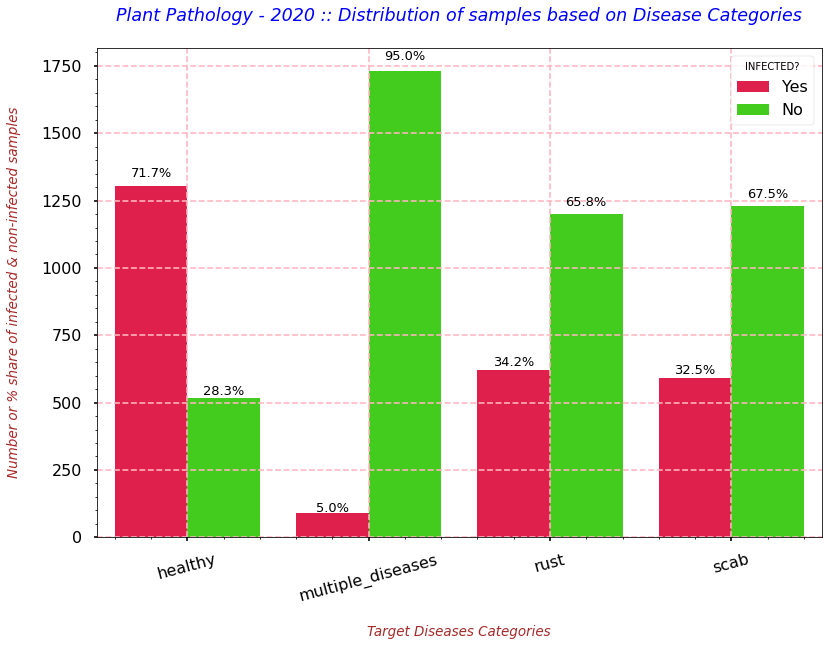

In [12]:
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(13,9))
    fig = sns.barplot(data=tgt_diseases_dist, x='category', y='counts', hue='infected', palette='prism_r')
    # Using the "patches" function we will get the location of the rectangle bars from the graph.
    ## Then by using those location(width & height) values we will add the annotations
    for p in fig.patches:
        width = p.get_width()
        height = p.get_height()
        x, y = p.get_xy()
        fig.annotate(f'{str(round((height*100)/tot_records,1))+"%"}', (x + width/2, y + height*1.025), ha='center', fontsize=13, rotation=0)
    # Providing the labels and title to the graph
    plt.xlabel("\nTarget Diseases Categories", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number or % share of infected & non-infected samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: Distribution of samples based on Disease Categories\n", fontdict=title_font_dict)
    plt.legend(title='INFECTED?')

**`OBSERVATION`**

From the above plot, we came to know that:
- 71.7% of TRAIN images are un-healthy. And, only 5% of TRAIN images have multiple diseases.
- Only 28% of entire samples are non-infected or totally healthy.
- And, in the dataset we have approximately same number of infected and non-infected samples for `Rust` and `Scab`.

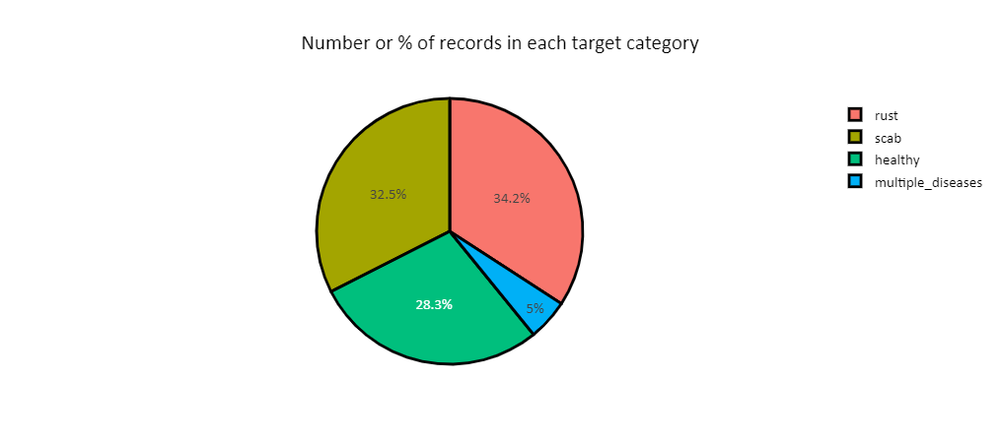

In [13]:
# Number and % of records that belongs to each target category
tgt_classes_share = go.Figure([go.Pie(labels=train_images_info_df.columns[1:], 
                                      values=train_images_info_df.iloc[:, 1:].sum().values)])

## Providing the figure labels properties
tgt_classes_share.update_layout(title_text="Number or % of records in each target category ", 
                                template="ggplot2", 
                                font={"color":"black", "family":"calibri", "size":15})

## Providing the figure properties
tgt_classes_share.data[0].marker.line.color = 'black'
tgt_classes_share.data[0].marker.line.width = 2.8
tgt_classes_share.show()

**`OBSERVATION`**

- The above pie chart showing us the % share of records in a much better way.
    - 34.2% of TRAIN images are of RUST. Quite similary, 32.5% of TRAIN images belongs to SCAB.

### **Q1b.**
#### **Does `multiple diseases` target label in the dataset means infected from both `RUST` & `SCAB` in `Plant Pathology Dataset 2020`❓**

In [14]:
train_image_only_mul_diseases_df = train_images_info_df[train_images_info_df['multiple_diseases'] == 1]
train_image_only_mul_diseases_df

,image_id,healthy,multiple_diseases,rust,scab
1,Train_1,0,1,0,0
6,Train_6,0,1,0,0
25,Train_25,0,1,0,0
36,Train_36,0,1,0,0
62,Train_62,0,1,0,0
...,...,...,...,...,...
1708,Train_1708,0,1,0,0
1779,Train_1779,0,1,0,0
1780,Train_1780,0,1,0,0
1784,Train_1784,0,1,0,0


In [15]:
only_mul_dis_healthy_stats = get_category_wise_counts(train_image_only_mul_diseases_df, 'healthy', 'healthy')
only_mul_dis_healthy_stats

,infected,counts,category
0,Yes,91,healthy


In [16]:
only_mul_dis_multiple_diseases_stats = get_category_wise_counts(train_image_only_mul_diseases_df, 'multiple_diseases', 'multiple_diseases')
only_mul_dis_multiple_diseases_stats

,infected,counts,category
0,Yes,91,multiple_diseases


In [17]:
only_mul_dis_rust_stats = get_category_wise_counts(train_image_only_mul_diseases_df, 'rust', 'rust')
only_mul_dis_rust_stats

,infected,counts,category
0,No,91,rust


In [18]:
only_mul_dis_scab_stats = get_category_wise_counts(train_image_only_mul_diseases_df, 'scab', 'scab')
only_mul_dis_scab_stats

,infected,counts,category
0,No,91,scab


In [19]:
only_mul_dis_tgt_diseases_dist = pd.concat([only_mul_dis_healthy_stats, only_mul_dis_multiple_diseases_stats, 
                                            only_mul_dis_rust_stats, only_mul_dis_scab_stats], axis=0).reset_index(drop=True)
only_mul_dis_tgt_diseases_dist

,infected,counts,category
0,Yes,91,healthy
1,Yes,91,multiple_diseases
2,No,91,rust
3,No,91,scab


In [20]:
tmp_df_healthy = {'infected': 'No', 'counts': 0, 'category': 'healthy'}
tmp_df_mul_dis = {'infected': 'No', 'counts': 0, 'category': 'multiple_diseases'}
tmp_df_rust = {'infected': 'Yes', 'counts': 0, 'category': 'rust'}
tmp_df_scab = {'infected': 'Yes', 'counts': 0, 'category': 'scab'}

only_mul_dis_tgt_diseases_dist = only_mul_dis_tgt_diseases_dist.append([tmp_df_healthy, tmp_df_mul_dis, tmp_df_rust, tmp_df_scab],
                                                                       ignore_index = True)

In [21]:
only_mul_dis_tgt_diseases_dist

,infected,counts,category
0,Yes,91,healthy
1,Yes,91,multiple_diseases
2,No,91,rust
3,No,91,scab
4,No,0,healthy
5,No,0,multiple_diseases
6,Yes,0,rust
7,Yes,0,scab


In [22]:
only_mul_dis_tot_records = np.sum(only_mul_dis_tgt_diseases_dist[only_mul_dis_tgt_diseases_dist['category'] == 'healthy']['counts'].values)
only_mul_dis_tot_records

91

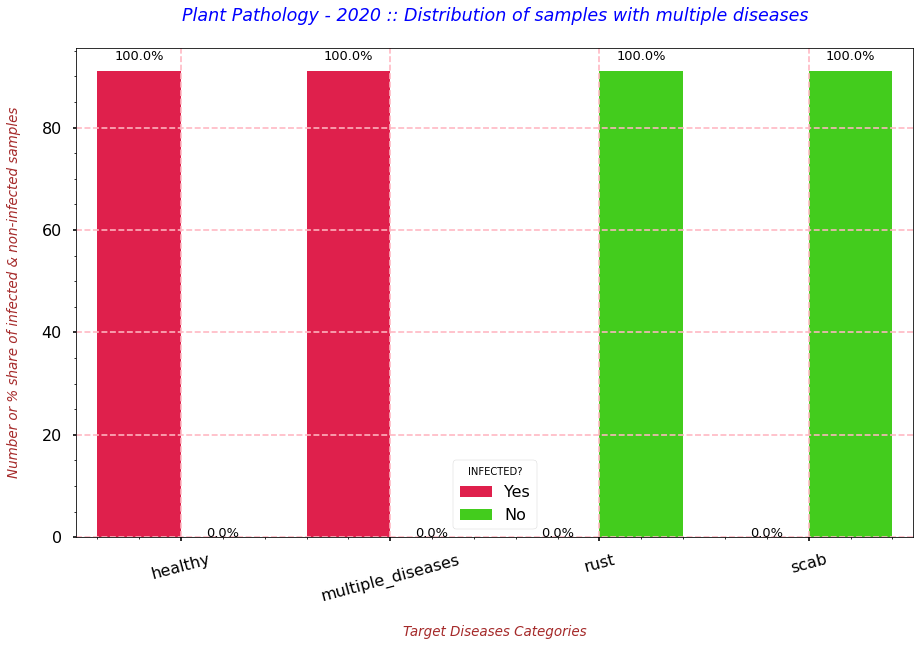

In [23]:
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(15,9))
    fig = sns.barplot(data=only_mul_dis_tgt_diseases_dist, x='category', y='counts', hue='infected', palette='prism_r')
    # Using the "patches" function we will get the location of the rectangle bars from the graph.
    ## Then by using those location(width & height) values we will add the annotations
    for p in fig.patches:
        width = p.get_width()
        height = p.get_height()
        x, y = p.get_xy()
        fig.annotate(f'{str(round((height*100)/only_mul_dis_tot_records,1))+"%"}', (x + width/2, y + height*1.025), ha='center', fontsize=13, rotation=0)
    # Providing the labels and title to the graph
    plt.xlabel("\nTarget Diseases Categories", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number or % share of infected & non-infected samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: Distribution of samples with multiple diseases\n", fontdict=title_font_dict)
    plt.legend(title='INFECTED?')

**`OBSERVATION`**

- The above graph confirms us that the samples that are labelled as `Multiple Diseases` are also marked as `un-healthy`.
- And, the multiple diseases samples have no intersection with `Rust` and `Scab` samples.

### **Q1c.**
#### **Does `un-healthy` target label in the dataset means infected from either one or multiples diseases❓**

In [24]:
train_image_only_unhealthy_df = train_images_info_df[train_images_info_df['healthy'] == 0]
train_image_only_unhealthy_df

,image_id,healthy,multiple_diseases,rust,scab
0,Train_0,0,0,0,1
1,Train_1,0,1,0,0
3,Train_3,0,0,1,0
6,Train_6,0,1,0,0
7,Train_7,0,0,0,1
...,...,...,...,...,...
1813,Train_1813,0,0,1,0
1815,Train_1815,0,1,0,0
1816,Train_1816,0,0,0,1
1819,Train_1819,0,0,1,0


In [25]:
only_unhealthy_stats = get_category_wise_counts(train_image_only_unhealthy_df, 'healthy', 'healthy')
only_unhealthy_stats

,infected,counts,category
0,Yes,1305,healthy


In [26]:
only_unhealthy_multiple_diseases_stats = get_category_wise_counts(train_image_only_unhealthy_df, 'multiple_diseases', 'multiple_diseases')
only_unhealthy_multiple_diseases_stats

,infected,counts,category
0,No,1214,multiple_diseases
1,Yes,91,multiple_diseases


In [27]:
only_unhealthy_rust_stats = get_category_wise_counts(train_image_only_unhealthy_df, 'rust', 'rust')
only_unhealthy_rust_stats

,infected,counts,category
0,No,683,rust
1,Yes,622,rust


In [28]:
only_unhealthy_scab_stats = get_category_wise_counts(train_image_only_unhealthy_df, 'scab', 'scab')
only_unhealthy_scab_stats

,infected,counts,category
0,No,713,scab
1,Yes,592,scab


In [29]:
only_unhealthy_tgt_diseases_dist = pd.concat([only_unhealthy_stats, only_unhealthy_multiple_diseases_stats, 
                                              only_unhealthy_rust_stats, only_unhealthy_scab_stats], axis=0).reset_index(drop=True)
only_unhealthy_tgt_diseases_dist

,infected,counts,category
0,Yes,1305,healthy
1,No,1214,multiple_diseases
2,Yes,91,multiple_diseases
3,No,683,rust
4,Yes,622,rust
5,No,713,scab
6,Yes,592,scab


In [30]:
tmp_df_unhealthy = {'infected': 'No', 'counts': 0, 'category': 'healthy'}

only_unhealthy_tgt_diseases_dist = only_unhealthy_tgt_diseases_dist.append(tmp_df_unhealthy, ignore_index = True)
only_unhealthy_tgt_diseases_dist

,infected,counts,category
0,Yes,1305,healthy
1,No,1214,multiple_diseases
2,Yes,91,multiple_diseases
3,No,683,rust
4,Yes,622,rust
5,No,713,scab
6,Yes,592,scab
7,No,0,healthy


In [31]:
only_unhealthy_tot_records = np.sum(only_unhealthy_tgt_diseases_dist[only_unhealthy_tgt_diseases_dist['category'] == 'healthy']['counts'].values)
only_unhealthy_tot_records

1305

,image_id,healthy,multiple_diseases,rust,scab



### Therefore, number of un-healthy samples are suffering from either one or both RUST & SCAB at the same time are --> 0 ### 




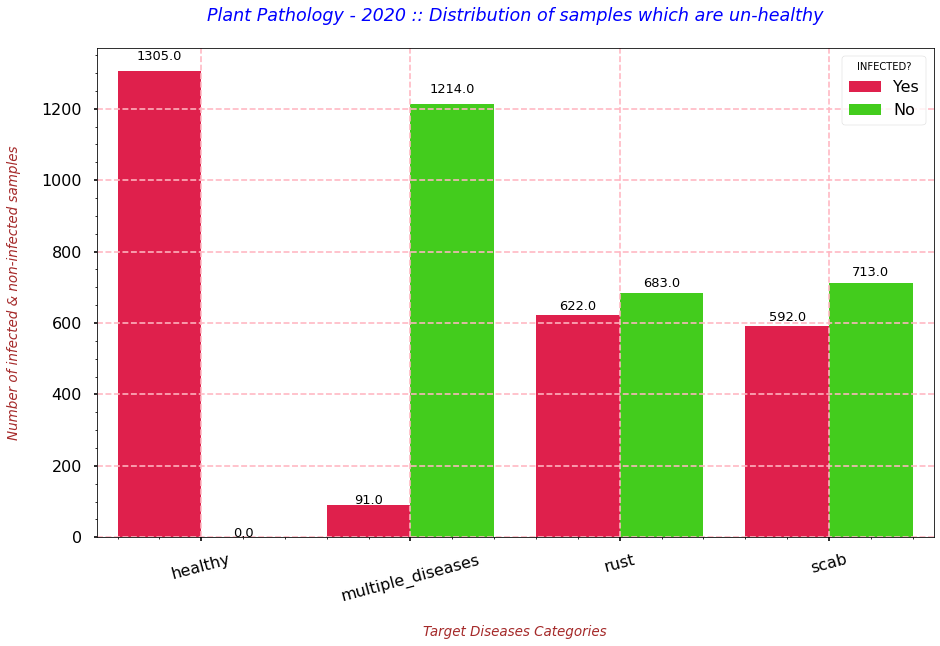

In [32]:
# This will print the sample which are un-healthy and suffering from RUST and SCAB at the same time
display(train_image_only_unhealthy_df[(train_image_only_unhealthy_df['rust'] == 1) & (train_image_only_unhealthy_df['scab'] == 1)])

num_rec = train_image_only_unhealthy_df[(train_image_only_unhealthy_df['rust'] == 1) & (train_image_only_unhealthy_df['scab'] == 1)].shape[0]
print("\n### Therefore, number of un-healthy samples are suffering from either one or both RUST & SCAB at the same time are --> {} ### \n\n".format(num_rec))

# Displaying the same via graph
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(15,9))
    fig = sns.barplot(data=only_unhealthy_tgt_diseases_dist, x='category', y='counts', hue='infected', palette='prism_r')
    # Using the "patches" function we will get the location of the rectangle bars from the graph.
    ## Then by using those location(width & height) values we will add the annotations
    for p in fig.patches:
        width = p.get_width()
        height = p.get_height()
        x, y = p.get_xy()
        fig.annotate(f'{str(height)}', (x + width/2, y + height*1.025), ha='center', fontsize=13, rotation=0)
    # Providing the labels and title to the graph
    plt.xlabel("\nTarget Diseases Categories", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of infected & non-infected samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: Distribution of samples which are un-healthy\n", fontdict=title_font_dict)
    plt.legend(title='INFECTED?')

**`OBSERVATION`**

- The above table and graph confirms us that the samples that are `un-healthy` are distributed among the other 3 classes.
    - And, there are no common records in this case.

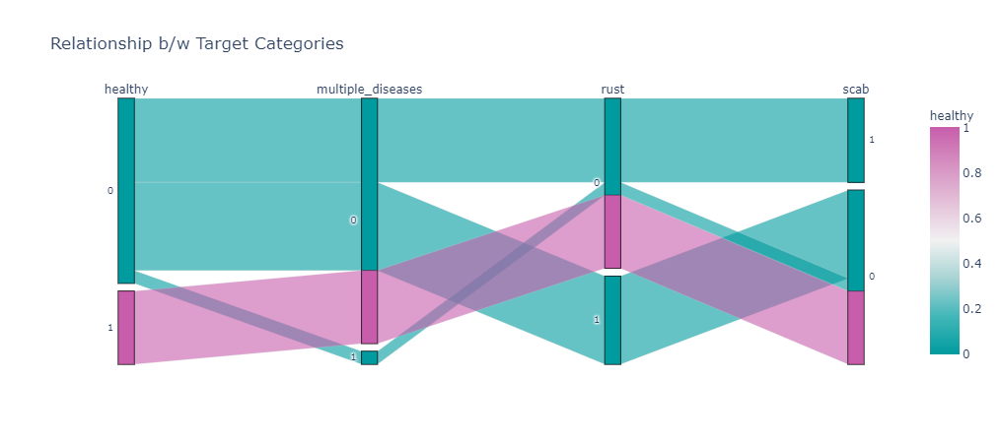

In [33]:
# Displaying the relationship b/w the TARGET Categories
tgt_classes_relation = px.parallel_categories(train_images_info_df[["healthy", "multiple_diseases", "rust", "scab"]], 
                             color="healthy", 
                             color_continuous_scale="tropic",
                             title="Relationship b/w Target Categories")
tgt_classes_relation

**`OBSERVATION`**

- The above plot shows us the relationship between all the 4 target categories. 
    - For a healthy leaf (healthy == 1) we don't have any scab, rust, or multiple diseases. 
    - Every unhealthy leaf has one of either scab, rust, or multiple diseases.

#### ⭐ **`Displaying some images of each target disease category`**

### **Q2a.**
#### **Let's visualize some of the images of `HEALTHY` class❓**

In [34]:
train_images_info_df

,image_id,healthy,multiple_diseases,rust,scab
0,Train_0,0,0,0,1
1,Train_1,0,1,0,0
2,Train_2,1,0,0,0
3,Train_3,0,0,1,0
4,Train_4,1,0,0,0
...,...,...,...,...,...
1816,Train_1816,0,0,0,1
1817,Train_1817,1,0,0,0
1818,Train_1818,1,0,0,0
1819,Train_1819,0,0,1,0


In [35]:
healthy_sampled_images = train_images_info_df[train_images_info_df['healthy'] == 1][['image_id']].sample(n=24, random_state=91, replace=False)
healthy_sampled_images['image_id'] = healthy_sampled_images['image_id'].apply(lambda img_name: img_name+'.jpg')
healthy_sampled_images = list(healthy_sampled_images['image_id'].values)

healthy_sampled_images_tbd = []
for img in healthy_sampled_images:
    healthy_sampled_images_tbd.append(os.path.join(os.path.join(os.path.join(os.path.join(os.getcwd(), "Dataset"), "Pathology_2020"), "Images"), img))

healthy_sampled_images_tbd[0:5]

['E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_1724.jpg',
 'E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_1381.jpg',
 'E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_478.jpg',
 'E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_1282.jpg',
 'E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_630.jpg']

In [36]:
def visualize_images(images_names_list, img_class, graph_rows=4, graph_cols=6):
    """
    Description : This function is created for visualizing some of the IMAGES of each TARGET Class Category.
    
    Input parameters : It accepts the below 4 inputs:
        - images_names_list : `list`
            Python list containing the names of the images along with the specific location.
        - img_class : `str`
            This represents the target class label.
        - graph_rows : int
            This represents the number of rows in the subplot.
        - graph_cols : int
            This represents the number of columns in the subplot.
    
    Return : None
    """
    # Starting counter
    m = 0;
    
    # Rows of the graph
    rows = graph_rows;
    
    # Columns of the graph
    cols = graph_cols;

    # Plotting the images in the sub-plot
    with plt.style.context('seaborn'):
        fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(16,10), sharex=True, sharey=True)
        # Plotting the images by traversing using loops
        for i in range(0,rows):
            for j in range(0,cols):
                # Reading the image
                img = cv2.imread(images_names_list[m+j])
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                # Displaying the image and setting its title
                ax[i,j].imshow(img, aspect='auto')
                ax[i,j].set_title(images_names_list[m+j].split("\\")[-1])
                ax[i,j].axis('off')
            # Re-setting the initial counter
            m += cols;
        fig.suptitle("Plant Pathology - 2020 :: {} Images".format(img_class.upper()), fontdict=title_font_dict)
        plt.plot();

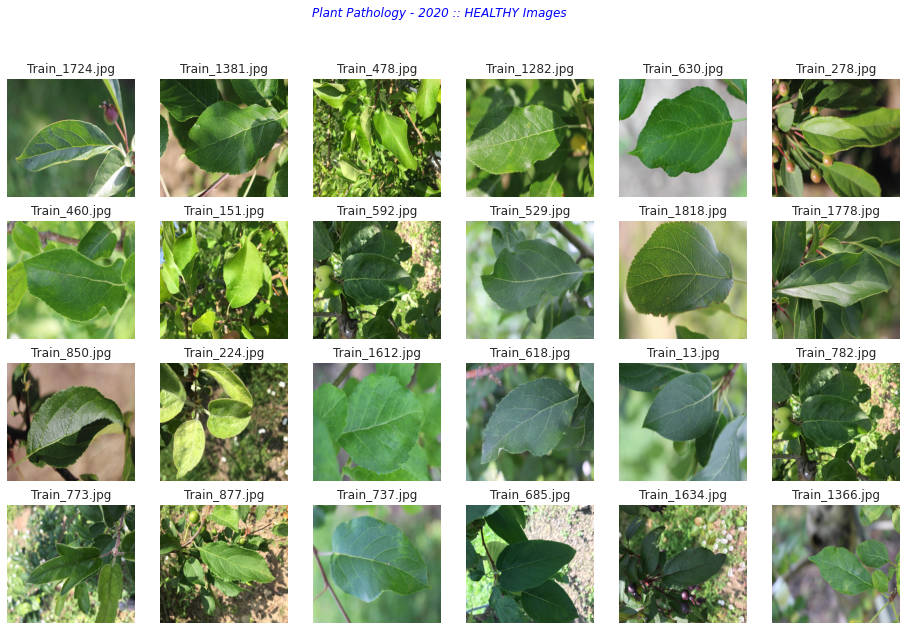

In [37]:
visualize_images(healthy_sampled_images_tbd, img_class='healthy');

**`OBSERVATION`**

From the above plot, we came to know that:
- Many images contains the background area or we can say that the main leaf is not in focus.
    - Thus, we need to rescale or resize the images.
- Also, the light intensity is different in the images. 
    - As images have taken in bright sunlight and in shadow.
- In some of the images, we can see a group of leaves in the main focus so either entire group is labelled as `HEALTHY` or we may need to bring the main leaf into focus.

In [38]:
def plot_big_img(img_name, img_category, start_coord=(450,1500), end_coord=(750,1500), org_axis="on", flag=0):
    """
    Description : This function is created for visualizing some of the IMAGES in bigger size.
    
    Input parameters : It accepts the below 4 inputs:
        - img_name : `str`
            Image name that you want to display.
        - img_category : `str`
            Disease category to which the image belongs.
        - start_coord : `tuple`
            Starting X,Y co-ordinates of the bounding/focus box
        - end_coord : `tuple`
            Ending X,Y co-ordinates of the bounding/focus box
        - org_axis : `str`
            By default it is 'on', but it can also take 'off'. Means whether we want to show the axis lines in the original image.
        - flag : int
            By default it is 0, means GRAYSCALE.
    
    Return : None
    """
    # Reading the image name and its location
    loc = os.path.join(os.path.join(os.path.join(os.getcwd(), "Dataset"), "Pathology_2020"), "Images")
    img_loc = os.path.join(loc,img_name)
      
    # Reading the original image
    ## -1 represents IMREAD_UNCHANGED
    org_img_read = cv2.imread(img_loc, -1)
    org_img_read = cv2.cvtColor(org_img_read, cv2.COLOR_BGR2RGB)
    
    # Reading the original image for adding the potential focus area
    ## -1 represents IMREAD_UNCHANGED
    img_read_tbs = cv2.imread(img_loc, -1)
    img_read_tbs = cv2.cvtColor(img_read_tbs, cv2.COLOR_BGR2RGB)
    bb_img = cv2.rectangle(img_read_tbs, start_coord, end_coord, color=(255,0,0), thickness=13)
    
    # Reading the original image for adding the potential focus area on grayscale image
    ## 0 represents GRAYSCALE
    img_read_gray = cv2.imread(img_loc, flag)
    bb_gray_img = cv2.rectangle(img_read_gray, start_coord, end_coord, color=(255,0,0), thickness=13)
    
    # Plotting the images in the sub-plot
    with plt.style.context('seaborn'):
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(17,7), sharex=False, sharey=False)
        # Plotting the original image
        ax[0].imshow(org_img_read, aspect='auto')
        ax[0].axis(org_axis)
        ax[0].set_title("Original Image : RGB")
        
        # Plotting the segmented image
        ax[1].imshow(bb_img, aspect='auto')
        ax[1].axis("off")
        ax[1].set_title("Focus Box : RGB")
        
        # Plotting the segmented image
        ax[2].imshow(bb_gray_img, aspect='auto')
        ax[2].axis("off")
        ax[2].set_title("Focus Box : Grayscale")
        fig.suptitle("###   {}  <------>  {}   ###\n".format(img_category.upper(), img_name), fontdict=title_font_dict)

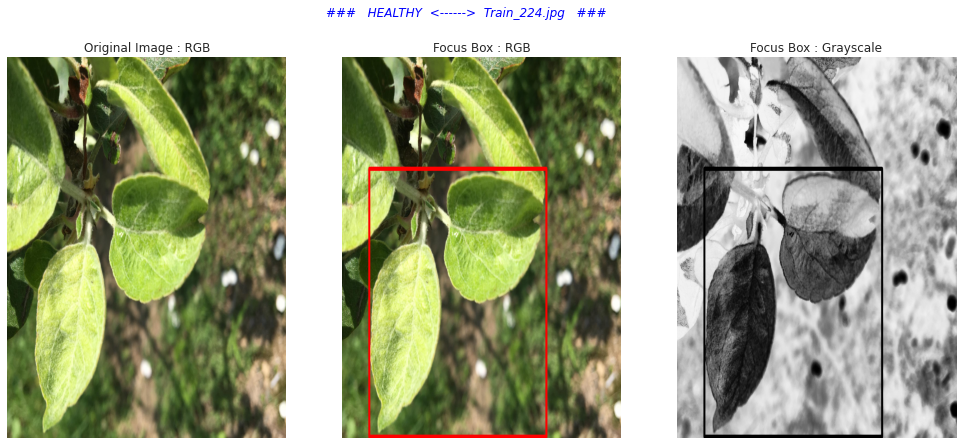

In [39]:
plot_big_img("Train_224.jpg", "healthy", start_coord=(200,400), end_coord=(1500,1360), org_axis='off');

**`OBSERVATION`**

From the above images, we can say that:
- The highlighted area within the red box can be the potential portion of the image for the CNN model to make the correct decision.

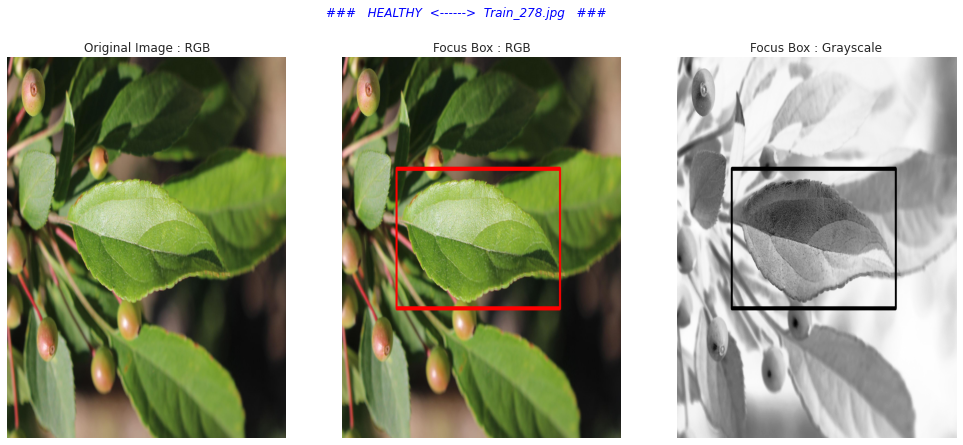

In [40]:
plot_big_img("Train_278.jpg", "healthy", start_coord=(400, 400), end_coord=(1600,900), org_axis="off");

**`OBSERVATION`**

From the above images, we can say that:
- The highlighted area within the red box can be the potential portion of the image for the CNN model to make the correct decision.
- The images have varying light intensities and overlapping of leaves, thus we want the model to capture the feature of focussed leaf.

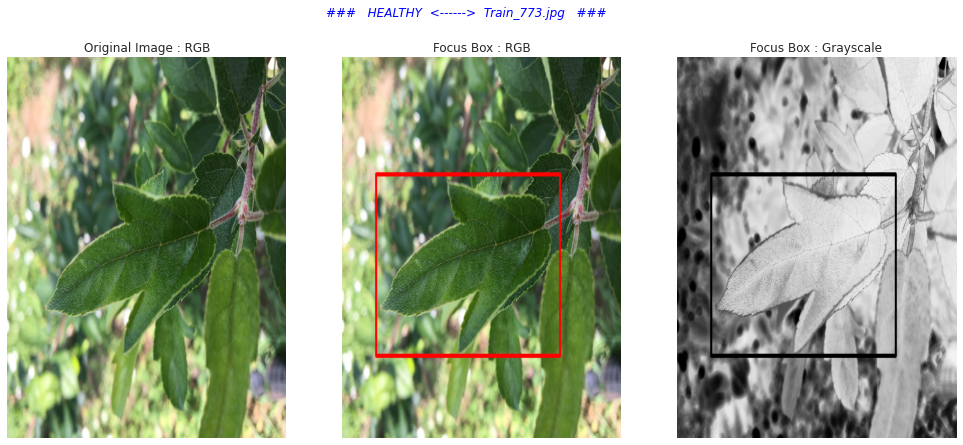

In [41]:
plot_big_img("Train_773.jpg", "healthy", start_coord=(250, 1070), end_coord=(1600, 420), org_axis="off");

**`OBSERVATION`**

From the above images, we can say that:
- The highlighted area within the red box can be the potential portion of the image for the CNN model to make the correct decision.
- The images have varying light intensities and overlapping of leaves, thus we want the model to capture the feature of focussed leaf.

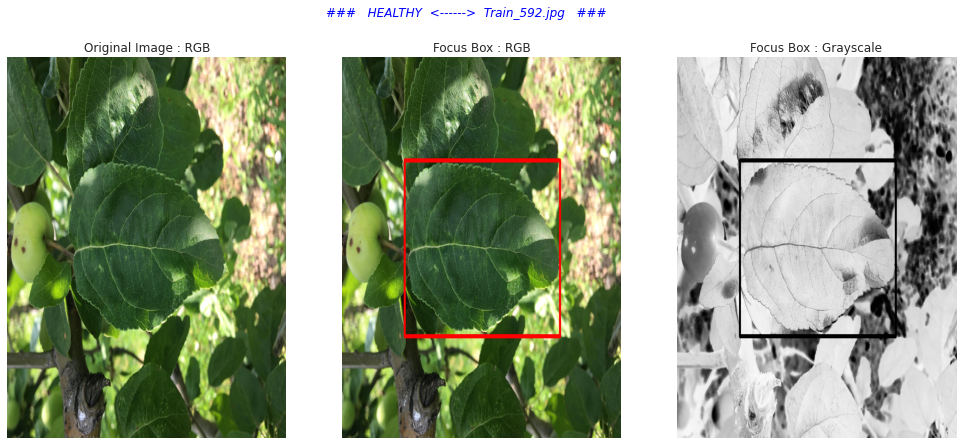

In [42]:
plot_big_img("Train_592.jpg", "healthy", start_coord=(460, 1000), end_coord=(1600, 370), org_axis="off");

**`OBSERVATION`**

From the above images, we can say that:
- The highlighted area within the red box can be the potential portion of the image for the CNN model to make the correct decision.
- The images have varying light intensities and overlapping of leaves, thus we want the model to capture the feature of focussed leaf.
    - For example, this image has been taken in shadow.

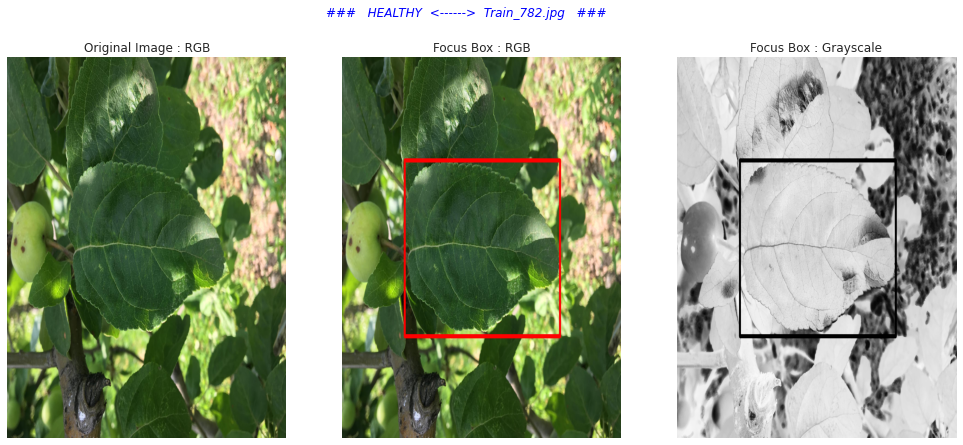

In [43]:
plot_big_img("Train_782.jpg", "healthy", start_coord=(460, 1000), end_coord=(1600, 370), org_axis="off", flag=0);

**`OBSERVATION`**

- While visualizing the images I found out that the above 2 images are duplicates.
    - `Train_592.jpg` & `Train_782.jpg` are exactly the same. Thus, we need to check other images as well for duplicacy.

### **Q2b.**
#### **Let's visualize some of the images of `MULTIPLE DISEASES` class❓**

In [44]:
train_images_info_df

,image_id,healthy,multiple_diseases,rust,scab
0,Train_0,0,0,0,1
1,Train_1,0,1,0,0
2,Train_2,1,0,0,0
3,Train_3,0,0,1,0
4,Train_4,1,0,0,0
...,...,...,...,...,...
1816,Train_1816,0,0,0,1
1817,Train_1817,1,0,0,0
1818,Train_1818,1,0,0,0
1819,Train_1819,0,0,1,0


In [45]:
mul_dis_sampled_images = train_images_info_df[train_images_info_df['multiple_diseases'] == 1][['image_id']].sample(n=24, 
                                                                                                                   random_state=91, 
                                                                                                                   replace=False)
mul_dis_sampled_images['image_id'] = mul_dis_sampled_images['image_id'].apply(lambda img_name: img_name+'.jpg')
mul_dis_sampled_images = list(mul_dis_sampled_images['image_id'].values)

mul_dis_sampled_images_tbd = []
for img in mul_dis_sampled_images:
    mul_dis_sampled_images_tbd.append(os.path.join(os.path.join(os.path.join(os.path.join(os.getcwd(), "Dataset"), "Pathology_2020"), "Images"), img))

mul_dis_sampled_images_tbd[0:5]

['E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_1161.jpg',
 'E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_428.jpg',
 'E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_1236.jpg',
 'E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_1035.jpg',
 'E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_535.jpg']

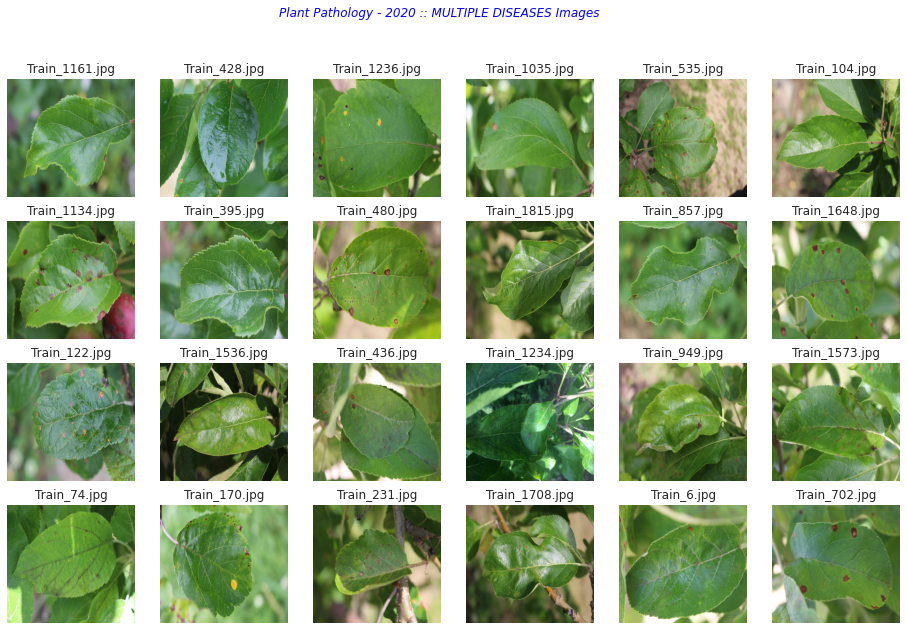

In [46]:
visualize_images(mul_dis_sampled_images_tbd, img_class='multiple diseases');

**`OBSERVATION`**

From the above plot, we came to know that:
- The infected images contains some small-small patches.
    - We need to check the change in RGB intensity of these patches in the images.
- Many images contains the background area or we can say that the main leaf is not in focus.
    - Thus, we need to rescale or resize the images.
- Also, the light intensity is different in the images. 
    - As images have taken in bright sunlight and in shadow.
- In some of the images, we can see a group of leaves in the main focus area so either entire group is labelled as `MULTIPLE DISEASES` or we may need to bring the main leaf into focus.

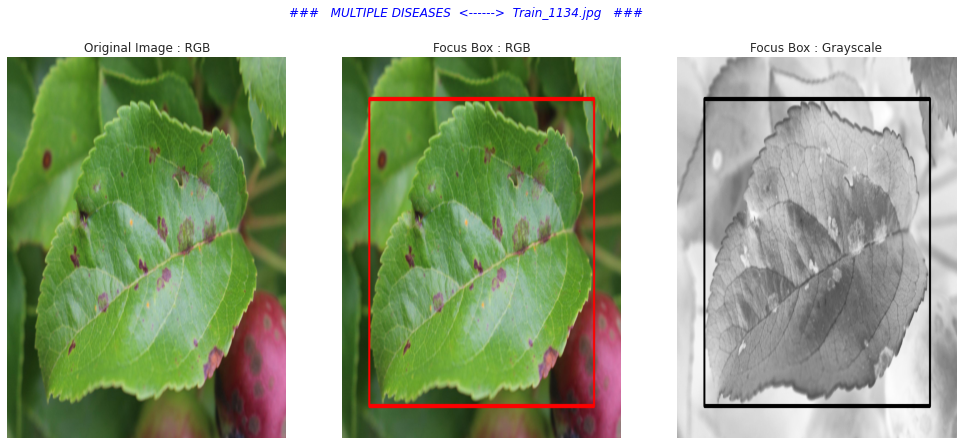

In [47]:
plot_big_img("Train_1134.jpg", "multiple diseases", start_coord=(200,1250), end_coord=(1850,150), org_axis='off', flag=0);

**`OBSERVATION`**

From the above images, we can say that:
- The highlighted area within the red box can be the potential portion of the image for the CNN model to make the correct decision.
- In this image, the leaf has many small-small blackish spots which is the main sign of the disease.
    - Thus, we need to check the change in color intensities of spots and other portion.

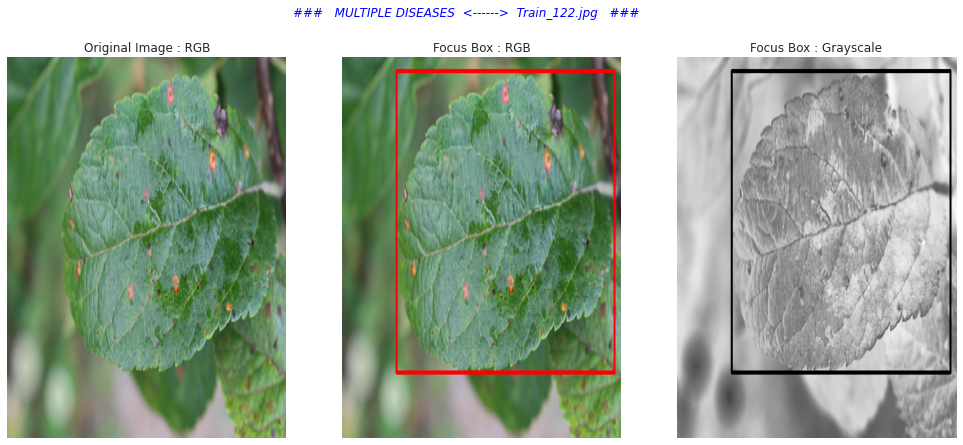

In [48]:
plot_big_img("Train_122.jpg", "multiple diseases", start_coord=(400,1130), end_coord=(2000,50), org_axis='off');

**`OBSERVATION`**

From the above images, we can say that:
- The highlighted area within the red box can be the potential portion of the image for the CNN model to make the correct decision.
- In this image, the leaf has many small-small yellowish & redish spots which is the main sign of the disease.
    - Thus, we need to check the change in color intensities of spots and other portion.

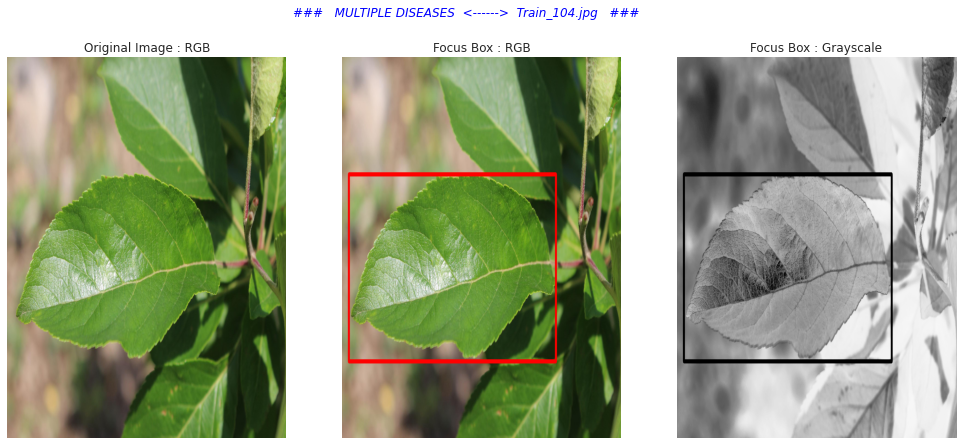

In [49]:
plot_big_img("Train_104.jpg", "multiple diseases", start_coord=(50,1090), end_coord=(1570,420), org_axis='off');

**`OBSERVATION`**

This image is quite interesting:
- The highlighted area contains varying light intensity small-small spots which will be useful for correct identification.
- In the grayscale image, we can actually see these small spots. Thus, we need to apply some pre-processing tricks to enhance these features.

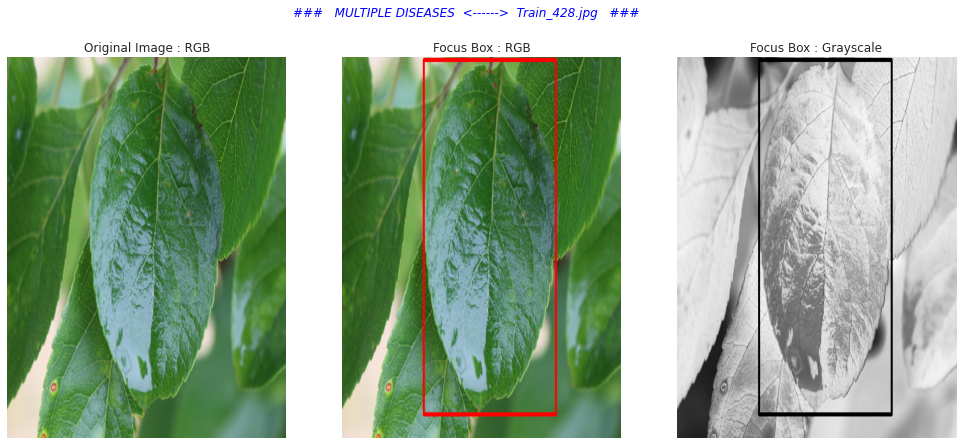

In [50]:
plot_big_img("Train_428.jpg", "multiple diseases", start_coord=(600,1280), end_coord=(1570,10), org_axis='off');

**`OBSERVATION`**

In the above image, we found that:
- The highlighted area contains varying light intensity small-small spots which will be useful for correct identification.
- In the grayscale image, we can actually see these small spots. Thus, we need to apply some pre-processing tricks to enhance these features.

### **Q2c.**
#### **Let's visualize some of the images of `RUST` class❓**

In [51]:
train_images_info_df

,image_id,healthy,multiple_diseases,rust,scab
0,Train_0,0,0,0,1
1,Train_1,0,1,0,0
2,Train_2,1,0,0,0
3,Train_3,0,0,1,0
4,Train_4,1,0,0,0
...,...,...,...,...,...
1816,Train_1816,0,0,0,1
1817,Train_1817,1,0,0,0
1818,Train_1818,1,0,0,0
1819,Train_1819,0,0,1,0


In [52]:
rust_sampled_images = train_images_info_df[train_images_info_df['rust'] == 1][['image_id']].sample(n=24, random_state=91, replace=False)
rust_sampled_images['image_id'] = rust_sampled_images['image_id'].apply(lambda img_name: img_name+'.jpg')
rust_sampled_images = list(rust_sampled_images['image_id'].values)

rust_sampled_images_tbd = []
for img in rust_sampled_images:
    rust_sampled_images_tbd.append(os.path.join(os.path.join(os.path.join(os.path.join(os.getcwd(), "Dataset"), "Pathology_2020"), "Images"), img))

rust_sampled_images_tbd[0:5]

['E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_1540.jpg',
 'E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_712.jpg',
 'E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_683.jpg',
 'E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_1373.jpg',
 'E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_39.jpg']

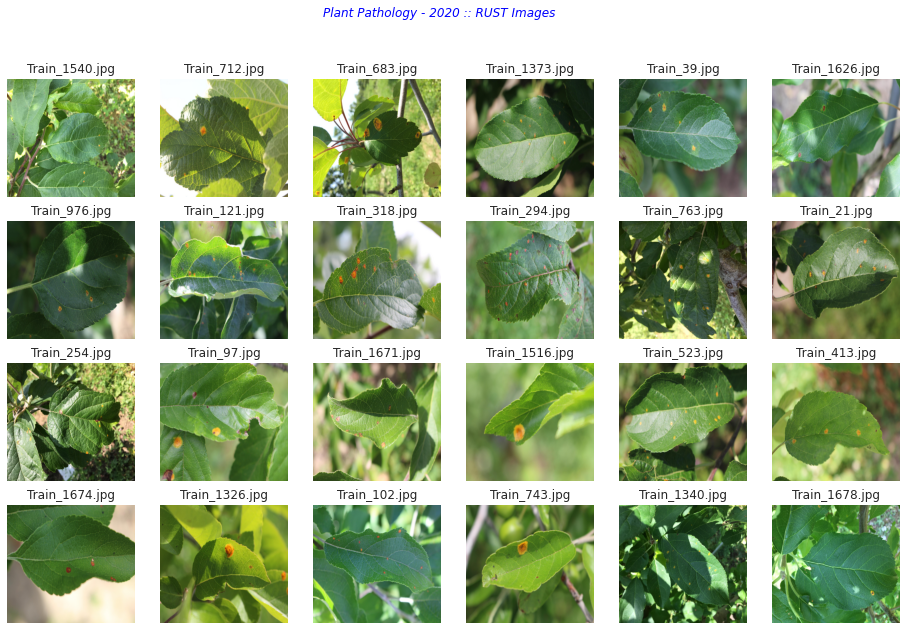

In [53]:
visualize_images(rust_sampled_images_tbd, img_class='rust');

**`OBSERVATION`**

From the above plot, we came to know that:
- The infected images contains some small-small patches.
    - We need to check the change in RGB intensity of these patches in the images.
- Many images contains the background area or we can say that the main leaf is not in focus.
    - Thus, we need to rescale or resize the images.
- Also, the light intensity is different in the images. 
    - As images have taken in bright sunlight and in shadow.
- In some of the images, we can see a group of leaves in the main focus so either entire group is labelled as `RUST` or we may need to bring the main leaf into focus.

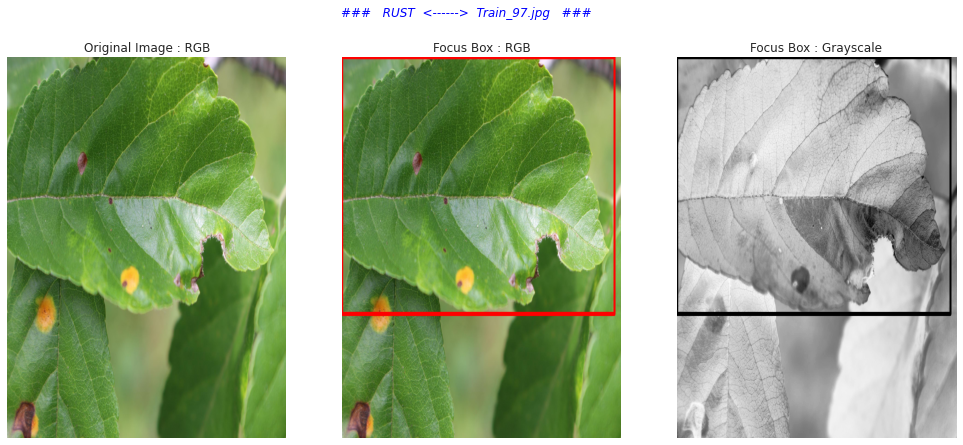

In [54]:
plot_big_img("Train_97.jpg", "rust", start_coord=(1,920), end_coord=(2000,0), org_axis='off');

**`OBSERVATION`**

In the above image, we found that:
- The highlighted area contains varying light intensity small-small yellowish spots which will be useful for correct identification.
- In the grayscale image, we can actually see these small spots along with varying light intensity.

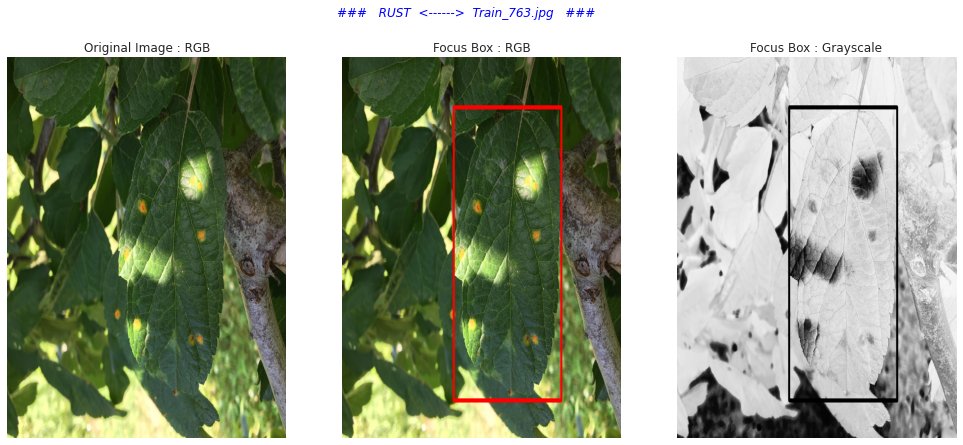

In [55]:
plot_big_img("Train_763.jpg", "rust", start_coord=(820,1230), end_coord=(1610,180), org_axis='off');

**`OBSERVATION`**

In the above image, we found that:
- The highlighted area contains varying light intensity small-small yellowish spots which will be useful for correct identification.
- In the grayscale image, we can actually see these small spots along with the varying light intensity.

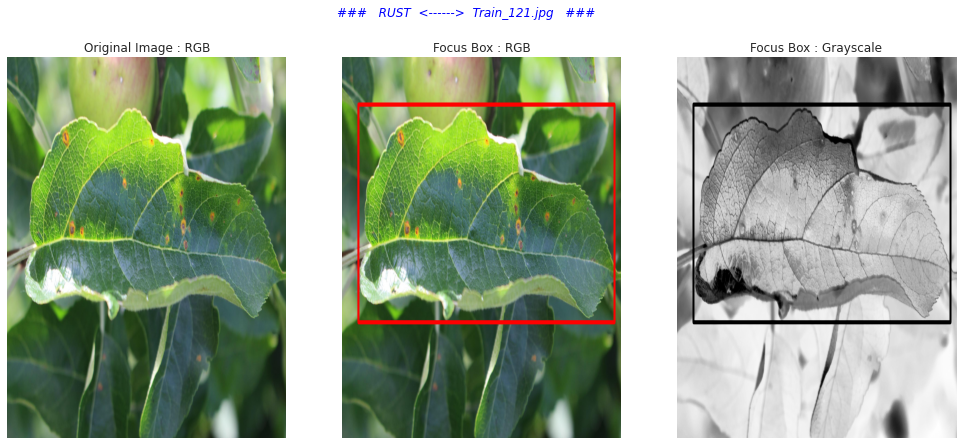

In [56]:
plot_big_img("Train_121.jpg", "rust", start_coord=(120,950), end_coord=(2000,170), org_axis='off');

**`OBSERVATION`**

In the above image, we found that:
- The highlighted area contains varying light intensity small-small yellowish spots which will be useful for correct identification.
- In the grayscale image, we can actually see these small spots along with the varying light intensity.

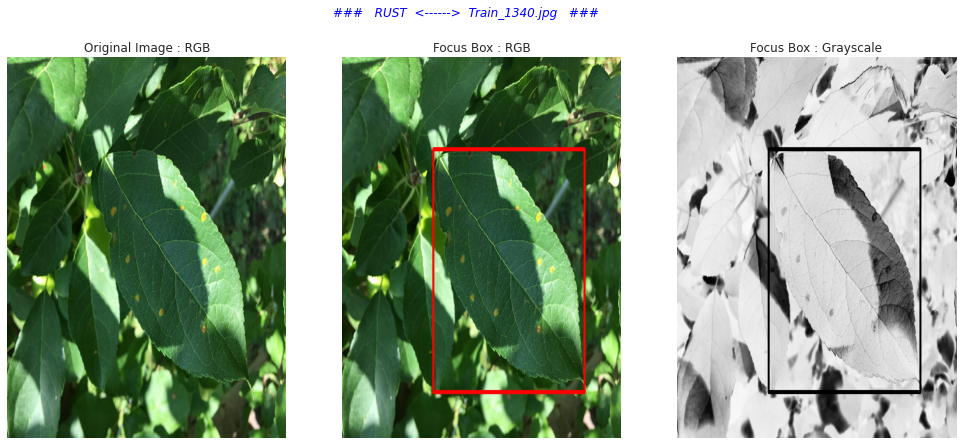

In [57]:
plot_big_img("Train_1340.jpg", "rust", start_coord=(670,1200), end_coord=(1780,330), org_axis='off');

**`OBSERVATION`**

In the above image, we found that:
- The highlighted area contains varying light intensity small-small yellowish spots which will be useful for correct identification.
- In the grayscale image, we can actually see these small spots along with the varying light intensity.
- Another point to note here is that the few of the images in the background (not in focus) appears to be non-infected. So, re-size and cropping needs to be done.

### **Q2d.**
#### **Let's visualize some of the images of `SCAB` class❓**

In [58]:
train_images_info_df

,image_id,healthy,multiple_diseases,rust,scab
0,Train_0,0,0,0,1
1,Train_1,0,1,0,0
2,Train_2,1,0,0,0
3,Train_3,0,0,1,0
4,Train_4,1,0,0,0
...,...,...,...,...,...
1816,Train_1816,0,0,0,1
1817,Train_1817,1,0,0,0
1818,Train_1818,1,0,0,0
1819,Train_1819,0,0,1,0


In [59]:
scab_sampled_images = train_images_info_df[train_images_info_df['scab'] == 1][['image_id']].sample(n=24, random_state=63, replace=False)
scab_sampled_images['image_id'] = scab_sampled_images['image_id'].apply(lambda img_name: img_name+'.jpg')
scab_sampled_images = list(scab_sampled_images['image_id'].values)

scab_sampled_images_tbd = []
for img in scab_sampled_images:
    scab_sampled_images_tbd.append(os.path.join(os.path.join(os.path.join(os.path.join(os.getcwd(), "Dataset"), "Pathology_2020"), "Images"), img))

scab_sampled_images_tbd[0:5]

['E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_112.jpg',
 'E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_570.jpg',
 'E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_917.jpg',
 'E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_230.jpg',
 'E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images\\Train_1382.jpg']

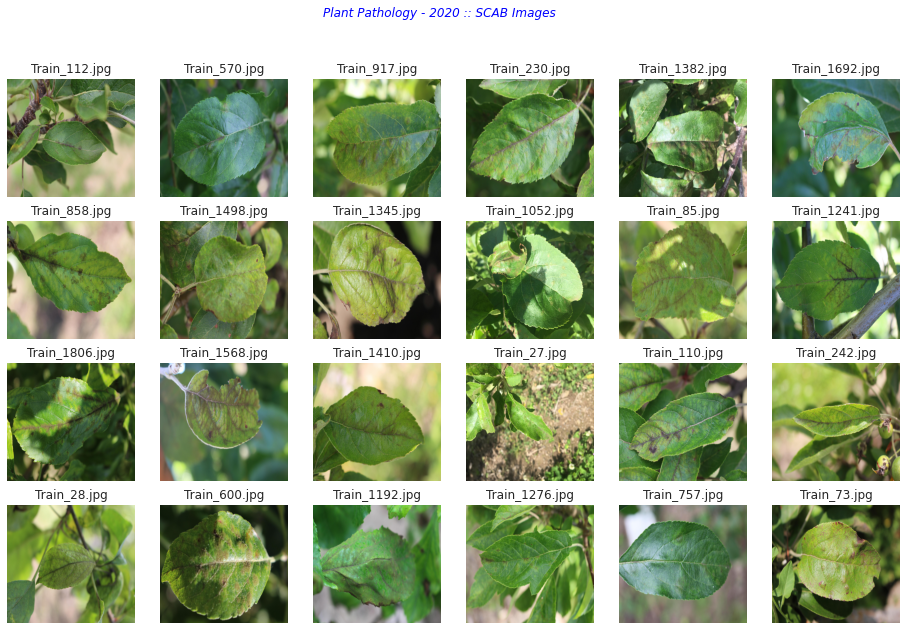

In [60]:
visualize_images(scab_sampled_images_tbd, img_class='scab');

**`OBSERVATION`**

From the above plot, we came to know that:
- The infected images contains some small-small patches. Also, we can see the big black/blueish patches.
    - We need to check the change in RGB intensity of these patches in the images.
- Many images contains the background area or we can say that the main leaf is not in focus.
    - Thus, we need to rescale or resize the images.
- Also, the light intensity is different in the images. 
    - As images have taken in bright sunlight and in shadow.
- In some of the images, we can see a group of leaves in the main focus area so either entire group is labelled as `SCAB` or we may need to bring the main leaf into focus.

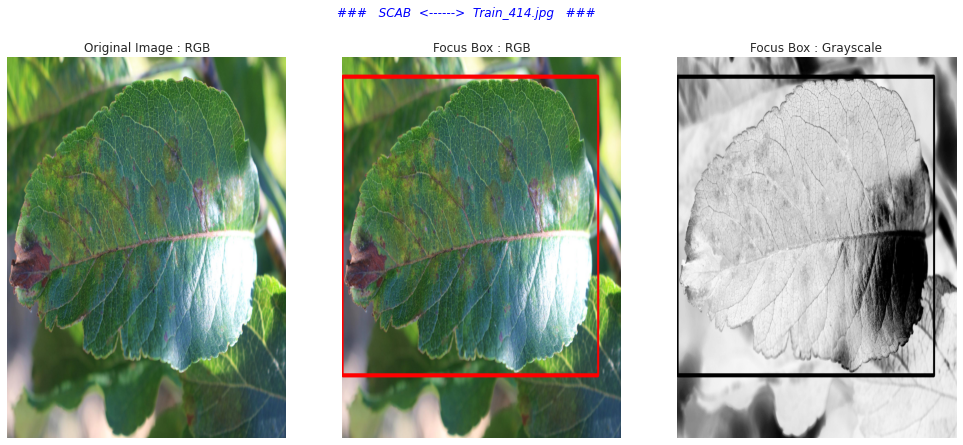

In [61]:
plot_big_img("Train_414.jpg", "scab", start_coord=(4,1140), end_coord=(1880,70), org_axis='off');

**`OBSERVATION`**

In the above image, we found that:
- The highlighted area contains varying light intensity and small-small blackish spots which will be useful for correct identification.
- In the grayscale image, we can actually see these small spots along with the varying light intensity.

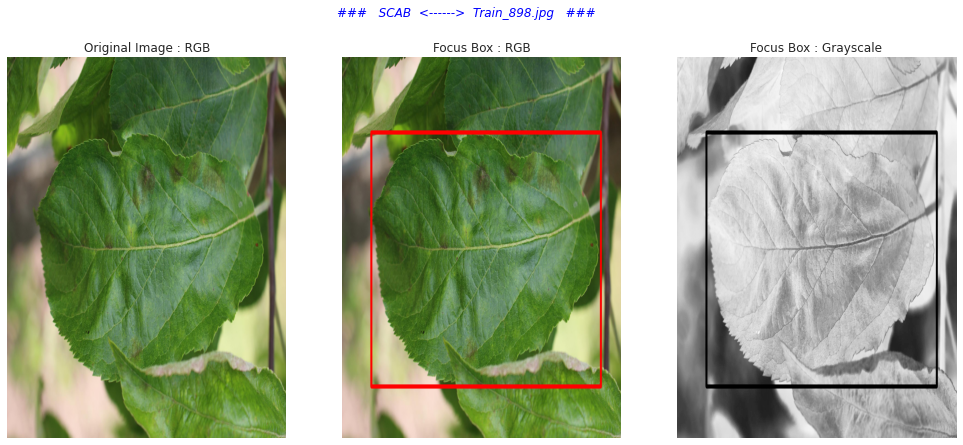

In [62]:
plot_big_img("Train_898.jpg", "scab", start_coord=(215,1180), end_coord=(1900,270), org_axis='off');

**`OBSERVATION`**

In the above image, we found that:
- The highlighted area contains varying light intensity and small-small very few blackish spots which will be useful for correct identification.
- In the grayscale image, we can actually see these small spots become very light and almost unrecognizable.

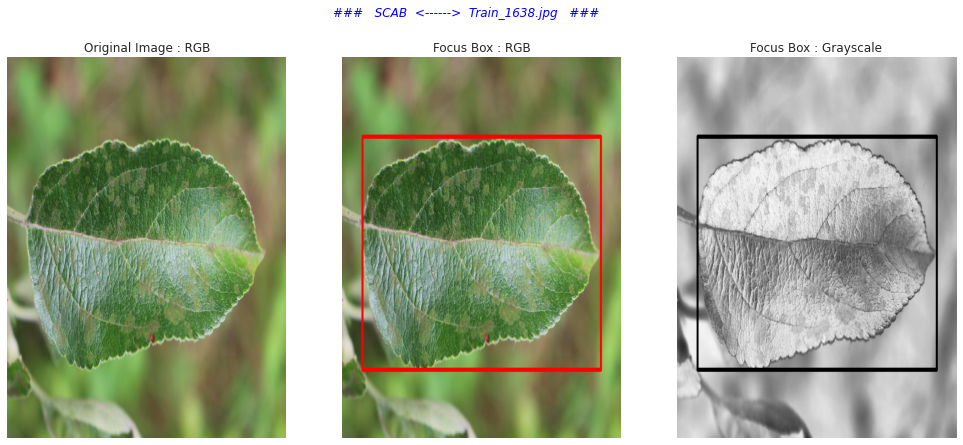

In [63]:
plot_big_img("Train_1638.jpg", "scab", start_coord=(150,1120), end_coord=(1900,285), org_axis='off');

**`OBSERVATION`**

In the above image, we found that:
- The highlighted area contains constant light intensity and so many small-small grayish spots which will be useful for correct identification.
- In the grayscale image, we can also actually see these small spots.

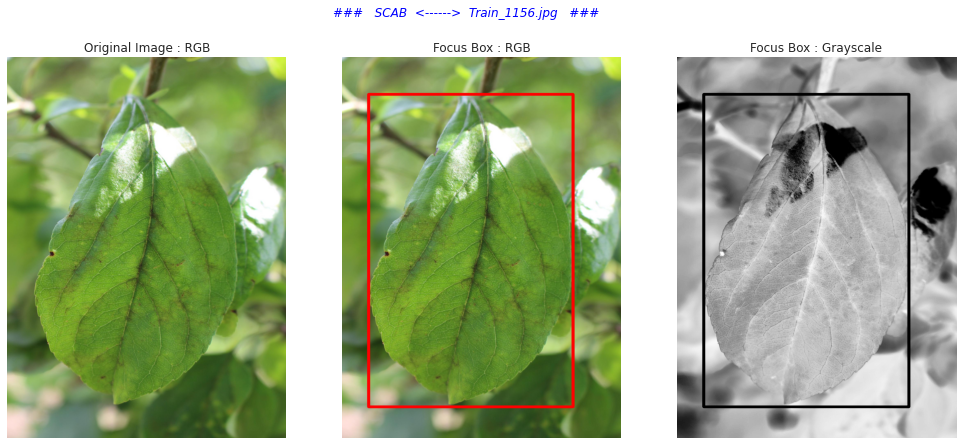

In [64]:
plot_big_img("Train_1156.jpg", "scab", start_coord=(130,1880), end_coord=(1130,200), org_axis='off');

**`OBSERVATION`**

In the above image, we found that:
- The highlighted area contains varying light intensity and black color highlights on the veins of the leaf. So, this is quite interesting needs to be captured as a feature.
- In the grayscale image, we can actually see these black highlights almost vanished.

#### ⭐ **`Finding duplicate images in the dataset`**

### **Q3a.**
#### **Let's check how many duplicate images we have in the dataset❓**

In [65]:
# Seggregating TRAIN & TEST Images in different lists
all_images_loc = os.path.join(os.path.join(os.path.join(os.getcwd(), "Dataset"), "Pathology_2020"), "Images")
all_images_names = os.listdir(all_images_loc)

all_test_imgs_names = []
all_train_imgs_names = []
for img in all_images_names:
    if img.split("_")[0] == "Test":
        all_test_imgs_names.append(os.path.join(all_images_loc,img))
    else:
        all_train_imgs_names.append(os.path.join(all_images_loc,img))

In [66]:
# The count of images should be 1821 for TRAIN & TEST sets
len(all_test_imgs_names), len(all_train_imgs_names)

(1821, 1821)

In [67]:
# Creating TRAIN & TEST images dataframes
all_train_imgs_names_df = pd.DataFrame(all_train_imgs_names, columns=['images_loc'])
all_test_imgs_names_df = pd.DataFrame(all_test_imgs_names, columns=['images_loc'])

In [68]:
def generate_md5_code(image):
    """
    Description : This function is created for generating the MD5 hexadecimal code of every image.
    
    Input : It accepts one 1 input parameter:
        - image : `str`
            Path of image with its name.
            
    Return : It returns the below object:
        - md5_code : `str`
            Hexadecimal code.
    """
    img = cv2.imread(image)
    md5_generator = hashlib.md5(img)
    md5_code = md5_generator.hexdigest()
    return md5_code

In [69]:
# All image names with path in a dataframe
all_df = pd.concat([all_train_imgs_names_df, all_test_imgs_names_df], axis=0).reset_index(drop=True)
all_df

,images_loc
0,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
1,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
2,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
3,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
4,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
...,...
3637,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
3638,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
3639,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
3640,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...


In [70]:
# Generating the MD5 hexadecimal codes of all images
all_df['md5_code'] = all_df['images_loc'].apply(lambda img: generate_md5_code(img))

In [71]:
# Count the occurences of every code
all_md5_counts = pd.DataFrame(all_df['md5_code'].value_counts()).reset_index(drop=False)
all_md5_counts.columns = ['md5_code', 'counts']
all_md5_counts

,md5_code,counts
0,81f763a49d628fe3df6425afe7bdde2d,2
1,c2eb0d2a972a549f3950f42a4084635a,2
2,a7882dfb8709f832926b5f52d4fc9072,2
3,a58a14af878cfe29712a9ad1697c4b54,2
4,c09f4dbe73e284fa865473015c1265ef,2
...,...,...
3632,6e3a22e170ebe61e6b339a60267789b8,1
3633,832853a11fd66f662e2ee3d7c9ed715f,1
3634,0812c5155d09f4acc57698ae03579b50,1
3635,13a6294294b8215f8eebd7a05fa40215,1


In [72]:
# Joining the images names and paths with MD5 Occurences
all_images_md5_counts_df = pd.merge(left=all_df, right=all_md5_counts, on='md5_code')
all_images_md5_counts_df.head(10)

,images_loc,md5_code,counts
0,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,03028703fa539ad6fc7e1ea8c1b6d4b8,1
1,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,b4f4ed8936cb3d2de804052e464268f3,1
2,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,39706532873ea2516d66d5338202cbfd,1
3,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,41f97aa6a2bd0456e1ee05568911d647,1
4,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,6a4e00c14562275e23e96ba835d80d61,1
5,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,45e120533bce0df65b6433c37388f77b,1
6,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,e214f3909881dbdc0326e5b699c17b68,1
7,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,18412b0e8980617ce596412c5b8d184b,1
8,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,e90762bf92562d9c628256e12175a7a3,1
9,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,49ff15422276dba19f4381413e78e1d6,1


In [73]:
# Duplicate images in the TRAIN & TEST images
duplicates_df = all_images_md5_counts_df[all_images_md5_counts_df['counts'] == 2].copy(deep=True)
duplicates_df['images_loc'] = duplicates_df['images_loc'].apply(lambda path: path.split("\\")[-1])
duplicates_df.reset_index(drop=True, inplace=True)
duplicates_df

,images_loc,md5_code,counts
0,Train_1173.jpg,81f763a49d628fe3df6425afe7bdde2d,2
1,Train_379.jpg,81f763a49d628fe3df6425afe7bdde2d,2
2,Train_1505.jpg,a58a14af878cfe29712a9ad1697c4b54,2
3,Test_829.jpg,a58a14af878cfe29712a9ad1697c4b54,2
4,Train_1703.jpg,c09f4dbe73e284fa865473015c1265ef,2
5,Test_1407.jpg,c09f4dbe73e284fa865473015c1265ef,2
6,Test_1212.jpg,a7882dfb8709f832926b5f52d4fc9072,2
7,Test_570.jpg,a7882dfb8709f832926b5f52d4fc9072,2
8,Test_1691.jpg,c2eb0d2a972a549f3950f42a4084635a,2
9,Test_683.jpg,c2eb0d2a972a549f3950f42a4084635a,2


In [74]:
# Let's display the duplicate images
duplicate_images = duplicates_df['images_loc'].values
duplicate_images

array(['Train_1173.jpg', 'Train_379.jpg', 'Train_1505.jpg',
       'Test_829.jpg', 'Train_1703.jpg', 'Test_1407.jpg', 'Test_1212.jpg',
       'Test_570.jpg', 'Test_1691.jpg', 'Test_683.jpg'], dtype=object)

In [75]:
all_images_loc

'E:\\STUDY\\PROJECTS\\AAIC_Case_Study_2\\Dataset\\Pathology_2020\\Images'

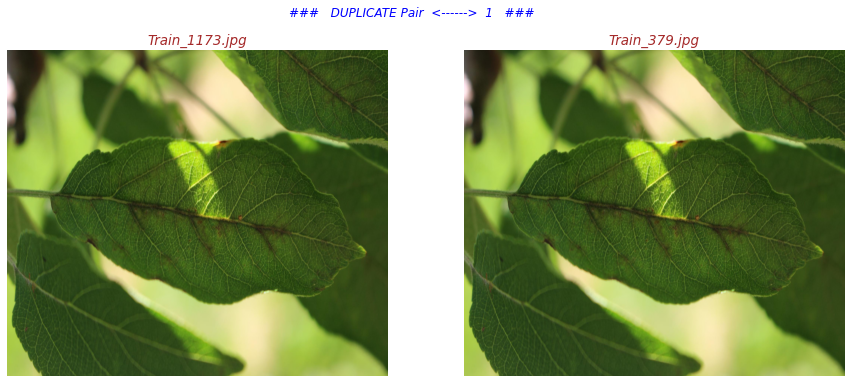

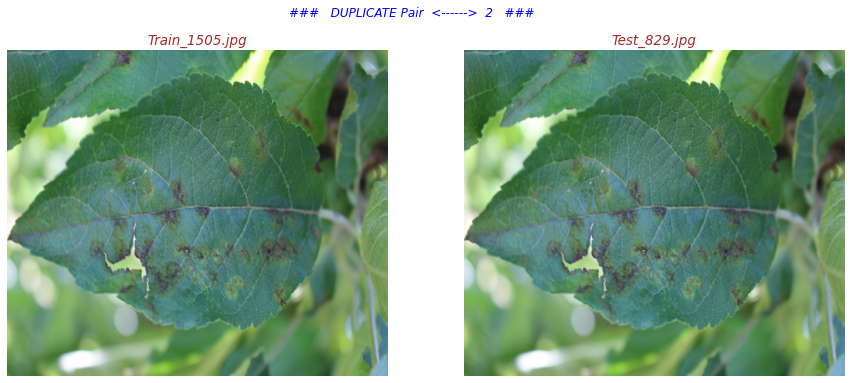

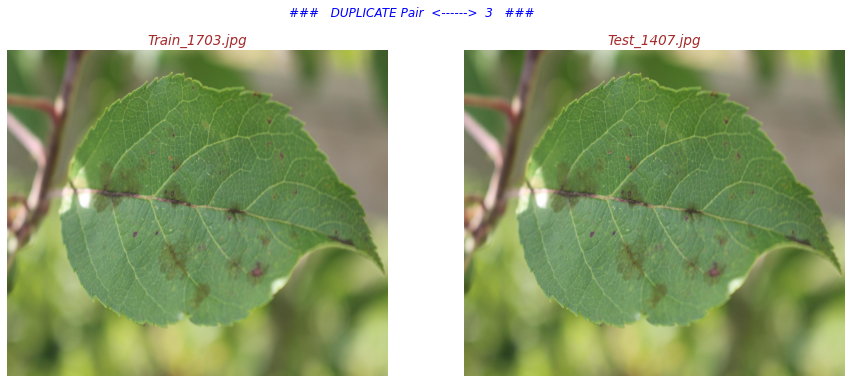

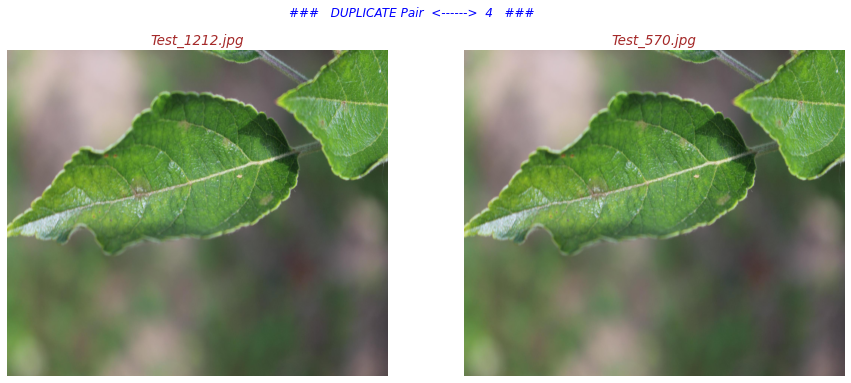

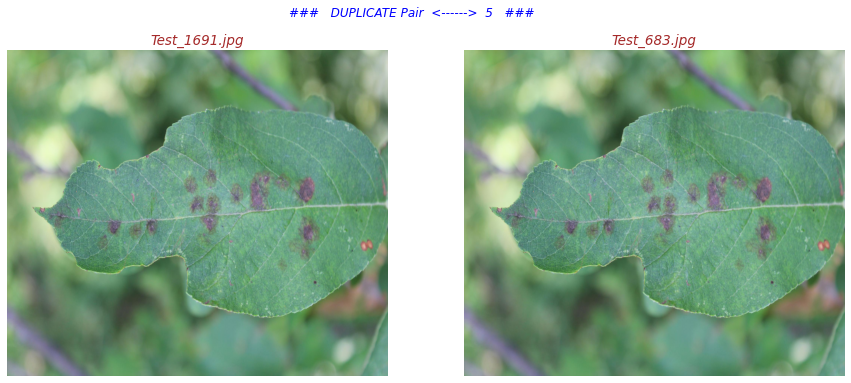

In [76]:
col1_images = duplicate_images[::2]
col2_images = duplicate_images[1::2]

for i in range(len(col1_images)):
    with plt.style.context('seaborn-poster'):
            fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15,6), sharex=False, sharey=False)
            # Storing the images with specific path or location
            img1_path = os.path.join(all_images_loc, col1_images[i])
            img2_path = os.path.join(all_images_loc, col2_images[i])

            # Reading the images
            img1 = cv2.imread(img1_path)
            img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
            
            img2 = cv2.imread(img2_path)
            img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
            
            # Plotting the image-1
            ax[0].imshow(img1, aspect='auto')
            ax[0].axis("off")
            ax[0].set_title(col1_images[i], fontdict=label_font_dict)

            # Plotting the image-2
            ax[1].imshow(img2, aspect='auto')
            ax[1].axis("off")
            ax[1].set_title(col2_images[i], fontdict=label_font_dict)

            # Figure title
            fig.suptitle("###   DUPLICATE Pair  <------>  {}   ###\n".format(i+1), fontdict=title_font_dict)

**`OBSERVATION - 1`**

- The above analysis shows us that there are 5 pairs of images which are duplicates. Thus, we need to drop these images from the dataset.

#### **🤔 In the above analysis, we found that the 2 images `Train_592.jpg` & `Train_782.jpg` appears to be identical, however, there md5 codes are different.**
- So, this needs to be validated much more closely..🕵️‍

In [77]:
all_images_md5_counts_df['img_name'] = all_images_md5_counts_df['images_loc'].apply(lambda img_path: img_path.split("\\")[-1])
all_images_md5_counts_df.head(10)

,images_loc,md5_code,counts,img_name
0,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,03028703fa539ad6fc7e1ea8c1b6d4b8,1,Train_0.jpg
1,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,b4f4ed8936cb3d2de804052e464268f3,1,Train_1.jpg
2,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,39706532873ea2516d66d5338202cbfd,1,Train_10.jpg
3,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,41f97aa6a2bd0456e1ee05568911d647,1,Train_100.jpg
4,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,6a4e00c14562275e23e96ba835d80d61,1,Train_1000.jpg
5,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,45e120533bce0df65b6433c37388f77b,1,Train_1001.jpg
6,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,e214f3909881dbdc0326e5b699c17b68,1,Train_1002.jpg
7,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,18412b0e8980617ce596412c5b8d184b,1,Train_1003.jpg
8,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,e90762bf92562d9c628256e12175a7a3,1,Train_1004.jpg
9,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,49ff15422276dba19f4381413e78e1d6,1,Train_1005.jpg


In [78]:
all_images_md5_counts_df[(all_images_md5_counts_df['img_name'] == "Train_592.jpg") | (all_images_md5_counts_df['img_name'] == "Train_782.jpg")]

,images_loc,md5_code,counts,img_name
1371,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,208674a886f9f971a851b90e825c1ac0,1,Train_592.jpg
1582,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,3caa65fc0a8cd4ccf2aeabea021bd5fb,1,Train_782.jpg


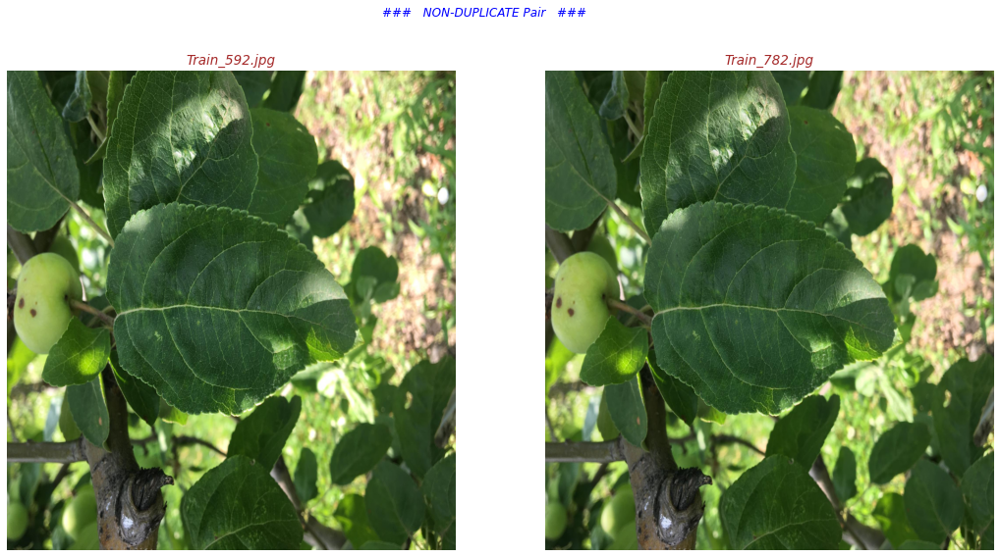

In [79]:
with plt.style.context('seaborn-poster'):
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(18,9), sharex=False, sharey=False)
    # Storing the images with specific path or location
    img1_path = os.path.join(all_images_loc, "Train_592.jpg")
    img2_path = os.path.join(all_images_loc, "Train_782.jpg")
    
    # Reading the images
    img1 = cv2.imread(img1_path)
    img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
         
    img2 = cv2.imread(img2_path)
    img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
            
    # Plotting the image-1
    ax[0].imshow(img1, aspect='auto')
    ax[0].axis("off")
    ax[0].set_title("Train_592.jpg", fontdict=label_font_dict)

    # Plotting the image-2
    ax[1].imshow(img2, aspect='auto')
    ax[1].axis("off")
    ax[1].set_title("Train_782.jpg", fontdict=label_font_dict)

    # Figure title
    fig.suptitle("###   NON-DUPLICATE Pair   ###", fontdict=title_font_dict)

**`OBSERVATION - 2`**

- Here, are the observations :
    - `Train_592.jpg` : This image has the veins of leaf much more prominent and sharp.
    - `Train_782.jpg` : This image is less sharp and noisy.

In [80]:
# Below line is commented out for now and will do this deletion at the time of image pre-processing
# os.remove(os.path.join(all_images_loc,"Train_379.jpg"))

**`REASONING`**

- For now, I have dropped only one of the duplicate images that were in the TRAIN set. Because, we don't want to have duplicated images in TRAIN.
- Rest of the images I'm keeping as it is because would like to see how model behaves on such images.

#### ⭐ **`View all images channels distribution`**

### **Q4.**
#### **What are the distributions of the RGB channels in the TRAIN & TEST images❓**

**`REASONING`**
- My intention behind doing the RGB channels distribution analysis is to check which color is more prominent in the:
    - Entire dataset images,
    - TRAIN & TEST images separately, and,
    - Images of every target disease class

In [81]:
print(len(all_images_names)), print(all_images_loc)

3642
E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pathology_2020\Images


(None, None)

In [82]:
all_images_data = pd.DataFrame(all_images_names)
all_images_data.columns = ['Image_Name']
all_images_data['Image_Loc'] = all_images_loc
all_images_data

,Image_Name,Image_Loc
0,Test_0.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
1,Test_1.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
2,Test_10.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
3,Test_100.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
4,Test_1000.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
...,...,...
3637,Train_995.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
3638,Train_996.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
3639,Train_997.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
3640,Train_998.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...


In [83]:
def read_images(image_path):
    """
    """
    # Reading the image
    img = cv2.imread(image_path, -1)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # Retrieving the mean value of all the channels of an image
    red_channel = np.median(img[:,:,0])
    green_channel = np.median(img[:,:,1])
    blue_channel = np.median(img[:,:,2])
    return [red_channel, green_channel, blue_channel]

In [84]:
all_images_data.head()

,Image_Name,Image_Loc
0,Test_0.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
1,Test_1.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
2,Test_10.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
3,Test_100.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...
4,Test_1000.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...


In [85]:
all_images_data[["Mean_Channel_Values"]] = all_images_data[['Image_Loc', 'Image_Name']].progress_apply(lambda row: read_images(os.path.join(row['Image_Loc'], row['Image_Name'])), axis=1)

100%|██████████████████████████████████████████████████████████████████████████████| 3642/3642 [07:14<00:00,  8.39it/s]


In [86]:
all_images_data

,Image_Name,Image_Loc,Mean_Channel_Values
0,Test_0.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,"[81.0, 122.0, 45.0]"
1,Test_1.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,"[92.0, 130.0, 68.0]"
2,Test_10.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,"[75.0, 118.0, 98.0]"
3,Test_100.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,"[86.0, 136.0, 99.0]"
4,Test_1000.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,"[82.0, 121.0, 89.0]"
...,...,...,...
3637,Train_995.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,"[109.0, 150.0, 81.0]"
3638,Train_996.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,"[80.0, 110.0, 42.0]"
3639,Train_997.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,"[79.0, 128.0, 72.0]"
3640,Train_998.jpg,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,"[88.0, 146.0, 73.0]"


In [87]:
rgb_vals = all_images_data['Mean_Channel_Values'].apply(pd.Series)
rgb_vals.columns = ['Red', 'Green', 'Blue']
rgb_vals

,Red,Green,Blue
0,81.0,122.0,45.0
1,92.0,130.0,68.0
2,75.0,118.0,98.0
3,86.0,136.0,99.0
4,82.0,121.0,89.0
...,...,...,...
3637,109.0,150.0,81.0
3638,80.0,110.0,42.0
3639,79.0,128.0,72.0
3640,88.0,146.0,73.0


In [88]:
all_images_data_channels = pd.concat([all_images_data, rgb_vals], axis=1)
all_images_data_channels.drop(['Mean_Channel_Values'], axis=1, inplace=True)
all_images_data_channels.rename(columns={'Image_Name': 'image_id'}, inplace=True)
all_images_data_channels['image_id'] = all_images_data_channels['image_id'].apply(lambda val: val.split(".")[0])
all_images_data_channels

,image_id,Image_Loc,Red,Green,Blue
0,Test_0,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,81.0,122.0,45.0
1,Test_1,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,92.0,130.0,68.0
2,Test_10,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,75.0,118.0,98.0
3,Test_100,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,86.0,136.0,99.0
4,Test_1000,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,82.0,121.0,89.0
...,...,...,...,...,...
3637,Train_995,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,109.0,150.0,81.0
3638,Train_996,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,80.0,110.0,42.0
3639,Train_997,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,79.0,128.0,72.0
3640,Train_998,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,88.0,146.0,73.0


#### **📊 `ALL (TRAIN + TEST) Images`**

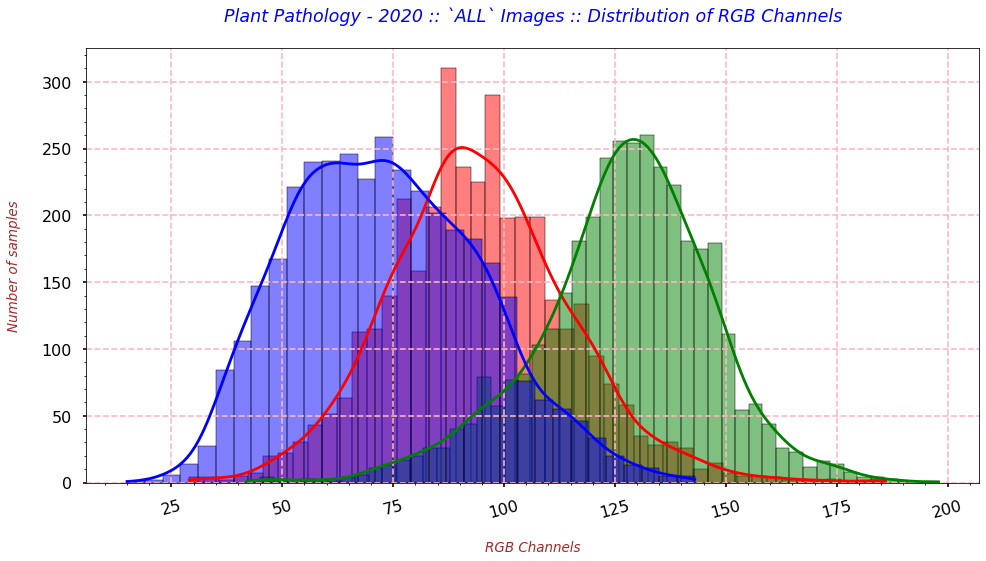

In [106]:
# Visualizing distribution of RGB channels of ALL Images
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(all_images_data_channels['Red'], kde=True, color='red', legend=True)
    sns.histplot(all_images_data_channels['Green'], kde=True, color='green', legend=True)
    sns.histplot(all_images_data_channels['Blue'], kde=True, color='blue', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nRGB Channels", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `ALL` Images :: Distribution of RGB Channels\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of RGB channel values for all the images.
    - This initial look indicates the RED channel values are very much like the Normal Distribution.
    - Whereas, for the BLUE channel we can see the heavy right tail.
    - And, for the GREEN channel we have a long left tail with overall values greater than the other two channels.

###  ALL Images  ::  RED channel  ###  
  MIN --> 29.0  
  MAX --> 186.0  
  MEAN --> 94.51565074135091  
  MEDIAN --> 93.5
  RANGE --> 157.0



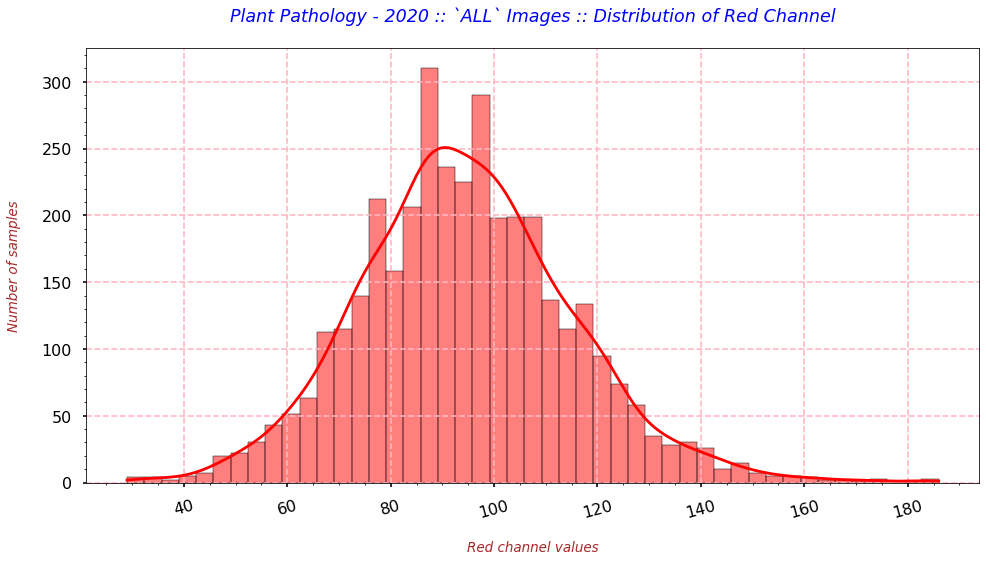

In [121]:
# MIN, MAX, MEAN & MEDIAN of a channel
print("###  {}  ::  {} channel  ###  \n  MIN --> {}  \n  MAX --> {}  \n  MEAN --> {}  \
\n  MEDIAN --> {}\n  RANGE --> {}\n".format("ALL Images",
                                            "RED", 
                                            all_images_data_channels['Red'].min(), 
                                            all_images_data_channels['Red'].max(),
                                            all_images_data_channels['Red'].mean(),
                                            all_images_data_channels['Red'].median(),
                                            (all_images_data_channels['Red'].max() - all_images_data_channels['Red'].min())))

# Visualizing only RED channel
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(all_images_data_channels['Red'], kde=True, color='red', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nRed channel values", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `ALL` Images :: Distribution of Red Channel\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of RED channel values for all the images.
    - It looks like a Normal Curve with a slightly longer right tail, which tells us that some of the images have higher value of RED.
    - Majority of the images have the values b/w [78 - 114].

###  ALL Images  ::  GREEN channel  ###  
  MIN --> 42.0  
  MAX --> 198.0  
  MEAN --> 126.91103789126853  
  MEDIAN --> 128.0
  RANGE --> 156.0



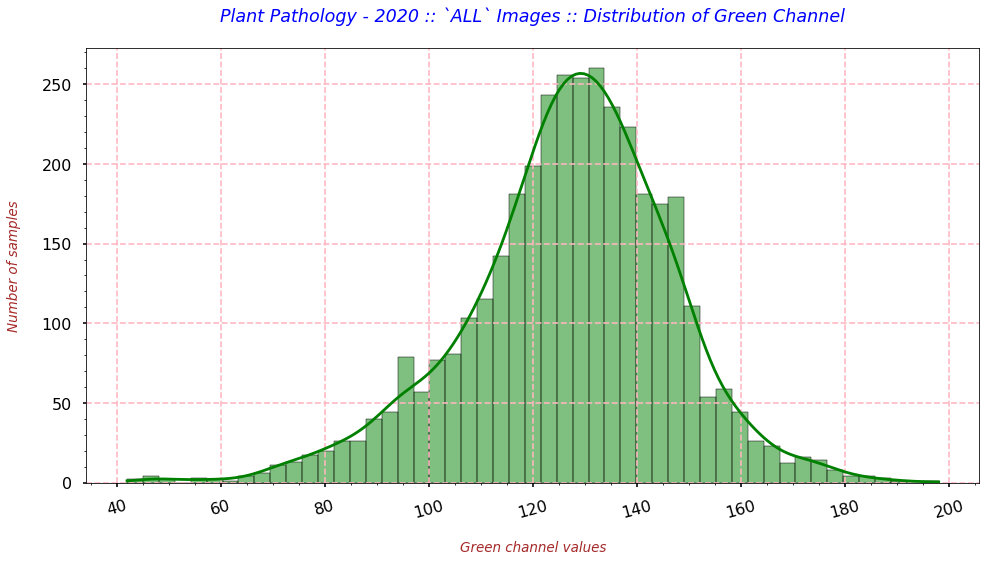

In [129]:
# MIN, MAX, MEAN & MEDIAN of a channel
print("###  {}  ::  {} channel  ###  \n  MIN --> {}  \n  MAX --> {}  \n  MEAN --> {}  \
\n  MEDIAN --> {}\n  RANGE --> {}\n".format("ALL Images",
                                            "GREEN", 
                                            all_images_data_channels['Green'].min(), 
                                            all_images_data_channels['Green'].max(),
                                            all_images_data_channels['Green'].mean(),
                                            all_images_data_channels['Green'].median(),
                                            (all_images_data_channels['Green'].max() - all_images_data_channels['Green'].min())))

# Visualizing only GREEN channel
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(all_images_data_channels['Green'], kde=True, color='green', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nGreen channel values", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `ALL` Images :: Distribution of Green Channel\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of GREEN channel values for all the images.
    - It looks like the curve is slightly negatively skewed, which tells us that the average value of it is also on a higher side.
    - There are very few images with very less & very high value of GREEN.
    - And, majority of the images have the values b/w [115 - 150].

###  ALL Images  ::  BLUE channel  ###  
  MIN --> 15.0  
  MAX --> 143.0  
  MEAN --> 73.1891817682592  
  MEDIAN --> 72.0
  RANGE --> 128.0



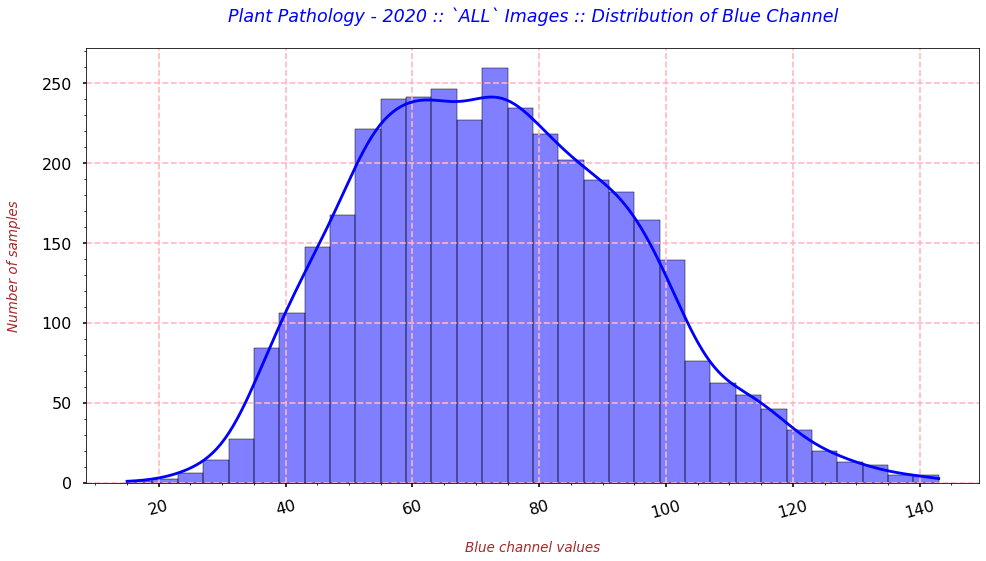

In [130]:
# MIN, MAX, MEAN & MEDIAN of a channel
print("###  {}  ::  {} channel  ###  \n  MIN --> {}  \n  MAX --> {}  \n  MEAN --> {}  \
\n  MEDIAN --> {}\n  RANGE --> {}\n".format("ALL Images",
                                            "BLUE", 
                                            all_images_data_channels['Blue'].min(), 
                                            all_images_data_channels['Blue'].max(),
                                            all_images_data_channels['Blue'].mean(),
                                            all_images_data_channels['Blue'].median(),
                                            (all_images_data_channels['Blue'].max() - all_images_data_channels['Blue'].min())))

# Visualizing only BLUE channel
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(all_images_data_channels['Blue'], kde=True, color='blue', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nBlue channel values", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `ALL` Images :: Distribution of Blue Channel\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of BLUE channel values for all the images.
    - It looks like the curve has slightly flat peak, which tells us that the equal number of images have same value.
    - The right tail of the curve is also heavy where values are not sharply.
    - And, majority of the images have the values b/w [50 - 100].

In [131]:
# Displaying the statistics related to every channel
## MIN, MAX, MEAN & MEDIAN of RGB channels of all images
cols = ['MIN', 'MAX', 'MEAN', 'MEDIAN', "RANGE", "STDDEV"]

all_img_red_sts = pd.DataFrame([all_images_data_channels['Red'].min(), all_images_data_channels['Red'].max(), 
                                np.round(all_images_data_channels['Red'].mean(),1), all_images_data_channels['Red'].median(),
                                (all_images_data_channels['Red'].max() - all_images_data_channels['Red'].min()),
                                np.std(all_images_data_channels['Red'])]).T
all_img_red_sts.columns = cols

all_img_green_sts = pd.DataFrame([all_images_data_channels['Green'].min(), all_images_data_channels['Green'].max(), 
                                  np.round(all_images_data_channels['Green'].mean(),1), all_images_data_channels['Green'].median(),
                                 (all_images_data_channels['Green'].max() - all_images_data_channels['Green'].min()),
                                 np.std(all_images_data_channels['Green'])]).T
all_img_green_sts.columns = cols

all_img_blue_sts = pd.DataFrame([all_images_data_channels['Blue'].min(), all_images_data_channels['Blue'].max(), 
                                 np.round(all_images_data_channels['Blue'].mean(),1), all_images_data_channels['Blue'].median(),
                                (all_images_data_channels['Blue'].max() - all_images_data_channels['Blue'].min()),
                                np.std(all_images_data_channels['Blue'])]).T
all_img_blue_sts.columns = cols

all_img_rgb_sts = pd.concat([all_img_red_sts, all_img_green_sts, all_img_blue_sts], axis=0)
all_img_rgb_sts.index = ["RED", "GREEN", "BLUE"]
all_img_rgb_sts

,MIN,MAX,MEAN,MEDIAN,RANGE,STDDEV
RED,29.0,186.0,94.5,93.5,157.0,20.558549
GREEN,42.0,198.0,126.9,128.0,156.0,19.913054
BLUE,15.0,143.0,73.2,72.0,128.0,21.466170


**`OBSERVATION`**

- From the above table, we deduce that:
    - The GREEN channel has the value on a higher side as compared to the other channels.
        - Its MIN and MAX both are greater than the other channels.
        - This stands TRUE with our initial thought.
    - The BLUE channel has the value on a lower side as compared to the other channels.
        - Its MIN and MAX both are smaller than the other channels. Also, the range of values is smaller than the others.
    - The difference b/w MEAN and MEDIAN of all the 3 channels is not much wider.
    - Also, the STDDEV of all the 3 channels is close to each other.

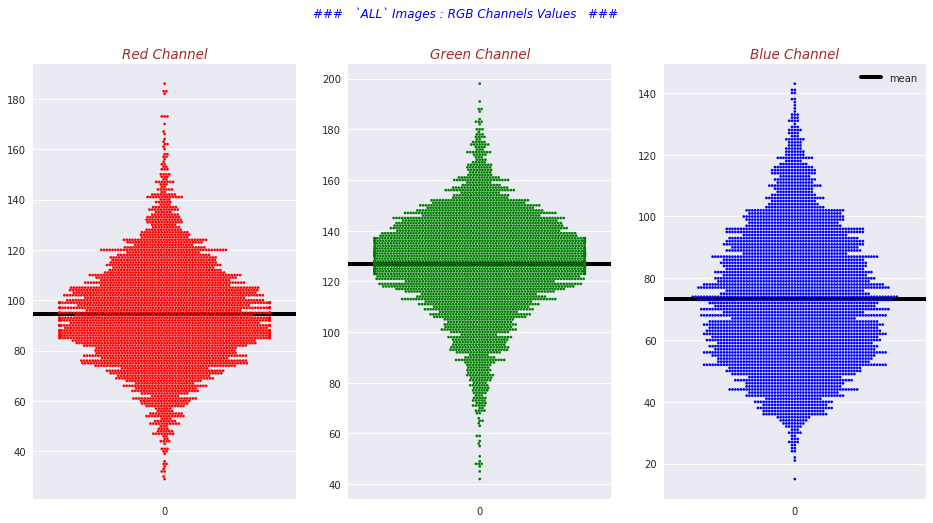

In [132]:
# Visualizing the RGB channels values of all images
with plt.style.context('seaborn'):
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16,8), sharex=False, sharey=False)
        # Plotting the RED Channel
        sns.swarmplot(data=all_images_data_channels['Red'], color='red', size=2.7, ax=ax[0])
        ax[0].axhline(y=all_images_data_channels['Red'].mean(), color='black', linewidth=4, label='mean')
        ax[0].set_title("Red Channel", fontdict= label_font_dict)
        
        # Plotting the Green Channel
        sns.swarmplot(data=all_images_data_channels['Green'], color='green', size=2.7, ax=ax[1])
        ax[1].axhline(y=all_images_data_channels['Green'].mean(), color='black', linewidth=4, label='mean')
        ax[1].set_title("Green Channel", fontdict= label_font_dict)
        
        # Plotting the Blue Channel
        sns.swarmplot(data=all_images_data_channels['Blue'], color='blue', size=2.7, ax=ax[2])
        ax[2].axhline(y=all_images_data_channels['Blue'].mean(), color='black', linewidth=4, label='mean')
        ax[2].set_title("Blue Channel", fontdict= label_font_dict)
        
        fig.suptitle("###   `ALL` Images : RGB Channels Values   ###", fontdict=title_font_dict)
        plt.legend()

**`OBSERVATION`**

- The above plot is showing us the how RGB channels values exist in the images.
    - This again tells us that the peak of BLUE channel is flat and wide.
    - And, there are very few images with the extreme values.
    - And, majority of the images for RED and GREEN channel have values closer to the mean.

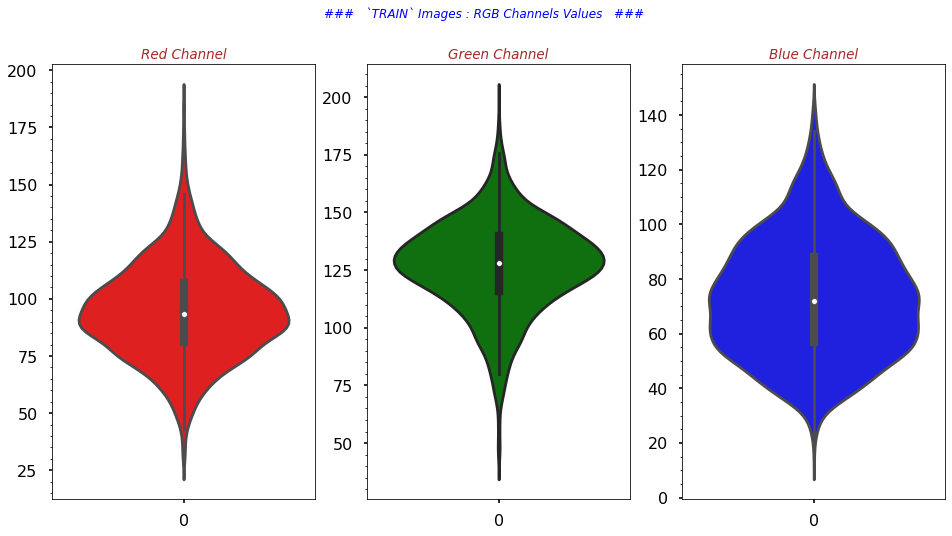

In [239]:
with plt.style.context('seaborn-poster'):
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16,8), sharex=False, sharey=False)
        # Plotting the RED Channel
        sns.violinplot(data=all_images_data_channels['Red'], color='red', ax=ax[0])
        ax[0].set_title("Red Channel", fontdict= label_font_dict)
        ax[0].minorticks_on()
        
        # Plotting the Green Channel
        sns.violinplot(data=all_images_data_channels['Green'], color='green', ax=ax[1])
        ax[1].set_title("Green Channel", fontdict= label_font_dict)
        ax[1].minorticks_on()
        
        # Plotting the Blue Channel
        sns.violinplot(data=all_images_data_channels['Blue'], color='blue', ax=ax[2])
        ax[2].set_title("Blue Channel", fontdict= label_font_dict)
        ax[2].minorticks_on()
        
        fig.suptitle("###   `TRAIN` Images : RGB Channels Values   ###", fontdict=title_font_dict)

**`OBSERVATION`**

- The above plot is showing us the how RGB channels values exist in the images.
    - This again tells us that the peak of BLUE channel is flat and wide.
    - And, there are very few images with the extreme values.
    - And, majority of the images for RED and GREEN channel have values closer to the mean.

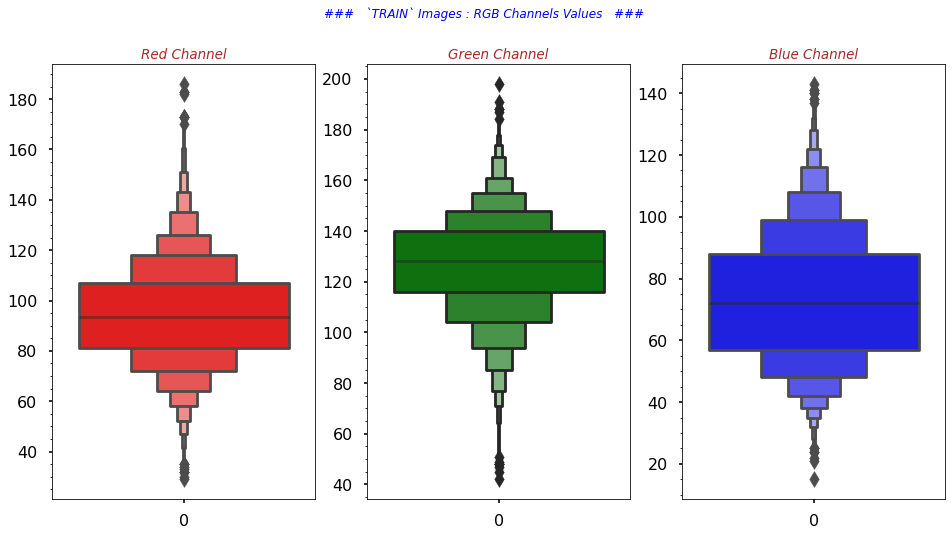

In [240]:
with plt.style.context('seaborn-poster'):
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16,8), sharex=False, sharey=False)
        # Plotting the RED Channel
        sns.boxenplot(data=all_images_data_channels['Red'], color='red', ax=ax[0])
        ax[0].set_title("Red Channel", fontdict= label_font_dict)
        ax[0].minorticks_on()
        
        # Plotting the Green Channel
        sns.boxenplot(data=all_images_data_channels['Green'], color='green', ax=ax[1])
        ax[1].set_title("Green Channel", fontdict= label_font_dict)
        ax[1].minorticks_on()
        
        # Plotting the Blue Channel
        sns.boxenplot(data=all_images_data_channels['Blue'], color='blue', ax=ax[2])
        ax[2].set_title("Blue Channel", fontdict= label_font_dict)
        ax[2].minorticks_on()
        
        fig.suptitle("###   `TRAIN` Images : RGB Channels Values   ###", fontdict=title_font_dict)

**`OBSERVATION`**

- The above plot is showing us the how RGB channels values exist in the images.
    - This again tells us that the peak of BLUE channel is flat and wide.
    - And, there are very few images with the extreme values.
    - And, majority of the images for RED and GREEN channel have values closer to the mean.

#### **📊`TRAIN Images`**

In [133]:
# Use this dataframe for joining
train_images_info_df

,image_id,healthy,multiple_diseases,rust,scab
0,Train_0,0,0,0,1
1,Train_1,0,1,0,0
2,Train_2,1,0,0,0
3,Train_3,0,0,1,0
4,Train_4,1,0,0,0
...,...,...,...,...,...
1816,Train_1816,0,0,0,1
1817,Train_1817,1,0,0,0
1818,Train_1818,1,0,0,0
1819,Train_1819,0,0,1,0


In [135]:
train_img_chnl_data_tgts = pd.merge(left=all_images_data_channels, right=train_images_info_df, on='image_id')
train_img_chnl_data_tgts

,image_id,Image_Loc,Red,Green,Blue,healthy,multiple_diseases,rust,scab
0,Train_0,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,116.0,134.0,45.0,0,0,0,1
1,Train_1,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,123.0,130.0,76.0,0,1,0,0
2,Train_10,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,81.0,118.0,44.0,0,0,1,0
3,Train_100,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,94.0,136.0,84.0,1,0,0,0
4,Train_1000,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,115.0,143.0,65.0,0,0,1,0
...,...,...,...,...,...,...,...,...,...
1816,Train_995,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,109.0,150.0,81.0,0,0,1,0
1817,Train_996,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,80.0,110.0,42.0,0,0,1,0
1818,Train_997,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,79.0,128.0,72.0,0,0,0,1
1819,Train_998,E:\STUDY\PROJECTS\AAIC_Case_Study_2\Dataset\Pa...,88.0,146.0,73.0,0,0,0,1


#### **📊`HEALTHY`  ::  `TRAIN Images`**

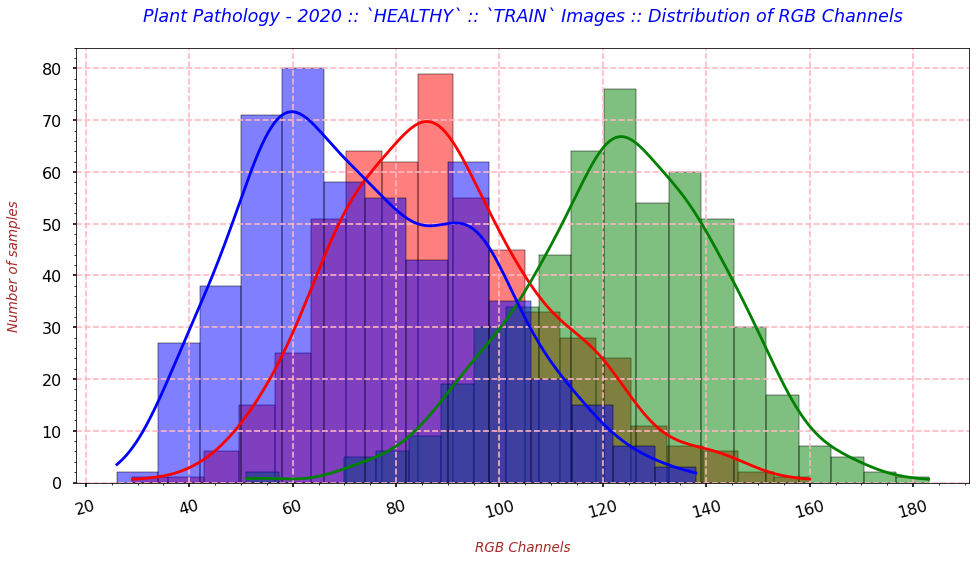

In [138]:
# Visualizing distribution of RGB channels of HEALTHY :: TRAIN Images
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Red'], kde=True, color='red', legend=True)
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Green'], kde=True, color='green', legend=True)
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Blue'], kde=True, color='blue', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nRGB Channels", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `HEALTHY` :: `TRAIN` Images :: Distribution of RGB Channels\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of RGB channel values for only TRAIN images.
    - This initial look indicates the RED channel values looks like the Normal Distribution with right tail slightly on a heavier side.
    - Whereas, for the BLUE channel we can see the 2 peaks with a non-uniform distribution.
    - And, for the GREEN channel we have a long left tail with overall values greater than the other two channels. It also looks like having a normal curve.

###  ALL Images  ::  RED channel  ###  
  MIN --> 29.0  
  MAX --> 160.0  
  MEAN --> 88.97868217054264  
  MEDIAN --> 87.0
  RANGE --> 131.0



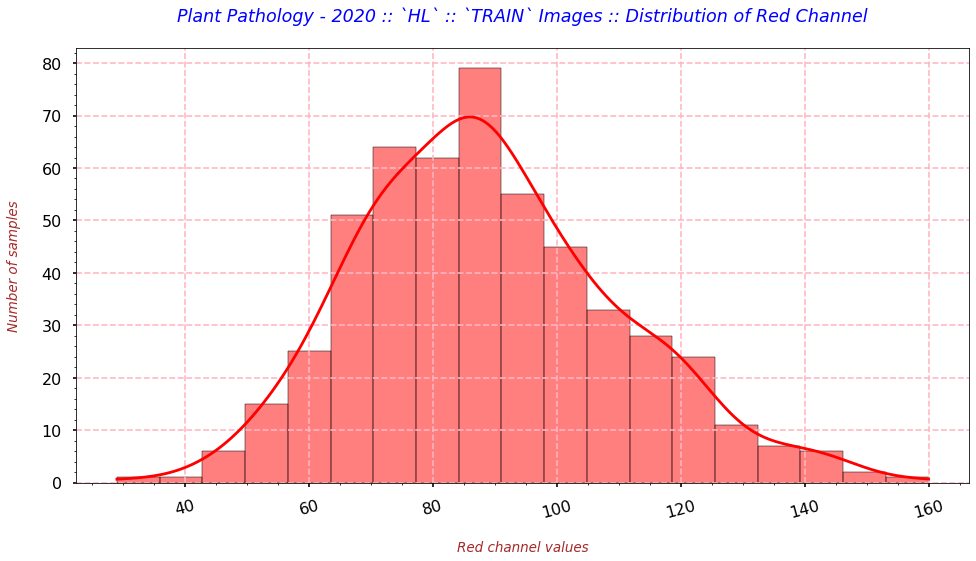

In [139]:
# MIN, MAX, MEAN & MEDIAN of a channel
print("###  {}  ::  {} channel  ###  \n  MIN --> {}  \n  MAX --> {}  \n  MEAN --> {}  \
\n  MEDIAN --> {}\n  RANGE --> {}\n".format("ALL Images",
                                            "RED", 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Red'].min(), 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Red'].max(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Red'].mean(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Red'].median(),
                                            (train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Red'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Red'].min())))

# Visualizing only RED channel
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Red'], kde=True, color='red', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nRed channel values", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `HL` :: `TRAIN` Images :: Distribution of Red Channel\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of RED channel values for only TRAIN images.
    - It looks like a Normal Curve with a slightly longer right tail, which tells us that some of the images have higher value of RED.
    - Majority of the images have the values b/w [65 - 100].

###  ALL Images  ::  GREEN channel  ###  
  MIN --> 51.0  
  MAX --> 183.0  
  MEAN --> 123.33720930232558  
  MEDIAN --> 124.0
  RANGE --> 132.0



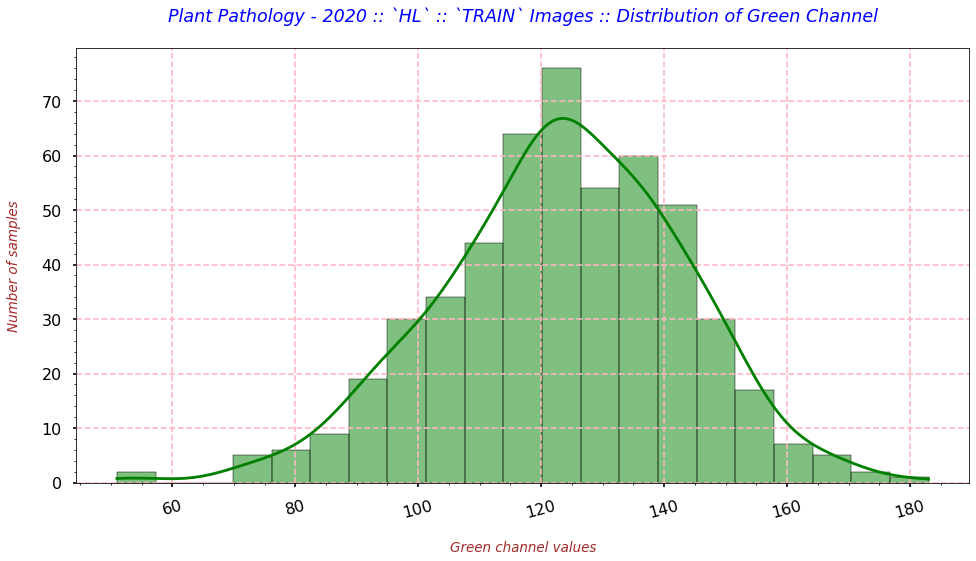

In [140]:
# MIN, MAX, MEAN & MEDIAN of a channel
print("###  {}  ::  {} channel  ###  \n  MIN --> {}  \n  MAX --> {}  \n  MEAN --> {}  \
\n  MEDIAN --> {}\n  RANGE --> {}\n".format("ALL Images",
                                            "GREEN", 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Green'].min(), 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Green'].max(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Green'].mean(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Green'].median(),
                                            (train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Green'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Green'].min())))

# Visualizing only GREEN channel
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Green'], kde=True, color='green', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nGreen channel values", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `HL` :: `TRAIN` Images :: Distribution of Green Channel\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of GREEN channel values for only TRAIN images.
    - It looks like a normal distribution curve with very slightly negatively skewed, which tells us that the average value of it is also on a higher side.
    - There are very few images with very less & very high value of GREEN.
    - And, majority of the images have the values b/w [110 - 150].

###  ALL Images  ::  BLUE channel  ###  
  MIN --> 26.0  
  MAX --> 138.0  
  MEAN --> 73.88372093023256  
  MEDIAN --> 71.0
  RANGE --> 112.0



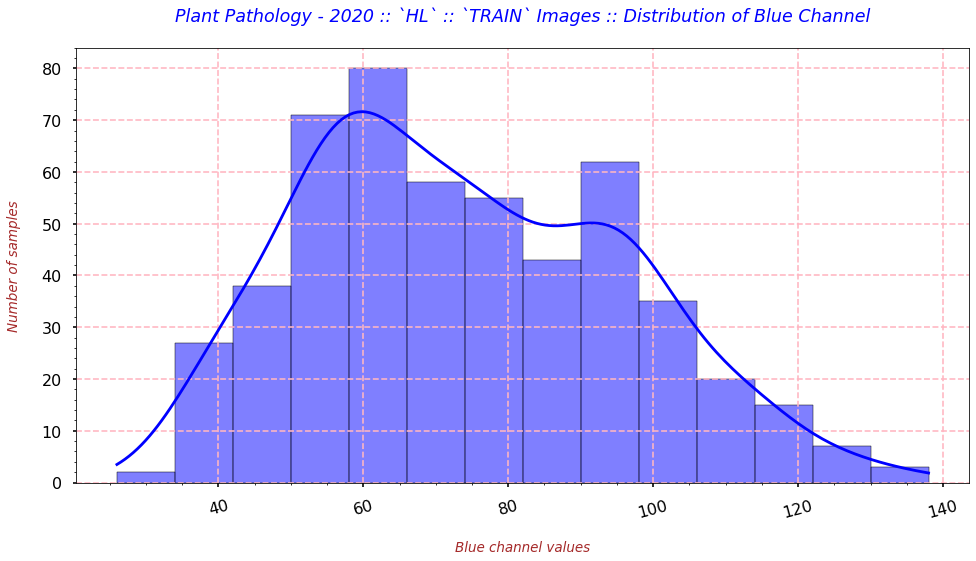

In [141]:
# MIN, MAX, MEAN & MEDIAN of a channel
print("###  {}  ::  {} channel  ###  \n  MIN --> {}  \n  MAX --> {}  \n  MEAN --> {}  \
\n  MEDIAN --> {}\n  RANGE --> {}\n".format("ALL Images",
                                            "BLUE", 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Blue'].min(), 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Blue'].max(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Blue'].mean(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Blue'].median(),
                                            (train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Blue'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Blue'].min())))

# Visualizing only BLUE channel
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Blue'], kde=True, color='blue', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nBlue channel values", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `HL` :: `TRAIN` Images :: Distribution of Blue Channel\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of BLUE channel values for only TRAIN images.
    - The curve is having 2 peaks; it means that two values 60 and 90 are more prominent in this channel.
    - And, majority of the images have the values b/w [50 - 100].

In [143]:
# Displaying the statistics related to every channel
## MIN, MAX, MEAN & MEDIAN of RGB channels of HEALTHY TRAIN images
cols = ['MIN', 'MAX', 'MEAN', 'MEDIAN', "RANGE", "STDDEV"]

tr_img_red_sts = pd.DataFrame([train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Red'].min(),
                                train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Red'].max(), 
                                np.round(train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Red'].mean(),1), 
                                train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Red'].median(),
                                (train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Red'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Red'].min()),
                                np.std(train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Red'])]).T
tr_img_red_sts.columns = cols

tr_img_green_sts = pd.DataFrame([train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Green'].min(), 
                                 train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Green'].max(), 
                                  np.round(train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Green'].mean(),1), 
                                 train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Green'].median(),
                                 (train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Green'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Green'].min()),
                                 np.std(train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Green'])]).T
tr_img_green_sts.columns = cols

tr_img_blue_sts = pd.DataFrame([train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Blue'].min(), 
                                train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Blue'].max(), 
                                 np.round(train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Blue'].mean(),1), 
                                train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Blue'].median(),
                                (train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Blue'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Blue'].min()),
                                np.std(train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Blue'])]).T
tr_img_blue_sts.columns = cols

tr_img_rgb_sts = pd.concat([tr_img_red_sts, tr_img_green_sts, tr_img_blue_sts], axis=0)
tr_img_rgb_sts.index = ["RED", "GREEN", "BLUE"]
tr_img_rgb_sts

,MIN,MAX,MEAN,MEDIAN,RANGE,STDDEV
RED,29.0,160.0,89.0,87.0,131.0,20.992744
GREEN,51.0,183.0,123.3,124.0,132.0,19.693353
BLUE,26.0,138.0,73.9,71.0,112.0,22.037715


**`OBSERVATION`**

- From the above table, we deduce that:
    - The GREEN channel has the value on a higher side as compared to the other channels.
        - Its MIN and MAX both are greater than the other channels.
        - This stands TRUE with our initial thought.
    - The BLUE channel has the value on a lower side as compared to the other channels.
        - Its MIN and MAX both are smaller than the other channels. Also, the range of values is smaller than the others.
    - The difference b/w MEAN and MEDIAN of all the 3 channels is not much wider.
    - The average value of a channel is maximum for GREEN and minimum for the BLUE.
    - Also, the STDDEV of all the 3 channels is close to each other.

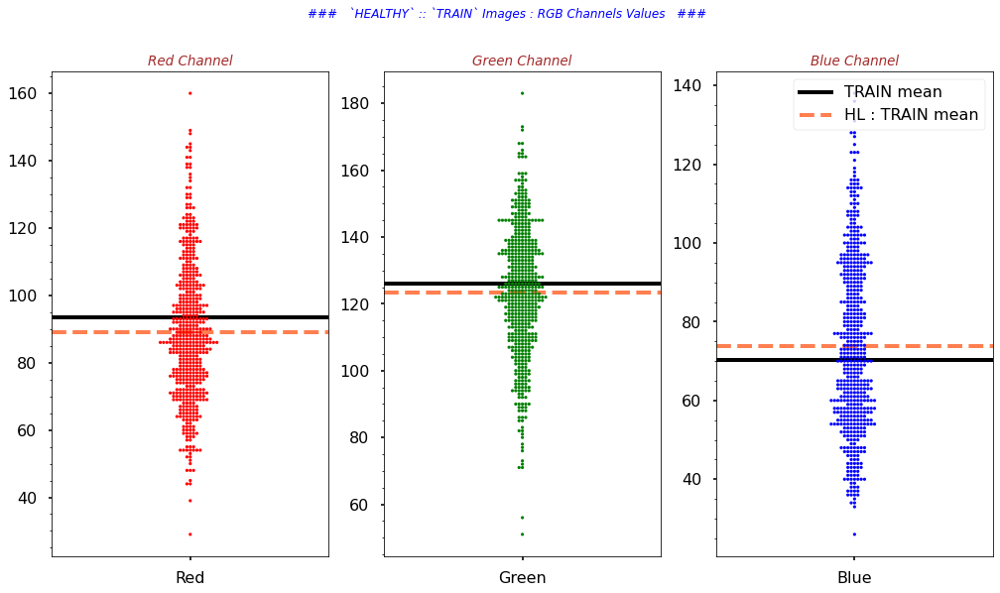

In [145]:
# Visualizing distribution of RGB channels of HEALTHY :: TRAIN Images
with plt.style.context('seaborn-poster'):
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(17,9), sharex=False, sharey=False)
        # Plotting the RED Channel
        sns.swarmplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1][['Red']], color='red', size=3.2, ax=ax[0])
        ax[0].axhline(y=train_img_chnl_data_tgts['Red'].mean(), color='black', linewidth=4, label='TRAIN mean')
        ax[0].axhline(y=train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Red'].mean(), color='coral', linestyle="--", 
                      linewidth=4, label='HL : TRAIN mean')
        ax[0].set_title("Red Channel", fontdict= label_font_dict)
        ax[0].minorticks_on()
        
        # Plotting the Green Channel
        sns.swarmplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1][['Green']], color='green', size=3.2, ax=ax[1])
        ax[1].axhline(y=train_img_chnl_data_tgts['Green'].mean(), color='black', linewidth=4, label='TRAIN mean')
        ax[1].axhline(y=train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Green'].mean(), color='coral', linestyle="--", 
                      linewidth=4, label='HL : TRAIN mean')
        ax[1].set_title("Green Channel", fontdict= label_font_dict)
        ax[1].minorticks_on()
        
        # Plotting the Blue Channel
        sns.swarmplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1][['Blue']], color='blue', size=3.2, ax=ax[2])
        ax[2].axhline(y=train_img_chnl_data_tgts['Blue'].mean(), color='black', linewidth=4, label='TRAIN mean')
        ax[2].axhline(y=train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1]['Blue'].mean(), color='coral', linestyle="--",  
                      linewidth=4, label='HL : TRAIN mean')
        ax[2].set_title("Blue Channel", fontdict= label_font_dict)
        ax[2].minorticks_on()
        
        fig.suptitle("###   `HEALTHY` :: `TRAIN` Images : RGB Channels Values   ###", fontdict=title_font_dict)
        plt.legend(loc='upper right')

**`OBSERVATION`**

- The above plot is showing us the how RGB channels values exist in the images.
    - Here, we found that the average values of RED & GREEN channel in HEALTHY TRAIN images is less than the overall TRAIN images average.
    - Whereas, average values of BLUE channel in HEALTHY TRAIN images is more than the overall TRAIN images average.

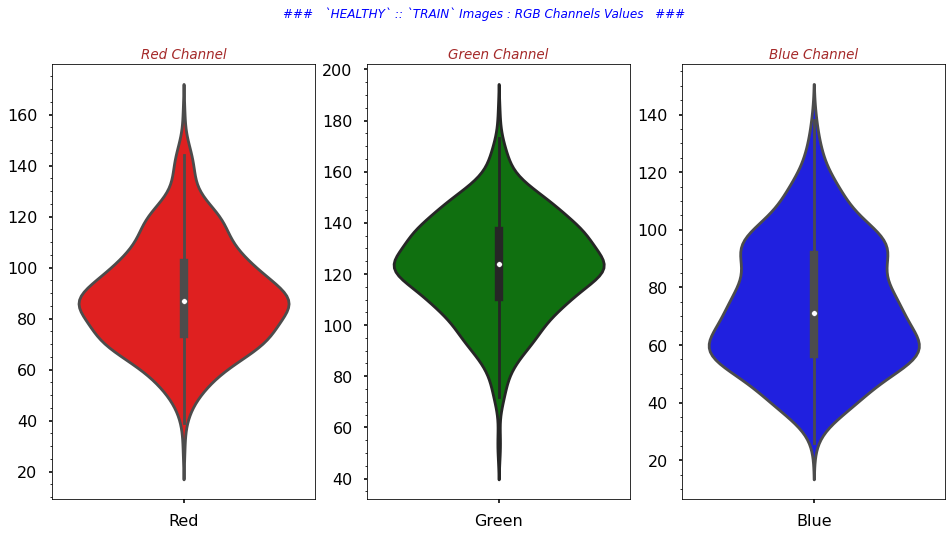

In [144]:
# Visualizing distribution of RGB channels of HEALTHY :: TRAIN Images
with plt.style.context('seaborn-poster'):
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16,8), sharex=False, sharey=False)
        # Plotting the RED Channel
        sns.violinplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1][['Red']], color='red', size=3.2, ax=ax[0])
        ax[0].set_title("Red Channel", fontdict= label_font_dict)
        ax[0].minorticks_on()
        
        # Plotting the Green Channel
        sns.violinplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1][['Green']], color='green', size=3.2, ax=ax[1])
        ax[1].set_title("Green Channel", fontdict= label_font_dict)
        ax[1].minorticks_on()
        
        # Plotting the Blue Channel
        sns.violinplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1][['Blue']], color='blue', size=3.2, ax=ax[2])
        ax[2].set_title("Blue Channel", fontdict= label_font_dict)
        ax[2].minorticks_on()
        
        fig.suptitle("###   `HEALTHY` :: `TRAIN` Images : RGB Channels Values   ###", fontdict=title_font_dict)

**`OBSERVATION`**

- The above plot is showing us the how RGB channels values exist in the images.
    - This again tells us that the peak of BLUE channel is dual peaked.
    - And, there are very few images with the extreme values.
    - And, majority of the images for RED and GREEN channel have values closer to the mean.

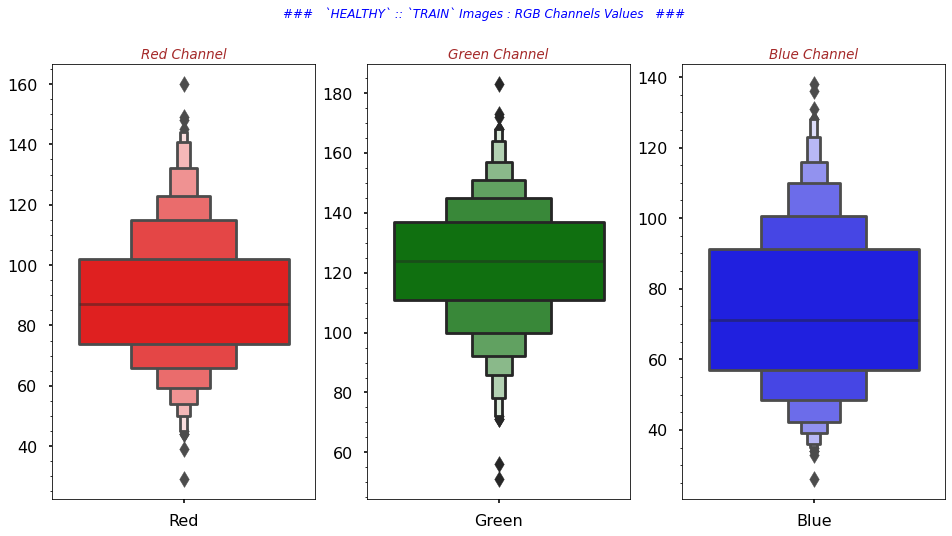

In [146]:
# Visualizing distribution of RGB channels of HEALTHY :: TRAIN Images
with plt.style.context('seaborn-poster'):
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16,8), sharex=False, sharey=False)
        # Plotting the RED Channel
        sns.boxenplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1][['Red']], color='red', ax=ax[0])
        ax[0].set_title("Red Channel", fontdict= label_font_dict)
        ax[0].minorticks_on()
        
        # Plotting the Green Channel
        sns.boxenplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1][['Green']], color='green', ax=ax[1])
        ax[1].set_title("Green Channel", fontdict= label_font_dict)
        ax[1].minorticks_on()
        
        # Plotting the Blue Channel
        sns.boxenplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['healthy'] == 1][['Blue']], color='blue', ax=ax[2])
        ax[2].set_title("Blue Channel", fontdict= label_font_dict)
        ax[2].minorticks_on()
        
        fig.suptitle("###   `HEALTHY` :: `TRAIN` Images : RGB Channels Values   ###", fontdict=title_font_dict)

**`OBSERVATION`**

- The above plot is showing us the how RGB channels values exist in the images.
    - This again tells us that the peak of BLUE channel is dual peaked.
    - And, there are very few images with the extreme values.
    - And, majority of the images for RED and GREEN channel have values closer to the mean.

#### **📊`MULTIPLE DISEASES`  ::  `TRAIN Images`**

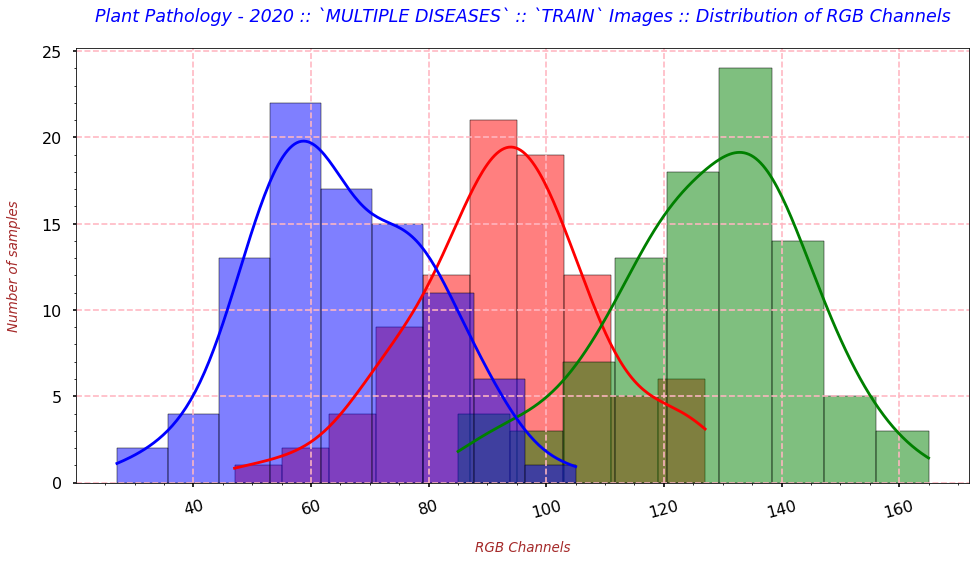

In [147]:
# Visualizing distribution of RGB channels of MULTIPLE DISEASE :: TRAIN Images
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Red'], kde=True, color='red', legend=True)
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Green'], kde=True, color='green', legend=True)
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Blue'], kde=True, color='blue', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nRGB Channels", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `MULTIPLE DISEASES` :: `TRAIN` Images :: Distribution of RGB Channels\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of RGB channel values for only TRAIN images.
    - This initial look indicates the RED channel values following positive skewed curve that means its values will be on higher side.
    - Whereas, for the BLUE channel we can see the 2 peaks with a non-uniform distribution.
    - And, for the GREEN channel we have values greater than the other two channels. It also looks like having a normal curve.

###  ALL Images  ::  RED channel  ###  
  MIN --> 47.0  
  MAX --> 127.0  
  MEAN --> 92.9010989010989  
  MEDIAN --> 93.0
  RANGE --> 80.0



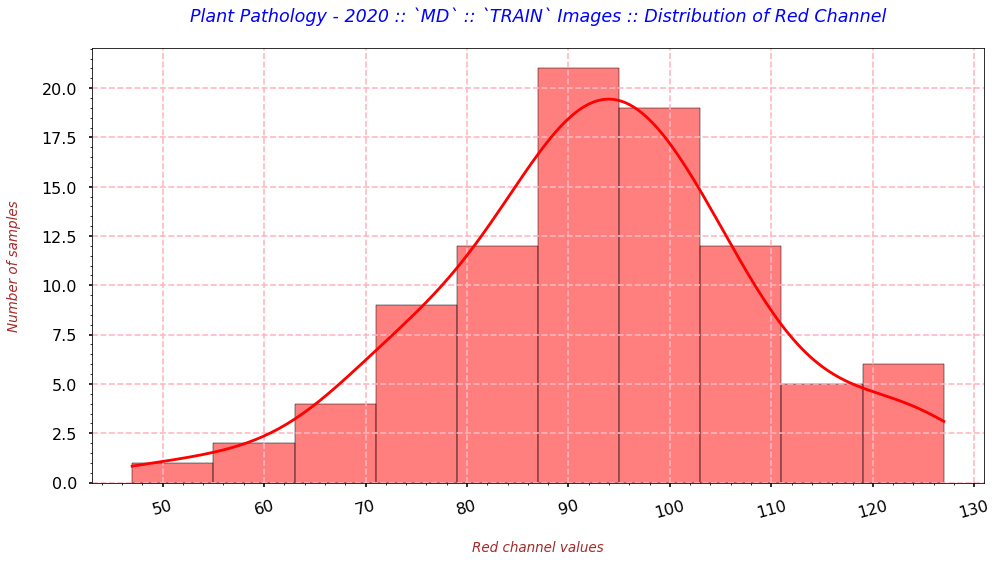

In [148]:
# MIN, MAX, MEAN & MEDIAN of a channel
print("###  {}  ::  {} channel  ###  \n  MIN --> {}  \n  MAX --> {}  \n  MEAN --> {}  \
\n  MEDIAN --> {}\n  RANGE --> {}\n".format("ALL Images",
                                            "RED", 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Red'].min(), 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Red'].max(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Red'].mean(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Red'].median(),
                                            (train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Red'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Red'].min())))

# Visualizing only RED channel
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Red'], kde=True, color='red', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nRed channel values", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `MD` :: `TRAIN` Images :: Distribution of Red Channel\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of RED channel values for only TRAIN images.
    - It looks like a +ve skewed curve which tells us that some of the images have higher value of RED.
    - Majority of the images have the values b/w [80 - 110].

###  ALL Images  ::  GREEN channel  ###  
  MIN --> 85.0  
  MAX --> 165.0  
  MEAN --> 127.43956043956044  
  MEDIAN --> 130.0
  RANGE --> 80.0



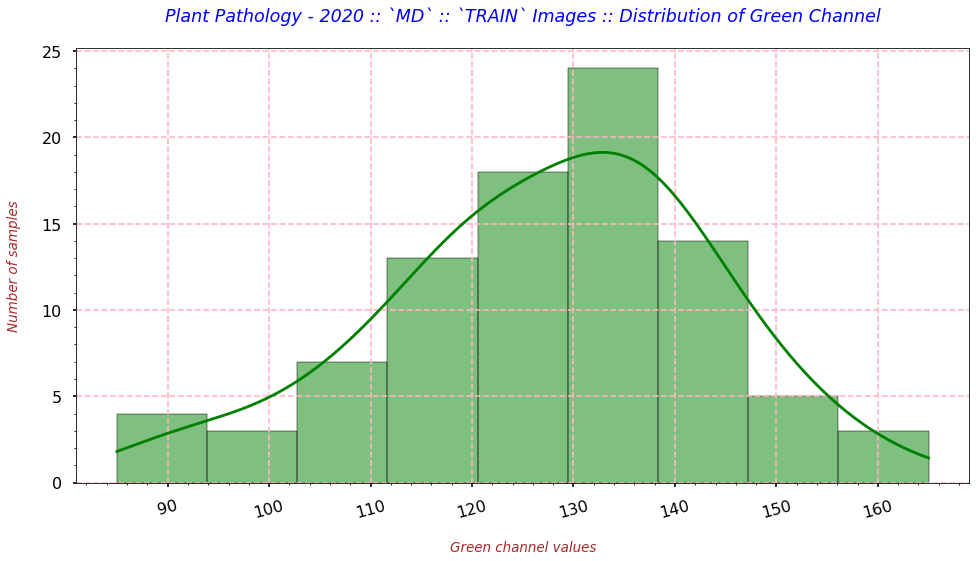

In [149]:
# MIN, MAX, MEAN & MEDIAN of a channel
print("###  {}  ::  {} channel  ###  \n  MIN --> {}  \n  MAX --> {}  \n  MEAN --> {}  \
\n  MEDIAN --> {}\n  RANGE --> {}\n".format("ALL Images",
                                            "GREEN", 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Green'].min(), 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Green'].max(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Green'].mean(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Green'].median(),
                                            (train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Green'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Green'].min())))

# Visualizing only GREEN channel
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Green'], kde=True, color='green', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nGreen channel values", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `MD` :: `TRAIN` Images :: Distribution of Green Channel\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of GREEN channel values for only TRAIN images.
    - It looks like a normal distribution curve with very slightly negatively skewed, which tells us that the average value of it is also on a higher side.
    - There are very few images with very less & very high value of GREEN.
    - And, majority of the images have the values b/w [115 - 145].

###  ALL Images  ::  BLUE channel  ###  
  MIN --> 27.0  
  MAX --> 105.0  
  MEAN --> 65.0989010989011  
  MEDIAN --> 62.0
  RANGE --> 78.0



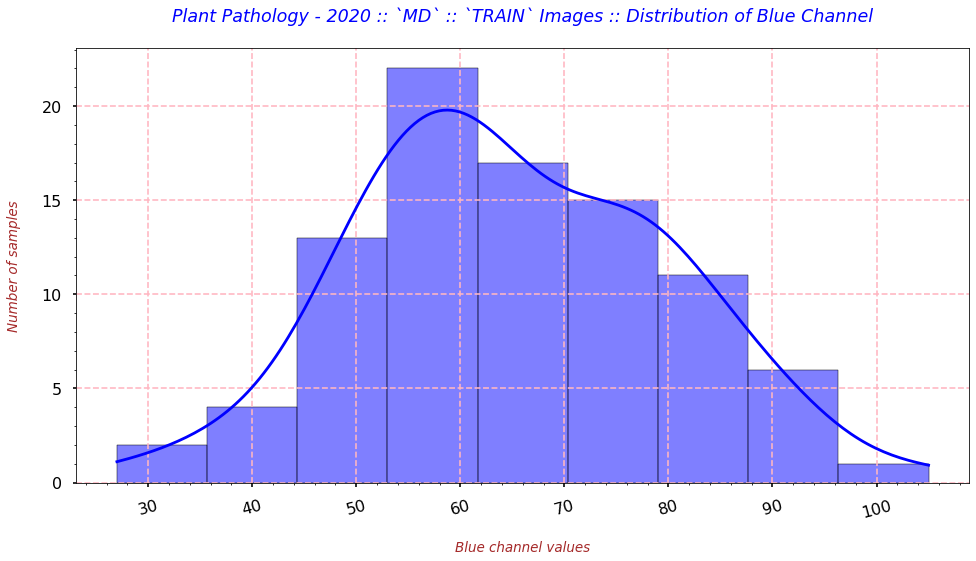

In [150]:
# MIN, MAX, MEAN & MEDIAN of a channel
print("###  {}  ::  {} channel  ###  \n  MIN --> {}  \n  MAX --> {}  \n  MEAN --> {}  \
\n  MEDIAN --> {}\n  RANGE --> {}\n".format("ALL Images",
                                            "BLUE", 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Blue'].min(), 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Blue'].max(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Blue'].mean(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Blue'].median(),
                                            (train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Blue'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Blue'].min())))

# Visualizing only BLUE channel
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Blue'], kde=True, color='blue', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nBlue channel values", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `MD` :: `TRAIN` Images :: Distribution of Blue Channel\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of BLUE channel values for only TRAIN images.
    - The curve is having 2 peaks; it means that two values 60 and 75 are more prominent in this channel.
    - And, majority of the images have the values b/w [50 - 85].

In [151]:
# Displaying the statistics related to every channel
## MIN, MAX, MEAN & MEDIAN of RGB channels of only MD :: TRAIN images
cols = ['MIN', 'MAX', 'MEAN', 'MEDIAN', "RANGE", "STDDEV"]

tr_img_red_sts2 = pd.DataFrame([train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Red'].min(),
                                train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Red'].max(), 
                                np.round(train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Red'].mean(),1), 
                                train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Red'].median(),
                                (train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Red'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Red'].min()),
                                np.std(train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Red'])]).T
tr_img_red_sts2.columns = cols

tr_img_green_sts2 = pd.DataFrame([train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Green'].min(), 
                                 train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Green'].max(), 
                                  np.round(train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Green'].mean(),1), 
                                 train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Green'].median(),
                                 (train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Green'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Green'].min()),
                                 np.std(train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Green'])]).T
tr_img_green_sts2.columns = cols

tr_img_blue_sts2 = pd.DataFrame([train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Blue'].min(), 
                                train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Blue'].max(), 
                                 np.round(train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Blue'].mean(),1), 
                                train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Blue'].median(),
                                (train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Blue'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Blue'].min()),
                                np.std(train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Blue'])]).T
tr_img_blue_sts2.columns = cols

tr_img_rgb_sts2 = pd.concat([tr_img_red_sts2, tr_img_green_sts2, tr_img_blue_sts2], axis=0)
tr_img_rgb_sts2.index = ["RED", "GREEN", "BLUE"]
tr_img_rgb_sts2

,MIN,MAX,MEAN,MEDIAN,RANGE,STDDEV
RED,47.0,127.0,92.9,93.0,80.0,15.719418
GREEN,85.0,165.0,127.4,130.0,80.0,16.196058
BLUE,27.0,105.0,65.1,62.0,78.0,14.841326


**`OBSERVATION`**

- From the above table, we deduce that:
    - The GREEN channel has the value on a higher side as compared to the other channels.
        - Its MIN and MAX both are greater than the other channels.
    - The BLUE channel has the value on a lower side as compared to the other channels.
        - Its MIN and MAX both are smaller than the other channels. Also, the range of values is smaller than the others.
    - The difference b/w MEAN and MEDIAN of all the 3 channels is not much wider.
    - The average value of a channel is maximum for GREEN and minimum for the BLUE.
    - Also, the STDDEV of all the 3 channels is close to each other.

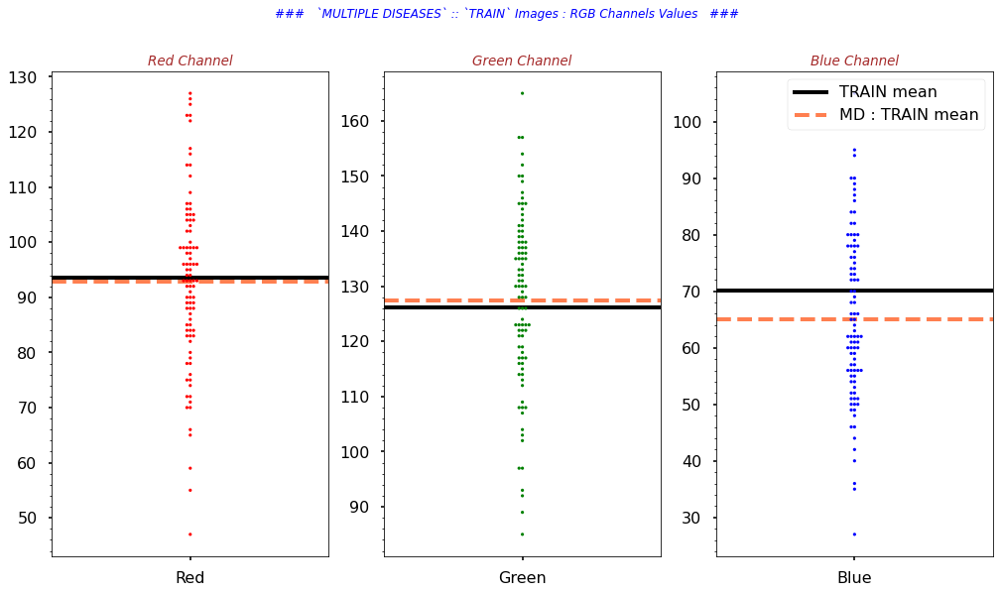

In [152]:
# Visualizing distribution of RGB channels of MULTIPLE DISEASE :: TRAIN Images
with plt.style.context('seaborn-poster'):
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(17,9), sharex=False, sharey=False)
        # Plotting the RED Channel
        sns.swarmplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1][['Red']], color='red', size=3.2, ax=ax[0])
        ax[0].axhline(y=train_img_chnl_data_tgts['Red'].mean(), color='black', linewidth=4, label='TRAIN mean')
        ax[0].axhline(y=train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Red'].mean(), color='coral', linestyle="--", 
                      linewidth=4, label='MD : TRAIN mean')
        ax[0].set_title("Red Channel", fontdict= label_font_dict)
        ax[0].minorticks_on()
        
        # Plotting the Green Channel
        sns.swarmplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1][['Green']], color='green', size=3.2, ax=ax[1])
        ax[1].axhline(y=train_img_chnl_data_tgts['Green'].mean(), color='black', linewidth=4, label='TRAIN mean')
        ax[1].axhline(y=train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Green'].mean(), color='coral', linestyle="--", 
                      linewidth=4, label='MD : TRAIN mean')
        ax[1].set_title("Green Channel", fontdict= label_font_dict)
        ax[1].minorticks_on()
        
        # Plotting the Blue Channel
        sns.swarmplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1][['Blue']], color='blue', size=3.2, ax=ax[2])
        ax[2].axhline(y=train_img_chnl_data_tgts['Blue'].mean(), color='black', linewidth=4, label='TRAIN mean')
        ax[2].axhline(y=train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1]['Blue'].mean(), color='coral', linestyle="--",  
                      linewidth=4, label='MD : TRAIN mean')
        ax[2].set_title("Blue Channel", fontdict= label_font_dict)
        ax[2].minorticks_on()
        
        fig.suptitle("###   `MULTIPLE DISEASES` :: `TRAIN` Images : RGB Channels Values   ###", fontdict=title_font_dict)
        plt.legend(loc='upper right')

**`OBSERVATION`**

- The above plot is showing us the how RGB channels values exist in the images.
    - Here, we found that the average values of RED & GREEN channel in MD TRAIN images is approx same.
    - Whereas, average values of BLUE channel in MD TRAIN images is less than the overall TRAIN images average.

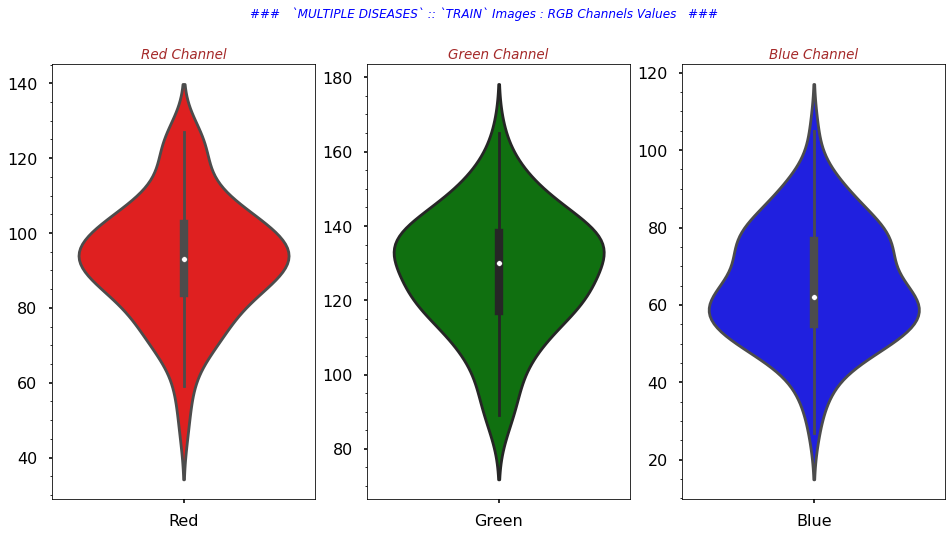

In [218]:
# Visualizing distribution of RGB channels of MULTIPLE DISEASE :: TRAIN Images
with plt.style.context('seaborn-poster'):
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16,8), sharex=False, sharey=False)
        # Plotting the RED Channel
        sns.violinplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1][['Red']], color='red', size=3.2, ax=ax[0])
        ax[0].set_title("Red Channel", fontdict= label_font_dict)
        ax[0].minorticks_on()
        
        # Plotting the Green Channel
        sns.violinplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1][['Green']], color='green', size=3.2, ax=ax[1])
        ax[1].set_title("Green Channel", fontdict= label_font_dict)
        ax[1].minorticks_on()
        
        # Plotting the Blue Channel
        sns.violinplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1][['Blue']], color='blue', size=3.2, ax=ax[2])
        ax[2].set_title("Blue Channel", fontdict= label_font_dict)
        ax[2].minorticks_on()
        
        fig.suptitle("###   `MULTIPLE DISEASES` :: `TRAIN` Images : RGB Channels Values   ###", fontdict=title_font_dict)

**`OBSERVATION`**

- The above plot is showing us the how RGB channels values exist in the images.
    - This again tells us that the peak of BLUE channel is dual peaked.
    - And, there are very few images with the extreme values.
    - And, majority of the images for RED and GREEN channel have values closer to the mean.

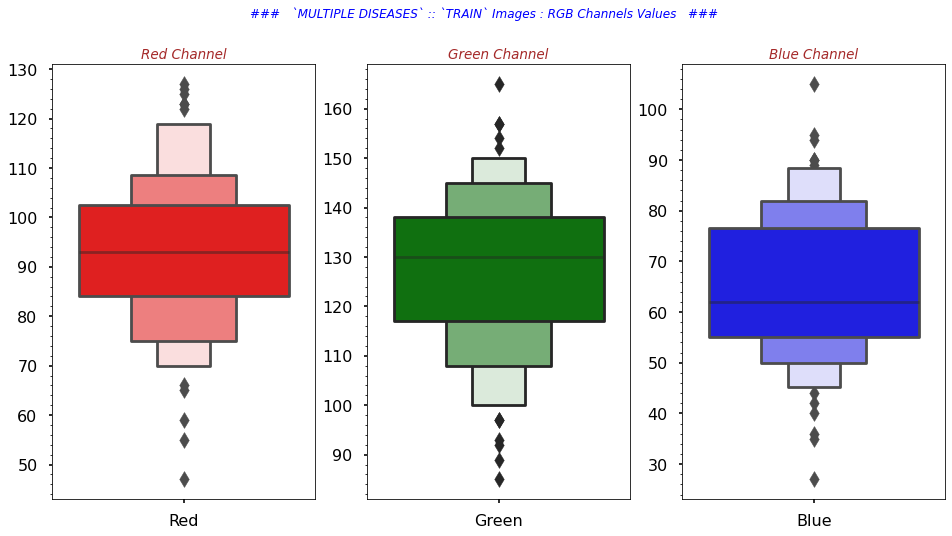

In [219]:
# Visualizing distribution of RGB channels of MULTIPLE DISEASE :: TRAIN Images
with plt.style.context('seaborn-poster'):
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16,8), sharex=False, sharey=False)
        # Plotting the RED Channel
        sns.boxenplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1][['Red']], color='red', ax=ax[0])
        ax[0].set_title("Red Channel", fontdict= label_font_dict)
        ax[0].minorticks_on()
        
        # Plotting the Green Channel
        sns.boxenplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1][['Green']], color='green', ax=ax[1])
        ax[1].set_title("Green Channel", fontdict= label_font_dict)
        ax[1].minorticks_on()
        
        # Plotting the Blue Channel
        sns.boxenplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['multiple_diseases'] == 1][['Blue']], color='blue', ax=ax[2])
        ax[2].set_title("Blue Channel", fontdict= label_font_dict)
        ax[2].minorticks_on()
        
        fig.suptitle("###   `MULTIPLE DISEASES` :: `TRAIN` Images : RGB Channels Values   ###", fontdict=title_font_dict)

**`OBSERVATION`**

- The above plot is showing us the how RGB channels values exist in the images.
    - This again tells us that the peak of BLUE channel is dual peaked.
    - And, there are very few images with the extreme values.
    - And, majority of the images for RED and GREEN channel have values closer to the mean.

#### **📊`RUST DISEASES`  ::  `TRAIN Images`**

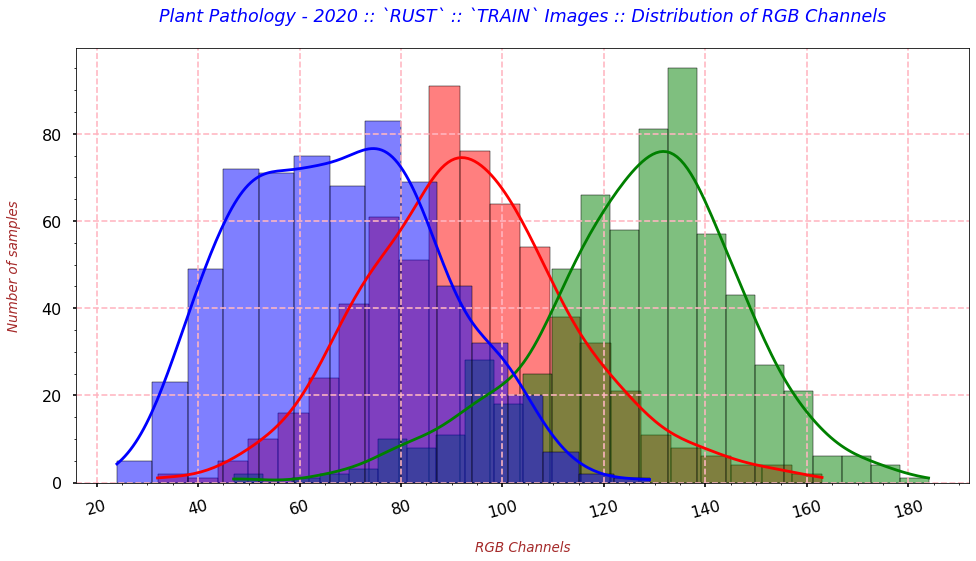

In [153]:
# Visualizing distribution of RGB channels of RUST :: TRAIN Images
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Red'], kde=True, color='red', legend=True)
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Green'], kde=True, color='green', legend=True)
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Blue'], kde=True, color='blue', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nRGB Channels", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `RUST` :: `TRAIN` Images :: Distribution of RGB Channels\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of RGB channel values for only TRAIN images.
    - This initial look indicates the RED & GREEN channels values looks like Normally Distributed.
        - And, for the GREEN channel we have some values greater than the other two channels. It also looks like having a normal curve.
    - Whereas, for the BLUE channel we can see the flat peak with a heavy right tail.

###  ALL Images  ::  RED channel  ###  
  MIN --> 32.0  
  MAX --> 163.0  
  MEAN --> 93.44855305466238  
  MEDIAN --> 92.0
  RANGE --> 131.0



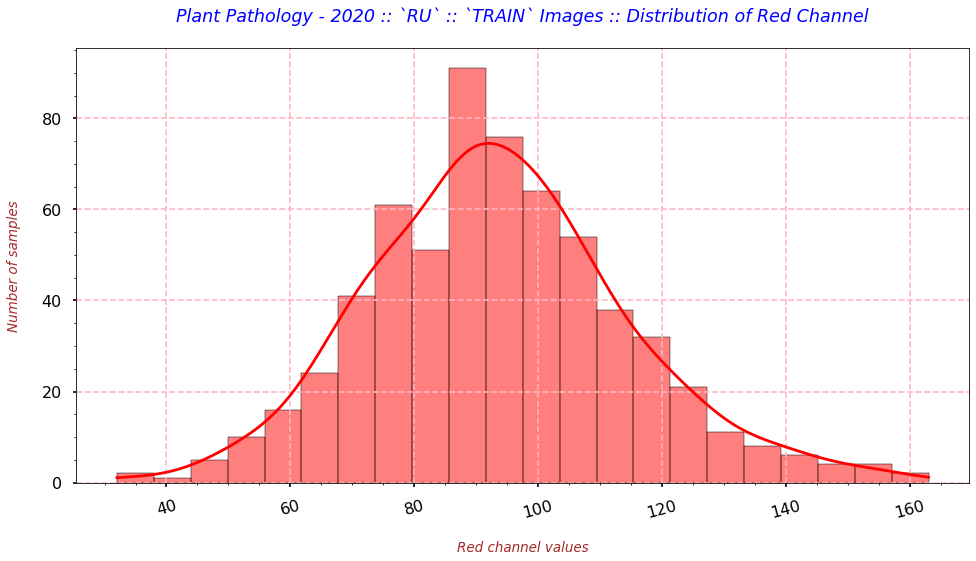

In [154]:
# MIN, MAX, MEAN & MEDIAN of a channel
print("###  {}  ::  {} channel  ###  \n  MIN --> {}  \n  MAX --> {}  \n  MEAN --> {}  \
\n  MEDIAN --> {}\n  RANGE --> {}\n".format("ALL Images",
                                            "RED", 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Red'].min(), 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Red'].max(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Red'].mean(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Red'].median(),
                                            (train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Red'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Red'].min())))

# Visualizing only RED channel
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Red'], kde=True, color='red', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nRed channel values", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `RU` :: `TRAIN` Images :: Distribution of Red Channel\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of RED channel values for only TRAIN images.
    - It looks like a normal distributed curve.
        - Majority of the images have the values b/w [70 - 110].

###  ALL Images  ::  GREEN channel  ###  
  MIN --> 47.0  
  MAX --> 184.0  
  MEAN --> 126.54019292604502  
  MEDIAN --> 128.0
  RANGE --> 137.0



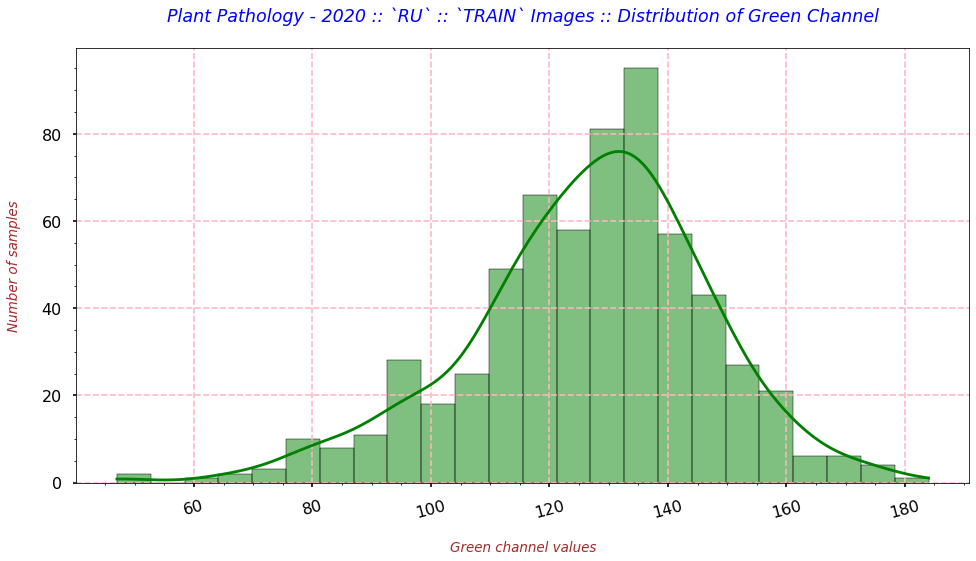

In [155]:
# MIN, MAX, MEAN & MEDIAN of a channel
print("###  {}  ::  {} channel  ###  \n  MIN --> {}  \n  MAX --> {}  \n  MEAN --> {}  \
\n  MEDIAN --> {}\n  RANGE --> {}\n".format("ALL Images",
                                            "GREEN", 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Green'].min(), 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Green'].max(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Green'].mean(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Green'].median(),
                                            (train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Green'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Green'].min())))

# Visualizing only GREEN channel
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Green'], kde=True, color='green', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nGreen channel values", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `RU` :: `TRAIN` Images :: Distribution of Green Channel\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of GREEN channel values for only TRAIN images.
    - It looks like a normal distribution curve with very slightly negatively skewed, which tells us that the average value of it is also on a higher side.
    - There are very few images with very less & very high value of GREEN.
    - And, majority of the images have the values b/w [115 - 150].

###  ALL Images  ::  BLUE channel  ###  
  MIN --> 24.0  
  MAX --> 129.0  
  MEAN --> 67.65434083601286  
  MEDIAN --> 67.0
  RANGE --> 105.0



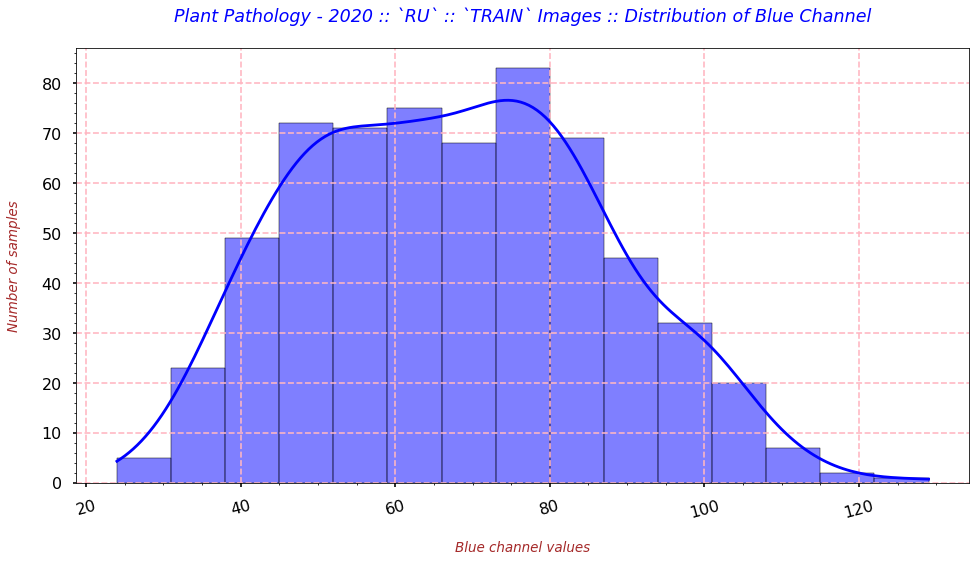

In [156]:
# MIN, MAX, MEAN & MEDIAN of a channel
print("###  {}  ::  {} channel  ###  \n  MIN --> {}  \n  MAX --> {}  \n  MEAN --> {}  \
\n  MEDIAN --> {}\n  RANGE --> {}\n".format("ALL Images",
                                            "BLUE", 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Blue'].min(), 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Blue'].max(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Blue'].mean(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Blue'].median(),
                                            (train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Blue'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Blue'].min())))

# Visualizing only BLUE channel
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Blue'], kde=True, color='blue', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nBlue channel values", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `RU` :: `TRAIN` Images :: Distribution of Blue Channel\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of BLUE channel values for only TRAIN images.
    - The curve is having flat peak.
        - And, majority of the images have the values b/w [40 - 90].

In [157]:
# Displaying the statistics related to every channel
## MIN, MAX, MEAN & MEDIAN of RGB channels of only MD :: TRAIN images
cols = ['MIN', 'MAX', 'MEAN', 'MEDIAN', "RANGE", "STDDEV"]

tr_img_red_sts3 = pd.DataFrame([train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Red'].min(),
                                train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Red'].max(), 
                                np.round(train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Red'].mean(),1), 
                                train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Red'].median(),
                                (train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Red'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Red'].min()),
                                np.std(train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Red'])]).T
tr_img_red_sts3.columns = cols

tr_img_green_sts3 = pd.DataFrame([train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Green'].min(), 
                                 train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Green'].max(), 
                                  np.round(train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Green'].mean(),1), 
                                 train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Green'].median(),
                                 (train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Green'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Green'].min()),
                                 np.std(train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Green'])]).T
tr_img_green_sts3.columns = cols

tr_img_blue_sts3 = pd.DataFrame([train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Blue'].min(), 
                                train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Blue'].max(), 
                                 np.round(train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Blue'].mean(),1), 
                                train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Blue'].median(),
                                (train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Blue'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Blue'].min()),
                                np.std(train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Blue'])]).T
tr_img_blue_sts3.columns = cols

tr_img_rgb_sts3 = pd.concat([tr_img_red_sts3, tr_img_green_sts3, tr_img_blue_sts3], axis=0)
tr_img_rgb_sts3.index = ["RED", "GREEN", "BLUE"]
tr_img_rgb_sts3

,MIN,MAX,MEAN,MEDIAN,RANGE,STDDEV
RED,32.0,163.0,93.4,92.0,131.0,20.812973
GREEN,47.0,184.0,126.5,128.0,137.0,20.436180
BLUE,24.0,129.0,67.7,67.0,105.0,19.283328


**`OBSERVATION`**

- From the above table, we deduce that:
    - The GREEN channel has the value on a higher side as compared to the other channels.
        - Its MIN and MAX both are greater than the other channels.
    - The BLUE channel has the value on a lower side as compared to the other channels.
        - Its MIN and MAX both are smaller than the other channels. Also, the range of values is smaller than the others.
    - The difference b/w MEAN and MEDIAN of all the 3 channels is not much wider.
    - The average value of a channel is maximum for GREEN and minimum for the BLUE.
    - Also, the STDDEV of all the 3 channels is close to each other.

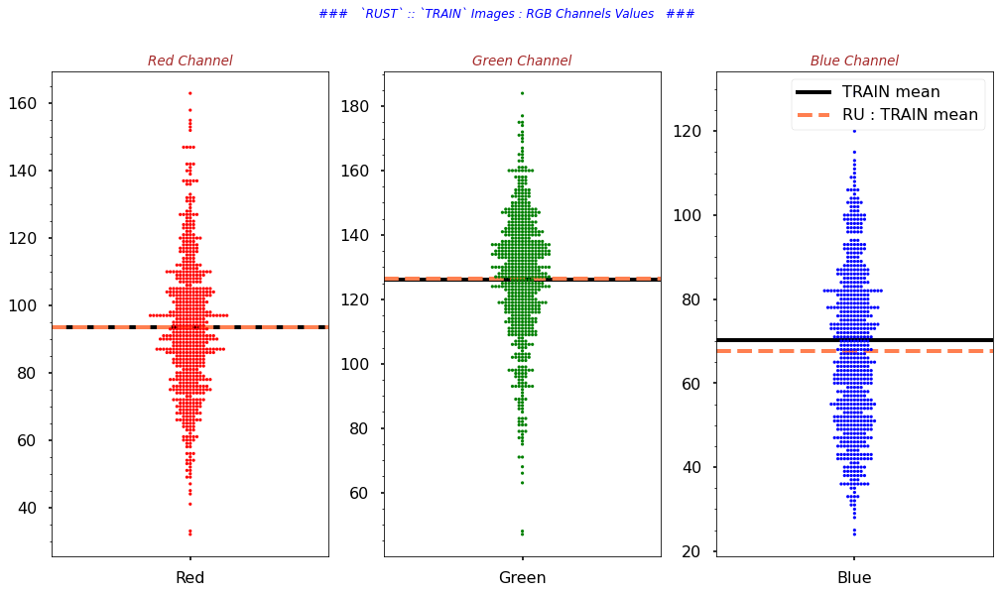

In [158]:
# Visualizing distribution of RGB channels of RUST :: TRAIN Images
with plt.style.context('seaborn-poster'):
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(17,9), sharex=False, sharey=False)
        # Plotting the RED Channel
        sns.swarmplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1][['Red']], color='red', size=3.2, ax=ax[0])
        ax[0].axhline(y=train_img_chnl_data_tgts['Red'].mean(), color='black', linewidth=4, label='TRAIN mean')
        ax[0].axhline(y=train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Red'].mean(), color='coral', linestyle="--", 
                      linewidth=4, label='RU : TRAIN mean')
        ax[0].set_title("Red Channel", fontdict= label_font_dict)
        ax[0].minorticks_on()
        
        # Plotting the Green Channel
        sns.swarmplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1][['Green']], color='green', size=3.2, ax=ax[1])
        ax[1].axhline(y=train_img_chnl_data_tgts['Green'].mean(), color='black', linewidth=4, label='TRAIN mean')
        ax[1].axhline(y=train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Green'].mean(), color='coral', linestyle="--", 
                      linewidth=4, label='RU : TRAIN mean')
        ax[1].set_title("Green Channel", fontdict= label_font_dict)
        ax[1].minorticks_on()
        
        # Plotting the Blue Channel
        sns.swarmplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1][['Blue']], color='blue', size=3.2, ax=ax[2])
        ax[2].axhline(y=train_img_chnl_data_tgts['Blue'].mean(), color='black', linewidth=4, label='TRAIN mean')
        ax[2].axhline(y=train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1]['Blue'].mean(), color='coral', linestyle="--",  
                      linewidth=4, label='RU : TRAIN mean')
        ax[2].set_title("Blue Channel", fontdict= label_font_dict)
        ax[2].minorticks_on()
        
        fig.suptitle("###   `RUST` :: `TRAIN` Images : RGB Channels Values   ###", fontdict=title_font_dict)
        plt.legend(loc='upper right')

**`OBSERVATION`**

- The above plot is showing us the how RGB channels values exist in the images.
    - Here, we found that the average values of RED & GREEN channel in RU TRAIN images is approx same.
    - Whereas, average values of BLUE channel in RU TRAIN images is less than the overall TRAIN images average.

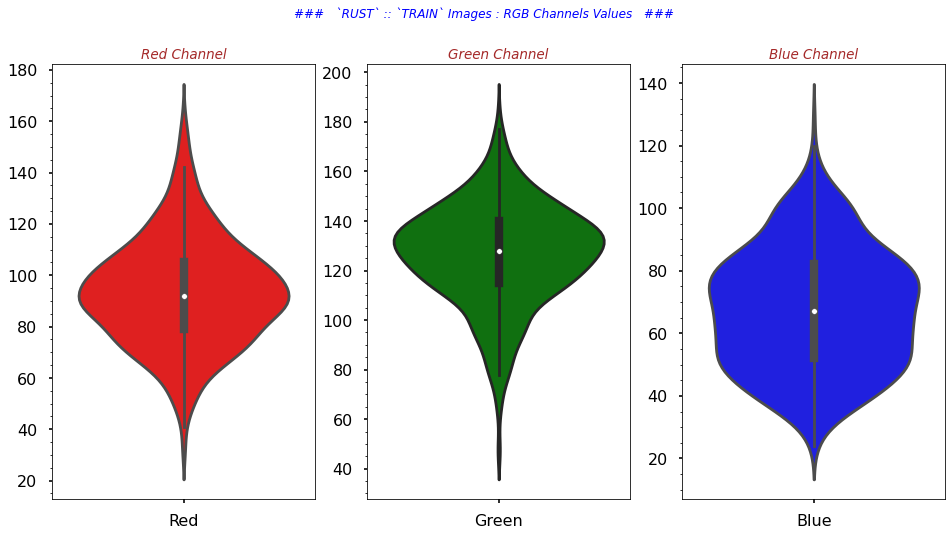

In [224]:
# Visualizing distribution of RGB channels of RUST :: TRAIN Images
with plt.style.context('seaborn-poster'):
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16,8), sharex=False, sharey=False)
        # Plotting the RED Channel
        sns.violinplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1][['Red']], color='red', size=3.2, ax=ax[0])
        ax[0].set_title("Red Channel", fontdict= label_font_dict)
        ax[0].minorticks_on()
        
        # Plotting the Green Channel
        sns.violinplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1][['Green']], color='green', size=3.2, ax=ax[1])
        ax[1].set_title("Green Channel", fontdict= label_font_dict)
        ax[1].minorticks_on()
        
        # Plotting the Blue Channel
        sns.violinplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1][['Blue']], color='blue', size=3.2, ax=ax[2])
        ax[2].set_title("Blue Channel", fontdict= label_font_dict)
        ax[2].minorticks_on()
        
        fig.suptitle("###   `RUST` :: `TRAIN` Images : RGB Channels Values   ###", fontdict=title_font_dict)

**`OBSERVATION`**

- The above plot is showing us the how RGB channels values exist in the images.
    - This again tells us that the peak of BLUE channel is dual peaked.
    - And, there are very few images with the extreme values.
    - And, majority of the images for RED and GREEN channel have values closer to the mean.

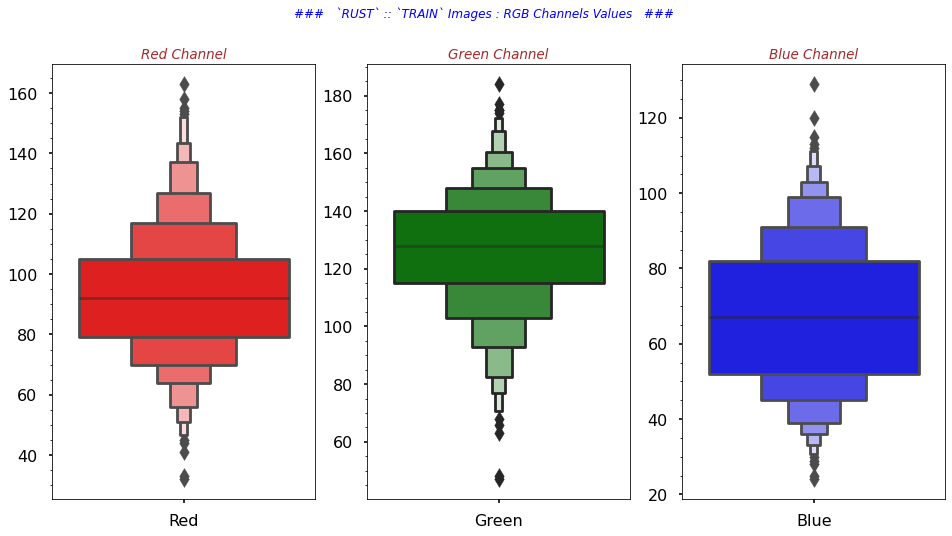

In [225]:
# Visualizing distribution of RGB channels of RUST :: TRAIN Images
with plt.style.context('seaborn-poster'):
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16,8), sharex=False, sharey=False)
        # Plotting the RED Channel
        sns.boxenplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1][['Red']], color='red', ax=ax[0])
        ax[0].set_title("Red Channel", fontdict= label_font_dict)
        ax[0].minorticks_on()
        
        # Plotting the Green Channel
        sns.boxenplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1][['Green']], color='green', ax=ax[1])
        ax[1].set_title("Green Channel", fontdict= label_font_dict)
        ax[1].minorticks_on()
        
        # Plotting the Blue Channel
        sns.boxenplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['rust'] == 1][['Blue']], color='blue', ax=ax[2])
        ax[2].set_title("Blue Channel", fontdict= label_font_dict)
        ax[2].minorticks_on()
        
        fig.suptitle("###   `RUST` :: `TRAIN` Images : RGB Channels Values   ###", fontdict=title_font_dict)

**`OBSERVATION`**

- The above plot is showing us the how RGB channels values exist in the images.
    - This again tells us that the peak of BLUE channel is dual peaked.
    - And, there are very few images with the extreme values.
    - And, majority of the images for RED and GREEN channel have values closer to the mean.

#### **📊`SCAB DISEASES`  ::  `TRAIN Images`**

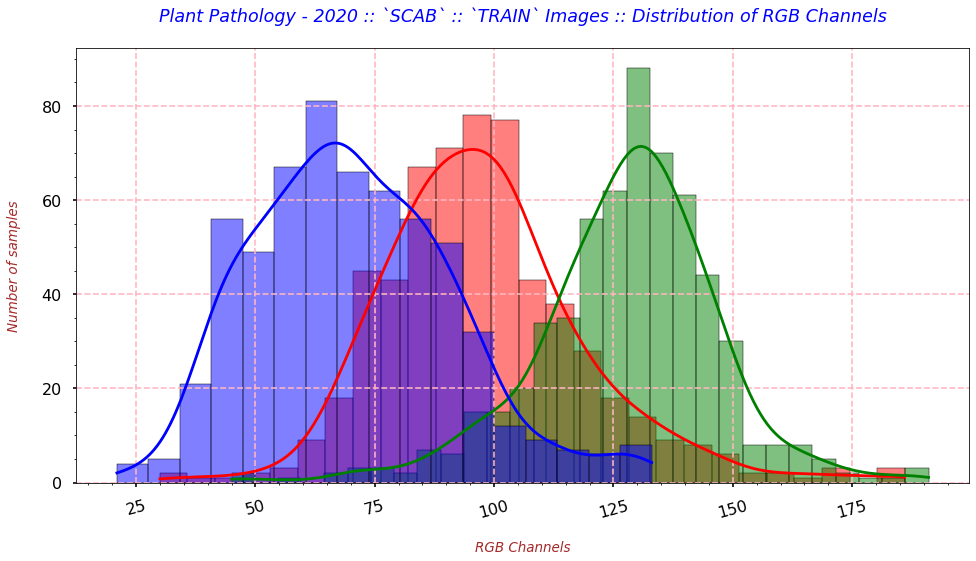

In [159]:
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Red'], kde=True, color='red', legend=True)
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Green'], kde=True, color='green', legend=True)
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Blue'], kde=True, color='blue', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nRGB Channels", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `SCAB` :: `TRAIN` Images :: Distribution of RGB Channels\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of RGB channel values for only TRAIN images.
    - This initial look indicates the RED, GREEN & BLUE channels values looks like Normally Distributed.
        - And, for the GREEN channel we have some values greater than the other two channels.

###  ALL Images  ::  RED channel  ###  
  MIN --> 30.0  
  MAX --> 186.0  
  MEAN --> 97.88851351351352  
  MEDIAN --> 96.0
  RANGE --> 156.0



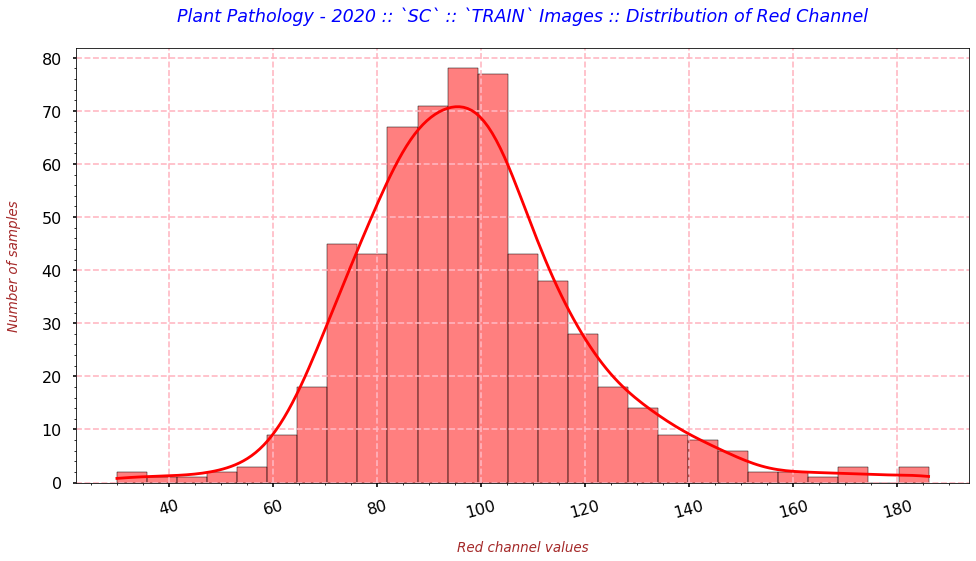

In [160]:
# MIN, MAX, MEAN & MEDIAN of a channel
print("###  {}  ::  {} channel  ###  \n  MIN --> {}  \n  MAX --> {}  \n  MEAN --> {}  \
\n  MEDIAN --> {}\n  RANGE --> {}\n".format("ALL Images",
                                            "RED", 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Red'].min(), 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Red'].max(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Red'].mean(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Red'].median(),
                                            (train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Red'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Red'].min())))

# Visualizing only RED channel
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Red'], kde=True, color='red', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nRed channel values", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `SC` :: `TRAIN` Images :: Distribution of Red Channel\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of RED channel values for only TRAIN images.
    - It looks like a normal distributed curve.
        - Majority of the images have the values b/w [75 - 115].

###  ALL Images  ::  GREEN channel  ###  
  MIN --> 45.0  
  MAX --> 191.0  
  MEAN --> 127.80236486486487  
  MEDIAN --> 129.0
  RANGE --> 146.0



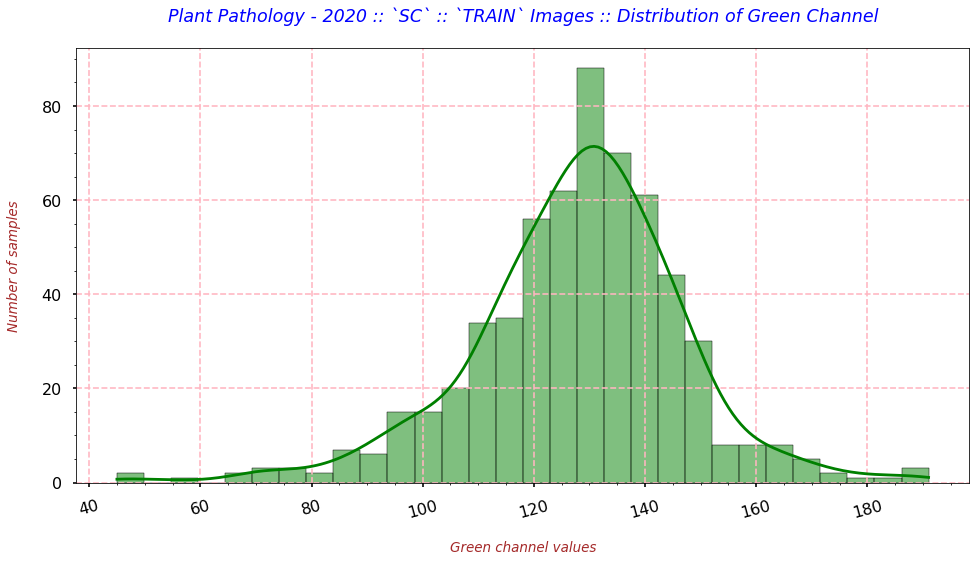

In [161]:
# MIN, MAX, MEAN & MEDIAN of a channel
print("###  {}  ::  {} channel  ###  \n  MIN --> {}  \n  MAX --> {}  \n  MEAN --> {}  \
\n  MEDIAN --> {}\n  RANGE --> {}\n".format("ALL Images",
                                            "GREEN", 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Green'].min(), 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Green'].max(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Green'].mean(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Green'].median(),
                                            (train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Green'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Green'].min())))

# Visualizing only GREEN channel
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Green'], kde=True, color='green', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nGreen channel values", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `SC` :: `TRAIN` Images :: Distribution of Green Channel\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of GREEN channel values for only TRAIN images.
    - It looks like a normal distribution curve with very slightly negatively skewed, which tells us that the average value of it is also on a higher side.
    - There are very few images with very less & very high value of GREEN.
    - And, majority of the images have the values b/w [115 - 150].

###  ALL Images  ::  BLUE channel  ###  
  MIN --> 21.0  
  MAX --> 133.0  
  MEAN --> 70.39358108108108  
  MEDIAN --> 69.0
  RANGE --> 112.0



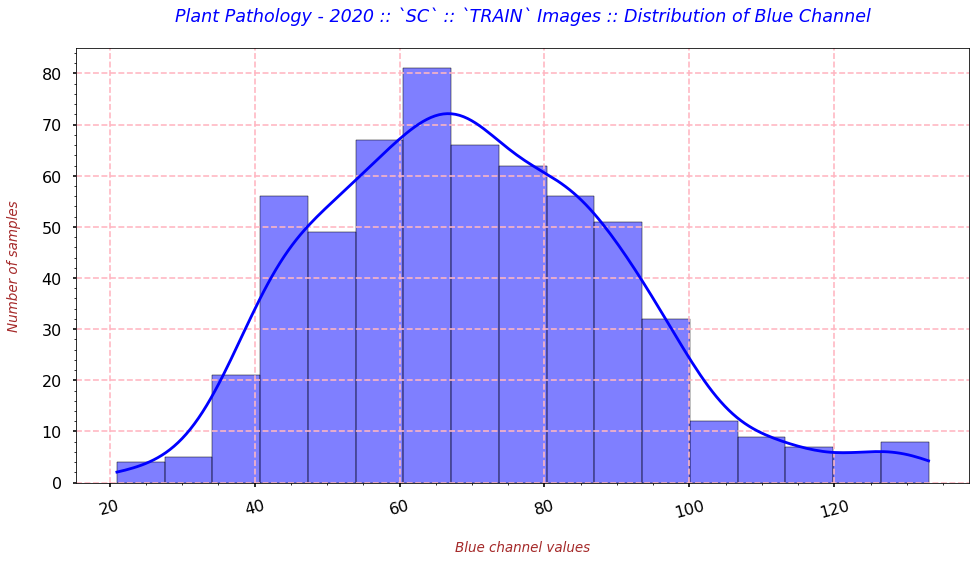

In [162]:
# MIN, MAX, MEAN & MEDIAN of a channel
print("###  {}  ::  {} channel  ###  \n  MIN --> {}  \n  MAX --> {}  \n  MEAN --> {}  \
\n  MEDIAN --> {}\n  RANGE --> {}\n".format("ALL Images",
                                            "BLUE", 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Blue'].min(), 
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Blue'].max(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Blue'].mean(),
                                            train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Blue'].median(),
                                            (train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Blue'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Blue'].min())))

# Visualizing only BLUE channel
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(16,8))
    sns.histplot(train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Blue'], kde=True, color='blue', legend=True)
    # Providing the labels and title to the graph
    plt.xlabel("\nBlue channel values", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("Number of samples\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("Plant Pathology - 2020 :: `SC` :: `TRAIN` Images :: Distribution of Blue Channel\n", fontdict=title_font_dict)

**`OBSERVATION`**

- The above graph shows us the distribution of BLUE channel values for only TRAIN images.
    - The curve can be referred as a normal bell curve with both of its sides are quite heavy.
        - And, majority of the images have the values b/w [40 - 90].

In [163]:
# Displaying the statistics related to every channel
## MIN, MAX, MEAN & MEDIAN of RGB channels of only MD :: TRAIN images
cols = ['MIN', 'MAX', 'MEAN', 'MEDIAN', "RANGE", "STDDEV"]

tr_img_red_sts4 = pd.DataFrame([train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Red'].min(),
                                train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Red'].max(), 
                                np.round(train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Red'].mean(),1), 
                                train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Red'].median(),
                                (train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Red'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Red'].min()),
                                np.std(train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Red'])]).T
tr_img_red_sts4.columns = cols

tr_img_green_sts4 = pd.DataFrame([train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Green'].min(), 
                                 train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Green'].max(), 
                                  np.round(train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Green'].mean(),1), 
                                 train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Green'].median(),
                                 (train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Green'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Green'].min()),
                                 np.std(train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Green'])]).T
tr_img_green_sts4.columns = cols

tr_img_blue_sts4 = pd.DataFrame([train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Blue'].min(), 
                                train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Blue'].max(), 
                                 np.round(train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Blue'].mean(),1), 
                                train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Blue'].median(),
                                (train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Blue'].max() - train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Blue'].min()),
                                np.std(train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Blue'])]).T
tr_img_blue_sts4.columns = cols

tr_img_rgb_sts4 = pd.concat([tr_img_red_sts4, tr_img_green_sts4, tr_img_blue_sts4], axis=0)
tr_img_rgb_sts4.index = ["RED", "GREEN", "BLUE"]
tr_img_rgb_sts4

,MIN,MAX,MEAN,MEDIAN,RANGE,STDDEV
RED,30.0,186.0,97.9,96.0,156.0,21.392276
GREEN,45.0,191.0,127.8,129.0,146.0,19.056720
BLUE,21.0,133.0,70.4,69.0,112.0,20.655610


**`OBSERVATION`**

- From the above table, we deduce that:
    - The GREEN channel has the value on a higher side as compared to the other channels.
        - Its MIN and MAX both are greater than the other channels.
    - The BLUE channel has the value on a lower side as compared to the other channels.
        - Its MIN and MAX both are smaller than the other channels. Also, the range of values is smaller than the others.
    - The difference b/w MEAN and MEDIAN of all the 3 channels is not much wider.
    - The average value of a channel is maximum for GREEN and minimum for the BLUE.
    - Also, the STDDEV of all the 3 channels is close to each other.

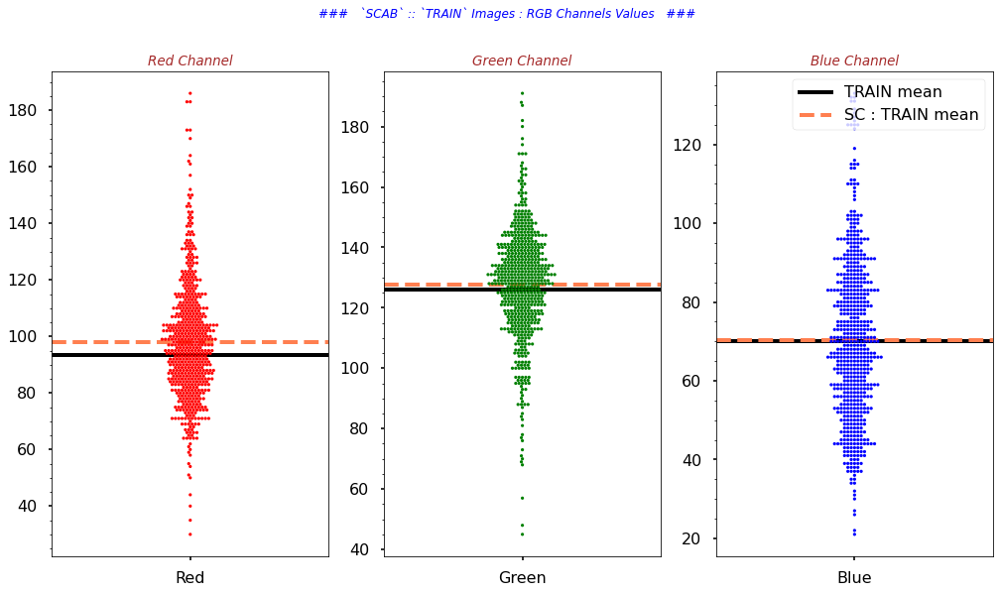

In [164]:
# Visualizing distribution of RGB channels of SCAB :: TRAIN Images
with plt.style.context('seaborn-poster'):
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(17,9), sharex=False, sharey=False)
        # Plotting the RED Channel
        sns.swarmplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1][['Red']], color='red', size=3.2, ax=ax[0])
        ax[0].axhline(y=train_img_chnl_data_tgts['Red'].mean(), color='black', linewidth=4, label='TRAIN mean')
        ax[0].axhline(y=train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Red'].mean(), color='coral', linestyle="--", 
                      linewidth=4, label='SC : TRAIN mean')
        ax[0].set_title("Red Channel", fontdict= label_font_dict)
        ax[0].minorticks_on()
        
        # Plotting the Green Channel
        sns.swarmplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1][['Green']], color='green', size=3.2, ax=ax[1])
        ax[1].axhline(y=train_img_chnl_data_tgts['Green'].mean(), color='black', linewidth=4, label='TRAIN mean')
        ax[1].axhline(y=train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Green'].mean(), color='coral', linestyle="--", 
                      linewidth=4, label='SC : TRAIN mean')
        ax[1].set_title("Green Channel", fontdict= label_font_dict)
        ax[1].minorticks_on()
        
        # Plotting the Blue Channel
        sns.swarmplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1][['Blue']], color='blue', size=3.2, ax=ax[2])
        ax[2].axhline(y=train_img_chnl_data_tgts['Blue'].mean(), color='black', linewidth=4, label='TRAIN mean')
        ax[2].axhline(y=train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1]['Blue'].mean(), color='coral', linestyle="--",  
                      linewidth=4, label='SC : TRAIN mean')
        ax[2].set_title("Blue Channel", fontdict= label_font_dict)
        ax[2].minorticks_on()
        
        fig.suptitle("###   `SCAB` :: `TRAIN` Images : RGB Channels Values   ###", fontdict=title_font_dict)
        plt.legend(loc='upper right')

**`OBSERVATION`**

- The above plot is showing us the how RGB channels values exist in the images.
    - Here, we found that the average values of GREEN & BLUE channel in SC TRAIN images is approx same.
    - Whereas, average values of RED channel in SC TRAIN images is more than the overall TRAIN images average.

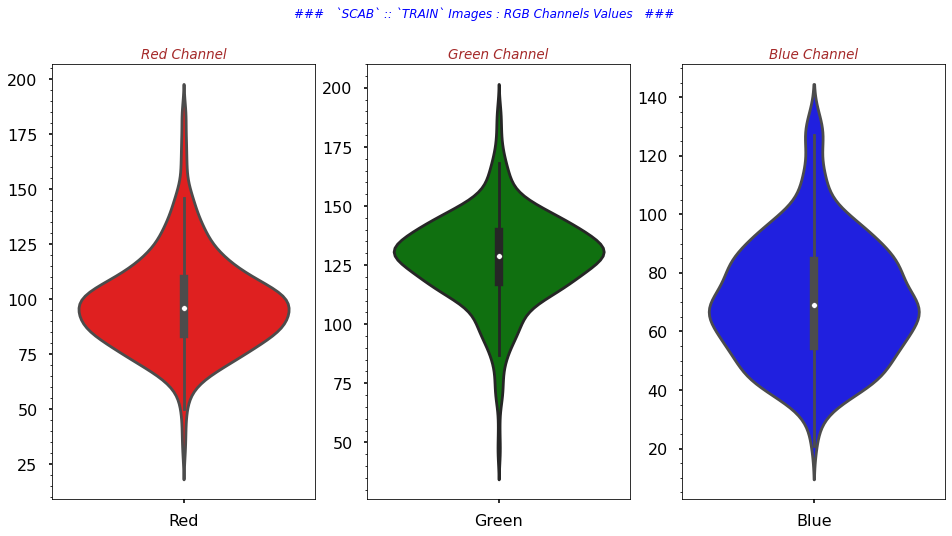

In [165]:
# Visualizing distribution of RGB channels of SCAB :: TRAIN Images
with plt.style.context('seaborn-poster'):
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16,8), sharex=False, sharey=False)
        # Plotting the RED Channel
        sns.violinplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1][['Red']], color='red', size=3.2, ax=ax[0])
        ax[0].set_title("Red Channel", fontdict= label_font_dict)
        ax[0].minorticks_on()
        
        # Plotting the Green Channel
        sns.violinplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1][['Green']], color='green', size=3.2, ax=ax[1])
        ax[1].set_title("Green Channel", fontdict= label_font_dict)
        ax[1].minorticks_on()
        
        # Plotting the Blue Channel
        sns.violinplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1][['Blue']], color='blue', size=3.2, ax=ax[2])
        ax[2].set_title("Blue Channel", fontdict= label_font_dict)
        ax[2].minorticks_on()
        
        fig.suptitle("###   `SCAB` :: `TRAIN` Images : RGB Channels Values   ###", fontdict=title_font_dict)

**`OBSERVATION`**

- The above plot is showing us the how RGB channels values exist in the images.
    - This again tells us that the peak of BLUE channel with flat peak and heavy sides.
    - And, there are very few images with the extreme values.
    - And, majority of the images for RED and GREEN channel have values closer to the mean.

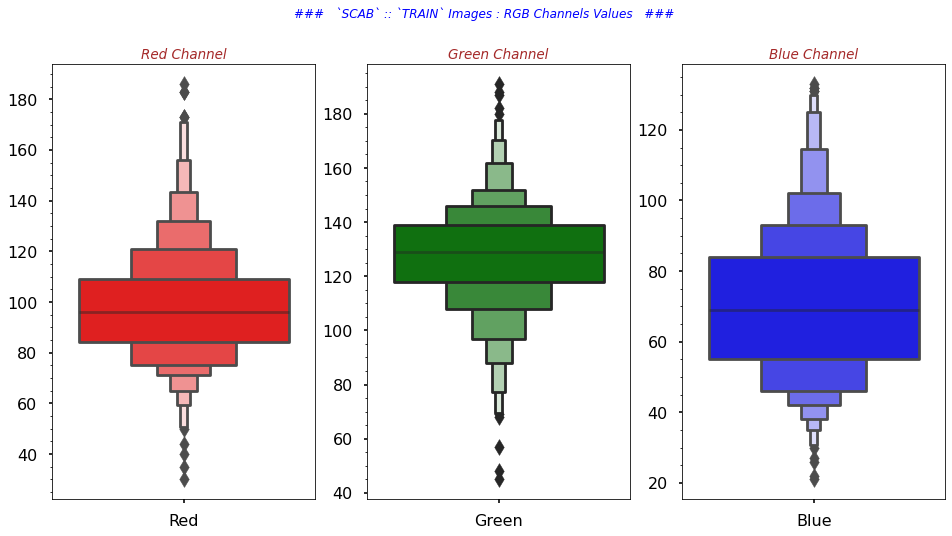

In [166]:
# Visualizing distribution of RGB channels of SCAB :: TRAIN Images
with plt.style.context('seaborn-poster'):
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16,8), sharex=False, sharey=False)
        # Plotting the RED Channel
        sns.boxenplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1][['Red']], color='red', ax=ax[0])
        ax[0].set_title("Red Channel", fontdict= label_font_dict)
        ax[0].minorticks_on()
        
        # Plotting the Green Channel
        sns.boxenplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1][['Green']], color='green', ax=ax[1])
        ax[1].set_title("Green Channel", fontdict= label_font_dict)
        ax[1].minorticks_on()
        
        # Plotting the Blue Channel
        sns.boxenplot(data=train_img_chnl_data_tgts[train_img_chnl_data_tgts['scab'] == 1][['Blue']], color='blue', ax=ax[2])
        ax[2].set_title("Blue Channel", fontdict= label_font_dict)
        ax[2].minorticks_on()
        
        fig.suptitle("###   `SCAB` :: `TRAIN` Images : RGB Channels Values   ###", fontdict=title_font_dict)

**`OBSERVATION`**

- The above plot is showing us the how RGB channels values exist in the images.
    - This again tells us that the peak of BLUE channel having flat peak.
    - And, there are very few images with the extreme values.
    - And, majority of the images for RED and GREEN channel have values closer to the mean.

In [175]:
rgb_stats = pd.concat([all_img_rgb_sts, tr_img_rgb_sts, tr_img_rgb_sts2, tr_img_rgb_sts3, tr_img_rgb_sts4], axis=0)
rgb_stats['Category'] = ['ALL_Images', 'ALL_Images', 'ALL_Images', 'TR_HL', 'TR_HL', 'TR_HL', 'TR_MD', 'TR_MD', 'TR_MD',
                         'TR_RU', 'TR_RU', 'TR_RU', 'TR_SC', 'TR_SC', 'TR_SC']
rgb_stats.reset_index(drop=False, inplace=True)
rgb_stats.rename(columns={'index':'Channel'}, inplace=True)
rgb_stats

,Channel,MIN,MAX,MEAN,MEDIAN,RANGE,STDDEV,Category
0,RED,29.0,186.0,94.5,93.5,157.0,20.558549,ALL_Images
1,GREEN,42.0,198.0,126.9,128.0,156.0,19.913054,ALL_Images
2,BLUE,15.0,143.0,73.2,72.0,128.0,21.466170,ALL_Images
3,RED,29.0,160.0,89.0,87.0,131.0,20.992744,TR_HL
4,GREEN,51.0,183.0,123.3,124.0,132.0,19.693353,TR_HL
5,BLUE,26.0,138.0,73.9,71.0,112.0,22.037715,TR_HL
6,RED,47.0,127.0,92.9,93.0,80.0,15.719418,TR_MD
7,GREEN,85.0,165.0,127.4,130.0,80.0,16.196058,TR_MD
8,BLUE,27.0,105.0,65.1,62.0,78.0,14.841326,TR_MD
9,RED,32.0,163.0,93.4,92.0,131.0,20.812973,TR_RU


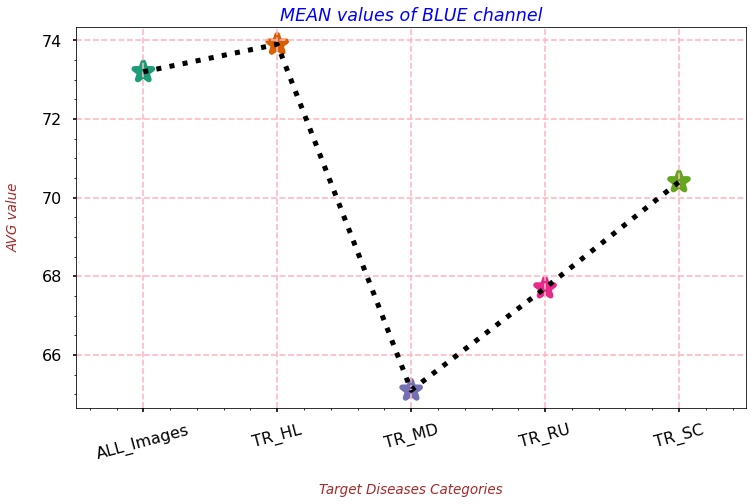

In [230]:
# Visualizing MEAN values of a channel across all categories
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(12,7))
    sns.pointplot(data=rgb_stats[rgb_stats['Channel'] == 'BLUE'][['MEAN','Category']], x='Category', y='MEAN', color='k', markers="",
                 linestyles=":")
    sns.pointplot(data=rgb_stats[rgb_stats['Channel'] == 'BLUE'][['MEAN','Category']], x='Category', y='MEAN', palette='Dark2', scale=1.5,
                  markers="*")
    # Providing the labels and title to the graph
    plt.xlabel("\nTarget Diseases Categories", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("AVG value\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("MEAN values of BLUE channel", fontdict=title_font_dict)

**`OBSERVATION`**

- The above plot tells us that the AVG value of BLUE channel in TRAIN MULTIPLE DISEASES images is less than the others.

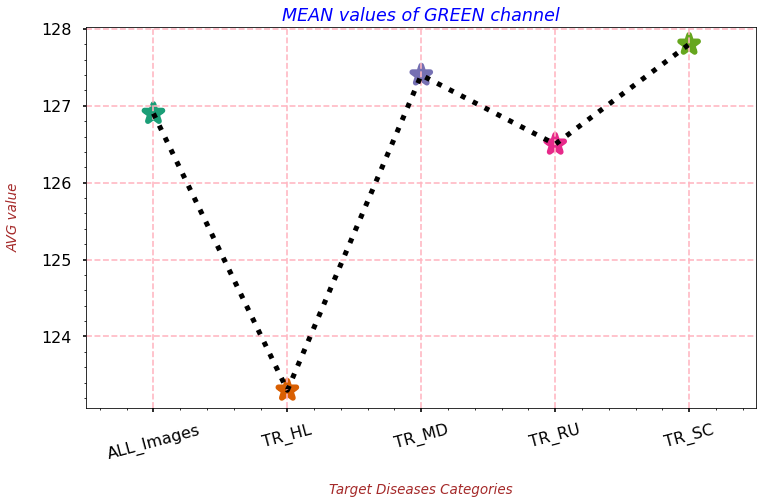

In [231]:
# Visualizing MEAN values of a channel across all categories
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(12,7))
    sns.pointplot(data=rgb_stats[rgb_stats['Channel'] == 'GREEN'][['MEAN','Category']], x='Category', y='MEAN', color='black', markers="",
                 linestyles=":")
    sns.pointplot(data=rgb_stats[rgb_stats['Channel'] == 'GREEN'][['MEAN','Category']], x='Category', y='MEAN', palette='Dark2',
                  scale=1.5, markers="*")
    # Providing the labels and title to the graph
    plt.xlabel("\nTarget Diseases Categories", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("AVG value\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("MEAN values of GREEN channel", fontdict=title_font_dict)

**`OBSERVATION`**

- The above plot tells us that the AVG value of GREEN channel in TRAIN HEALTHY images is less than the others.

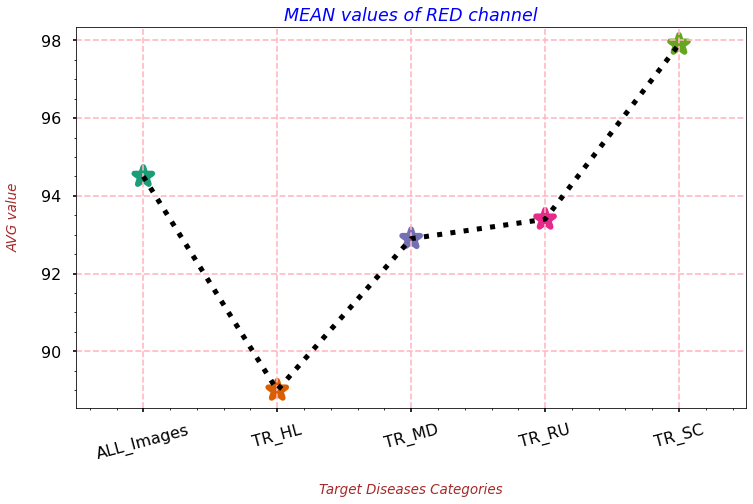

In [232]:
# Visualizing MEAN values of a channel across all categories
with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(12,7))
    sns.pointplot(data=rgb_stats[rgb_stats['Channel'] == 'RED'][['MEAN','Category']], x='Category', y='MEAN', color='black', markers="",
                 linestyles=":")
    sns.pointplot(data=rgb_stats[rgb_stats['Channel'] == 'RED'][['MEAN','Category']], x='Category', y='MEAN', palette='Dark2',
                  scale=1.5, markers="*")
    # Providing the labels and title to the graph
    plt.xlabel("\nTarget Diseases Categories", fontdict=label_font_dict)
    plt.xticks(rotation=15)
    plt.ylabel("AVG value\n", fontdict=label_font_dict)
    plt.minorticks_on()
    plt.grid(which='major', linestyle="--", color='lightpink')
    plt.title("MEAN values of RED channel", fontdict=title_font_dict)

**`OBSERVATION`**

- The above plot tells us that the AVG value of RED channel in TRAIN HEALTHY images is less than the others.
- And, significantly higher in TRAIN SCAB images.

#### ⭐ **`Pixel values change in intensity for infected portions`**

### **Q5.**
#### **Do we have any significant change in the intensities of the channels in infected images❓**

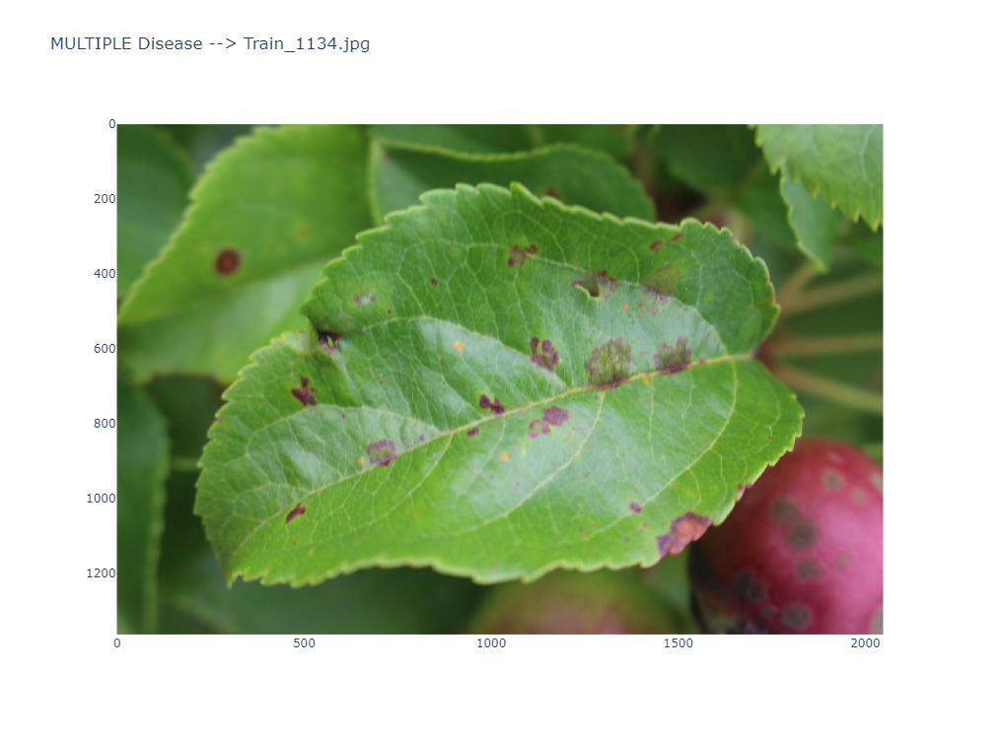

In [269]:
# MULTIPLE DISEASE image
md1_img = cv2.imread(os.path.join(all_images_loc,"Train_1134.jpg"))
md1_img = cv2.cvtColor(md1_img, cv2.COLOR_BGR2RGB)
px.imshow(md1_img, title="MULTIPLE Disease --> Train_1134.jpg", height=750, width=1100)

**`OBSERVATION`**

- Once we hover onto the image specially on the blackish spots then will find that the value of BLUE channel will be much higher.
- And, the value of the GREEN channel will be slightly less.
- Example below:

![MD_Img](E:\STUDY\PROJECTS\AAIC_Case_Study_2\Pixel_value_MD_img.png)

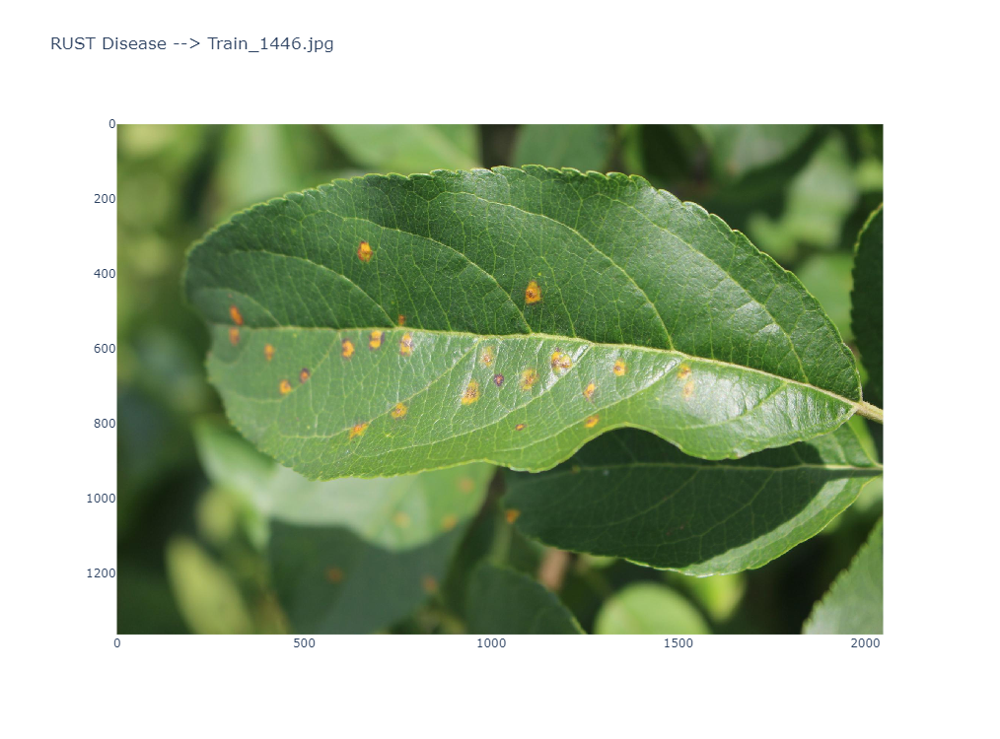

In [270]:
# RUST image
ru1_img = cv2.imread(os.path.join(all_images_loc,"Train_1446.jpg"))
ru1_img = cv2.cvtColor(ru1_img, cv2.COLOR_BGR2RGB)
px.imshow(ru1_img, title="RUST Disease --> Train_1446.jpg", height=750, width=1100)

**`OBSERVATION`**

- Once we hover onto the image specially on the yellowish spots then will find that the value of BLUE channel is very less.
- And, the value of the GREEN channel will be slightly on a lower side.
- And, the value of the RED channel will be on extreme higher side.
- Example below:

![RU_Img](E:\STUDY\PROJECTS\AAIC_Case_Study_2\Pixel_value_RUST_img.png)

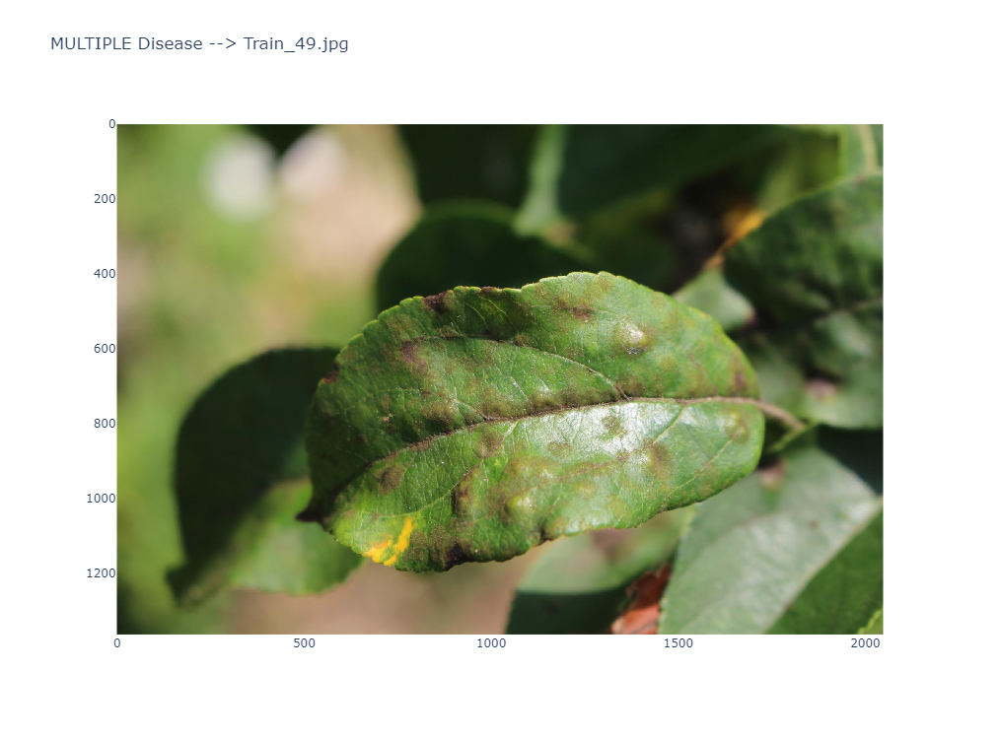

In [271]:
# SCAB image
sc1_img = cv2.imread(os.path.join(all_images_loc,"Train_49.jpg"))
sc1_img = cv2.cvtColor(sc1_img, cv2.COLOR_BGR2RGB)
px.imshow(sc1_img, title="MULTIPLE Disease --> Train_49.jpg", height=750, width=1100)

**`OBSERVATION`**

- Once we hover onto the image specially on the blakish spots then will find that the value of all the channels drop significantly and becomes very less.
- Example below:

![SC_Img](E:\STUDY\PROJECTS\AAIC_Case_Study_2\Pixel_value_SCAB_img.png)

## **`SUMMARY`**

- We found out that some of the images in the provided dataset are duplicates.
- We found that the relationship b/w the TGT Diseases Categories.
- We found the differences in the RGB channels distribution b/w the TGT Diseases Categories.
- We also found that the infected areas in the images have significant change in RGB intensities of a pixel for TGT Diseases Categories.